## Replicating Jelle's Work

Data comes prefiltered from filtering_data.ipynb

Filtering for distance between reconstruction algos might filter more wall events

Find Proper MC Map Text in Slack

Prepare proper ChiSQaured Statistic see drive & Stats BOok : Poisson x Binom x Gauss

Tidy up notebook before next meet -> Complete the notes 

In [1]:
# Utilix broken in this version tag -> Cancel cell after 2s then start again
import 
os.environ["XENON_CONFIG"] = '/Code/xenon.config'
import straxen

2024-11-16 09:50:03,103 - admix - WARNING - Initializing utilix DB failed. You cannot do database operations


DB initialization failed


In [2]:
# imports
import sys, os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import tensorflow
import scipy
import keras
import time
from IPython.display import clear_output
from functools import partial
import h5py
#import gc
#from numba import cuda 

import subprocess


# import functions
sys.path.append(os.path.join(os.getcwd(), 'ActualThesisWork'))
%load_ext autoreload
%autoreload 2
from functions import *


tensorflow.config.optimizer.set_jit(True)
# The below is neat when on but it prints over 1000 msg/s 
tensorflow.debugging.set_log_device_placement(False) 
tensorflow.config.set_visible_devices([], 'GPU') # Because It keeps running out of memory and doesnt remove the data

2024-11-16 09:50:03.989221: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-11-16 09:50:03.990878: I external/local_tsl/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-16 09:50:04.011501: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-16 09:50:04.011529: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-16 09:50:04.012092: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to

In [161]:
def get_filtered(path):
    with h5py.File(path, 'r') as f:
        patterns = f['patterns'][:]
        ei = f['event_info'][:]
        # run_ids = f["run_ids"][:]
        print("Total Livetime {}s".format(f.attrs["Livetime_tot_s"]))
        print("Total Datapoints pre filter {}".format(f.attrs["OriginalSize"]))
        print("Total Datapoints post filter {}".format(f.attrs["CurrentSize"]))
    assert len(patterns) == len(ei)
    return patterns, ei


filtered_path = '/Code/processed_data/SrCut_z20_0000.hdf5'

patterns, ei = get_filtered(filtered_path)
pmt_pos = straxen.pmt_positions()
pmt_pos_top = pmt_pos[pmt_pos.array == "top"].to_numpy()
n_pmts = pmt_pos_top.shape[0]
# Temporary filter
pmt_diam = straxen.tpc_pmt_radius
bool_map_datafilter = (((ei["s2_x_cnn"] - ei["s2_x_gcn"])**2 + (ei["s2_y_cnn"] - ei["s2_y_gcn"])**2)**(1/2) < pmt_diam)
bool_map_datafilter &= (((ei["s2_x_cnn"] - ei["s2_x_mlp"])**2 + (ei["s2_y_mlp"] - ei["s2_y_mlp"])**2)**(1/2) < pmt_diam)
bool_map_datafilter &= (((ei["s2_x_gcn"] - ei["s2_x_mlp"])**2 + (ei["s2_y_gcn"] - ei["s2_y_mlp"])**2)**(1/2) < pmt_diam)
patterns, ei = patterns[bool_map_datafilter], ei[bool_map_datafilter]

# Grab Relevant Data - We use all models data
patterns = patterns['s2_area_per_channel'][:, :n_pmts]
# To get tripplet set
#patterns = np.concatenate([patterns,patterns,patterns])
#positions = np.stack([np.concatenate([ei[i] for i in ('s2_x_cnn', 's2_x_gcn', 's2_x_mlp')]), np.concatenate([ei[i] for i in ('s2_y_cnn', 's2_y_gcn', 's2_y_mlp')])],axis = -1)
#positions = np.stack([ei['s2_x'], ei['s2_y']],axis = -1)
# Can also do flow model based
fname = '/Code/posrec_models_from_straxen/flow_20240730.tar.gz'
import tarfile 
def open_jax_model(model_path: str, **kwargs):
    # Copied directly from straxen including the two functions below (modified where required)
    # Nested import to reduce loading time of import straxen as it's not
    # a base requirement
    from jax import export

    # Check if the model file exists
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"No file at {model_path}")
    # Extract required parameters from kwargs
    n_poly = kwargs["n_poly"]
    sig = kwargs["sig"]

    # Open the tar file and extract the requested model
    with tarfile.open(model_path, "r") as f:
        names = f.getnames()

        # Construct the filename based on n_poly and sig
        filename = f"{int(n_poly):02d}_{float(sig) * 1000:3.0f}"

        # Check if the requested model exists in the tar file
        if filename not in names:
            raise ValueError("Requested model not in tarfile!")

        # Extract and read the serialized JAX object
        file_obj = f.extractfile(filename)
        assert file_obj is not None
        serialized_jax_object = file_obj.read()
    # Deserialize the JAX object and return its callable function
    return export.deserialize(serialized_jax_object).call
def vectorized_prediction_chunk(patterns, pred_function, N_chunk_max):
    N_entries = patterns.shape[0]
    if N_entries > N_chunk_max:
        raise ValueError("Chunk greater than max size")
    else:
        inputs = np.zeros((N_chunk_max, pmt_pos_top.shape[0]+1))
        inputs[:N_entries] = patterns
        xy, contour = pred_function(inputs)
        return xy[:N_entries], contour[:N_entries]
def prediction_loop(patterns, pred_function, N_chunk_max=4096):
    N_entries = patterns.shape[0]
    # If the number of entries is within the chunk limit, process in one step
    if N_entries <= N_chunk_max:
        xy, _ = vectorized_prediction_chunk(patterns, pred_function, N_chunk_max)
        return [xy]  # Return as a single-element list for consistency
    N_chunks = N_entries // N_chunk_max
    xy_list = []
    # Process chunks
    for i in range(N_chunks):
        xy, _ = vectorized_prediction_chunk(
            patterns[i * N_chunk_max : (i + 1) * N_chunk_max], pred_function, N_chunk_max
        )
        xy_list.append(xy)

    # Process remaining entries, if any
    if N_chunks * N_chunk_max < N_entries:
        xy, _ = vectorized_prediction_chunk(
            patterns[N_chunks * N_chunk_max :], pred_function, N_chunk_max
        )
        xy_list.append(xy)
    return np.concatenate(xy_list, axis=0)

flow_model = open_jax_model(fname, n_poly=32, sig=0.393)
log_area_scale = 10
# Prep data
with np.errstate(divide="ignore", invalid="ignore"):
    total_top_areas = patterns.sum(axis=1, keepdims=True)
    area_per_channel_top = patterns
    flow_data = np.concatenate(
        [
            area_per_channel_top / total_top_areas,  # Normalize areas per channel
            np.log(total_top_areas) / log_area_scale,  # Log-scale transformation
        ],
        axis=1,
    )

positions = prediction_loop(flow_data, flow_model)

print(positions.shape, patterns.shape)
# Turn to tensorflow objects
patterns = tensorflow.convert_to_tensor(patterns, dtype=tensorflow.float32)
positions = tensorflow.convert_to_tensor(positions, dtype=tensorflow.float32)
tensorflow.keras.backend.set_floatx('float32')

Total Livetime 235843.858s
Total Datapoints pre filter 1314844
Total Datapoints post filter 184657
(184562, 2) (184562, 253)


In [211]:
repr(not_dead_pmts.tolist())

'[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 157, 158, 159, 160, 161, 162, 163, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 22

In [34]:
# Get Remaining Global variables
dead_pmts =     np.argwhere(tensorflow.math.reduce_mean(patterns,axis=0) == 0).reshape(-1)
not_dead_pmts = np.argwhere(tensorflow.math.reduce_mean(patterns,axis=0) != 0).reshape(-1)
# Get val train split
n_datapoints = ei.shape[0]
np.random.seed(1111)
shuffle_i = np.arange(n_datapoints)
np.random.shuffle(shuffle_i)
train_end = int(n_datapoints * 0.8)
train_slice = shuffle_i[0:train_end]
val_slice = shuffle_i[train_end:]

pmt_radius = straxen.tpc_pmt_radius# 3  * 2.54 / 2 
tpc_radius = 66.4 # pm 0.2 -> https://xe1t-wiki.lngs.infn.it/doku.php?id=xenon:xenonnt:analysis:coordinate_system&s[]=perpendicular&s[]=wire&s[]=coordinates
max_z = straxen.tpc_z

allow_njit = True
keras_loss = logl_loss_generator(pmt_pos_top, keras.backend, not_dead_pmts = not_dead_pmts, cap=float('inf'), allow_njit=allow_njit)

# Compile the function
if allow_njit:
    keras_loss(np.random.random((1, n_pmts)),np.random.random((1, n_pmts)))

Fitted parameters:
I0 = 0.10919789878599326, a = -0.0001563343824944384, b = 0.0184482270318723, d = 12.37911875515411, p = 2.1849154858580113


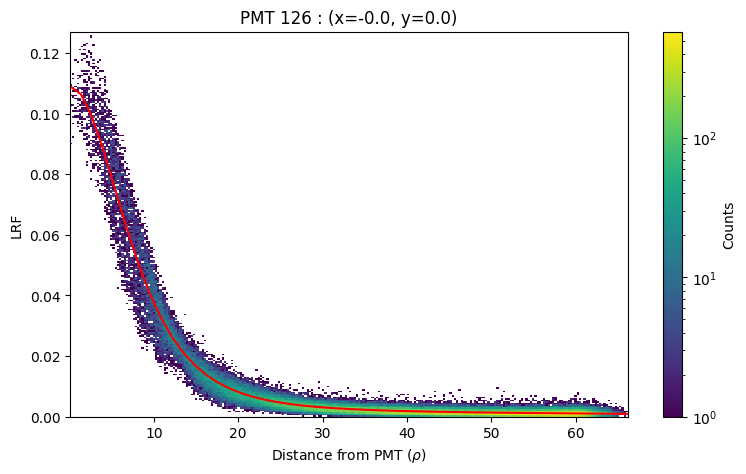

In [6]:
#pmtnr = 126
from matplotlib.colors import LogNorm
from scipy.optimize import curve_fit
fparams = []
covar = []

def LCE_model(rho, I0, p, d, a, b):
    return (I0 * ((1 - b) / (1 + (rho / d)**2)**p + a * rho + b))
for pmtnr in not_dead_pmts:
    try:
        event_dist = ((positions - pmt_pos_top[pmtnr, -2:])**2).numpy().sum(axis=-1)**(1/2)
        tmp = patterns[:,pmtnr] / patterns.numpy().sum(axis=-1)
        mask_tmp = ~((tmp == float('inf')) | (tmp == -float('inf')) | (np.isnan(tmp)))

        initial_guess = [patterns[:,pmtnr].numpy().max(), 1.6242546e+00,  9.4928885e+00, -3.8433252e-05,  7.8334948e-03]
        params, covariance = curve_fit(
                    LCE_model, event_dist[mask_tmp], tmp[mask_tmp], p0=initial_guess, 
        )

        # Extract fitted parameters
        fparams.append(params)
        covar.append(covariance)
    except:
        pass # Dead PMTs
    #I0_fit,p_fit, d_fit, a_fit, b_fit,  = params
    #print("Fitted parameters:")
    #print(f"I0 = {I0_fit}, a = {a_fit}, b = {b_fit}, d = {d_fit}, p = {p_fit}")

fparams = np.array(fparams)
fig = plt.figure(figsize=(9,5))


x = np.linspace(0,tpc_radius)

pmtnr = 126
event_dist = ((positions - pmt_pos_top[pmtnr, -2:])**2).numpy().sum(axis=-1)**(1/2)
tmp = patterns[:,pmtnr] / patterns.numpy().sum(axis=-1)
mask_tmp = ~((tmp == float('inf')) | (tmp == -float('inf')) | (np.isnan(tmp)))
hist = plt.hist2d(event_dist[mask_tmp], tmp[mask_tmp], bins=250, norm=LogNorm())
plt.colorbar(hist[3], label="Counts")
params = fparams[pmtnr]
plt.plot(x, LCE_model(x, *params), label="Data", color="red")

I0_fit,p_fit, d_fit, a_fit, b_fit,  = params
print("Fitted parameters:")
print(f"I0 = {I0_fit}, a = {a_fit}, b = {b_fit}, d = {d_fit}, p = {p_fit}")
plt.title("PMT {} : (x={:.2}, y={:.2})".format(126, *pmt_pos_top[pmtnr,-2:]))
plt.ylabel('LRF')
plt.xlabel(r"Distance from PMT ($\rho$)")
plt.ylim(0)
plt.show()

In [167]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

num_pmts = len(not_dead_pmts)

# Define the grid layout: 6 columns, 41 rows
n_cols = 6
n_rows = 41
fparams = []
covar = []
# Create figure with a defined size to accommodate subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(10, n_rows * 0.8), constrained_layout=True,dpi=1000)

# Generate x values for the fit line
x = np.linspace(0, 60)

# Loop over each PMT and plot in the corresponding subplot
for idx, pmtnr in enumerate(not_dead_pmts):
    # Calculate row and column for the subplot
    row = idx // n_cols
    col = idx % n_cols
    ax = axes[row, col]
    fparams.append(params)
    covar.append(covariance)
    # Calculate event distance and apply mask
    event_dist = ((positions - pmt_pos_top[pmtnr, -2:])**2).numpy().sum(axis=-1)**(1/2)
    tmp = patterns[:,pmtnr] / patterns.numpy().sum(axis=-1)
    mask_tmp = ~((tmp == float('inf')) | (tmp == -float('inf')) | (np.isnan(tmp)))
    
    # Plot histogram with logarithmic color scale
    hist = ax.hist2d(event_dist[mask_tmp], tmp[mask_tmp], bins=100, norm=LogNorm())
    initial_guess = [patterns[:,pmtnr].numpy().max(), 1.6242546e+00,  9.4928885e+00, -3.8433252e-05,  7.8334948e-03]
    params, covariance = curve_fit(
                LCE_model, event_dist[mask_tmp], tmp[mask_tmp], p0=initial_guess, 
    )
    # Plot the fitted model line if available
    ax.plot(x, LCE_model(x, *params), color="red")
    
    # Set title and labels for each subplot
    ax.set_title(f"PMT {pmtnr}", fontsize=8)
    ax.set_ylim(0)
    ax.set_xticks([])
    ax.set_yticks([])

# Add a single colorbar for the entire figure
#cbar = fig.colorbar(hist[3], ax=axes, orientation='horizontal', fraction=0.02, pad=0.1, label="Counts (log scale)")

plt.suptitle("LCE Model Fits", fontsize=16)
plt.show()


(0.0, 11.43)

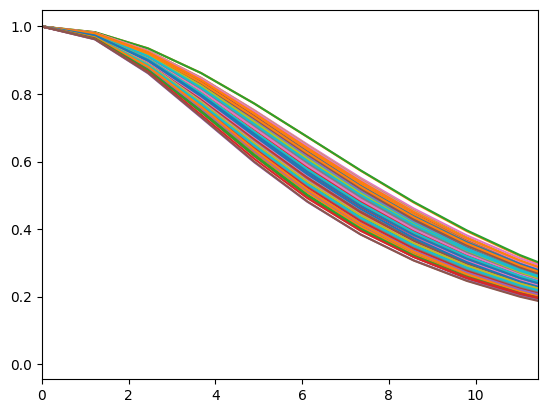

In [193]:
for params in fparams:
    params[0] = 1
    plt.plot(x, LCE_model(x, *params))
plt.xlim(0,3*pmt_radius)

In [245]:
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,        
    restore_best_weights=True,
    min_delta=0.02,
    mode='min',    
    verbose=1      
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    mode = 'min',
    restore_best_weights=True,
    factor=0.25,           
    patience=2,            
    min_delta=0.03,        
    min_lr=1e-8,           
    verbose=1              
)
npmt_pd = np.array([ 1.6242546e+00,  9.4928885e+00, -3.8433252e-05,  7.8334948e-03])

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

radial_lce = get_RLCEModel(pmt_pos_top[not_dead_pmts,2:],n_pmts=not_dead_pmts.shape[0], n_groups=not_dead_pmts.shape[0], group_slices=np.arange(not_dead_pmts.shape[0]).reshape(-1,1), 
                        I0_init=0.1, guess = npmt_pd.tolist())
keras_loss_no_filter = logl_loss_generator(pmt_pos_top[not_dead_pmts], keras.backend, not_dead_pmts = None, cap=float('inf'), allow_njit=allow_njit)
radial_lce.compile(loss= keras_loss_no_filter, optimizer = keras.optimizers.Adam(learning_rate=5e-5))

# Set the weigths we found

I0s = np.zeros(not_dead_pmts.shape[0])
I0s = np.array(fparams)[:,0]
#I0s[I0s == 0] = 0.1
radial_lce.get_layer("QE_Layer").set_weights([I0s])


rlce_params = np.zeros((not_dead_pmts.shape[0], 4))
rlce_params = np.array(fparams)[:,1:]
#rlce_params[(rlce_params == 0).all(axis=-1)] = npmt_pd
radial_lce.get_layer("radial_lce").set_weights([rlce_params])


In [226]:
loss = keras_loss_no_filter(patterns.numpy()[:,not_dead_pmts], radial_lce.predict(positions))
np.sort(loss)[len(loss) // 2]

5768/5768 [==============================] - 53s 9ms/step


2.4031403

(0.0, 7.0)

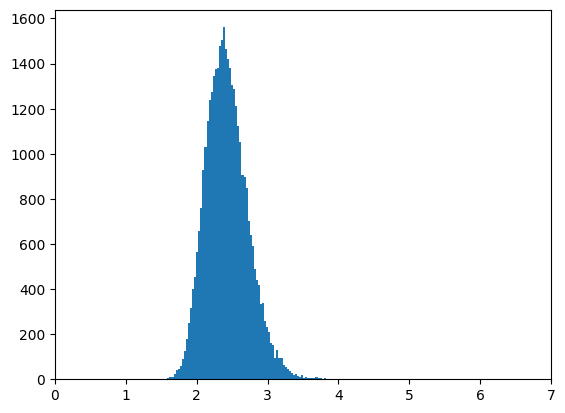

In [249]:
plt.hist(loss, bins=100)
plt.xlim(0,7)

Epoch 1/100
577/577 [==============================] - 29s 50ms/step - loss: 2.3102 - val_loss: 2.4833 - lr: 5.0000e-05
Epoch 2/100
577/577 [==============================] - 29s 50ms/step - loss: 2.2010 - val_loss: 2.1410 - lr: 5.0000e-05
Epoch 3/100
577/577 [==============================] - 29s 50ms/step - loss: 2.1679 - val_loss: 2.1235 - lr: 5.0000e-05
Epoch 4/100
577/577 [==============================] - 29s 51ms/step - loss: 2.1326 - val_loss: 2.1005 - lr: 5.0000e-05
Epoch 5/100
577/577 [==============================] - 29s 51ms/step - loss: 2.1502 - val_loss: 2.1039 - lr: 5.0000e-05
Epoch 6/100
576/577 [============================>.] - ETA: 0s - loss: 2.1101
Epoch 6: ReduceLROnPlateau reducing learning rate to 1.249999968422344e-05.
577/577 [==============================] - 29s 49ms/step - loss: 2.1101 - val_loss: 2.0864 - lr: 5.0000e-05
Epoch 7/100
577/577 [==============================] - 29s 49ms/step - loss: 2.0661 - val_loss: 2.0655 - lr: 1.2500e-05
Epoch 8/100
577/57

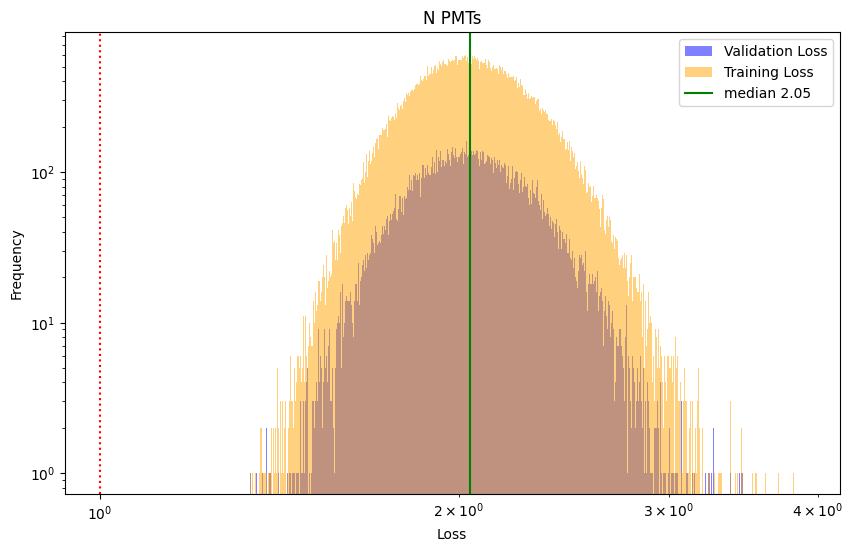

In [250]:
radial_lce.fit(x = x_train, y = y_train.numpy()[:,not_dead_pmts], 
            validation_data=(val[0], val[1].numpy()[:,not_dead_pmts]),
            epochs = 100, batch_size = 2**8, 
            callbacks=[early_stopping, reduce_lr])
val_loss, train_loss = plot_loss_histogram(radial_lce, (x_train, y_train.numpy()[:,not_dead_pmts]), (val[0], val[1].numpy()[:,not_dead_pmts]), ax=None, loss_func=keras_loss_no_filter, bins=1000,
                        title= "N PMTs")


In [269]:
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,        
    restore_best_weights=True,
    min_delta=0.02,
    mode='min',    
    verbose=1      
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    mode = 'min',
    restore_best_weights=True,
    factor=0.25,           
    patience=2,            
    min_delta=0.03,        
    min_lr=1e-8,           
    verbose=1              
)
npmt_pd = np.array([ 1.6242546e+00,  9.4928885e+00, -3.8433252e-05,  7.8334948e-03, 0])

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

radial_lce = get_RLCEModel(pmt_pos_top[not_dead_pmts,2:],n_pmts=not_dead_pmts.shape[0], n_groups=1, group_slices=np.arange(not_dead_pmts.shape[0]).reshape(1,-1), 
                        I0_init=0.1, guess = npmt_pd.tolist())
keras_loss_no_filter = logl_loss_generator(pmt_pos_top[not_dead_pmts], keras.backend, not_dead_pmts = None, cap=float('inf'), allow_njit=allow_njit)
radial_lce.compile(loss= keras_loss_no_filter, optimizer = keras.optimizers.Adam(learning_rate=5e-5))

# Set the weigths we found

I0s = np.zeros(not_dead_pmts.shape[0])
I0s = np.array(fparams)[:,0]
#I0s[I0s == 0] = 0.1
radial_lce.get_layer("QE_Layer").set_weights([I0s])

In [270]:
loss = keras_loss_no_filter(patterns.numpy()[:,not_dead_pmts], radial_lce.predict(positions))
np.sort(loss)[len(loss) // 2]

5768/5768 [==============================] - 5s 943us/step


2.2215974

Epoch 1/100
577/577 [==============================] - 5s 8ms/step - loss: 2.3121 - val_loss: 2.1839 - lr: 5.0000e-05
Epoch 2/100
577/577 [==============================] - 4s 6ms/step - loss: 2.1628 - val_loss: 2.1445 - lr: 5.0000e-05
Epoch 3/100
577/577 [==============================] - 5s 9ms/step - loss: 2.1311 - val_loss: 2.1184 - lr: 5.0000e-05
Epoch 4/100
577/577 [==============================] - 5s 9ms/step - loss: 2.1097 - val_loss: 2.1007 - lr: 5.0000e-05
Epoch 5/100
577/577 [==============================] - 5s 9ms/step - loss: 2.0950 - val_loss: 2.0882 - lr: 5.0000e-05
Epoch 6/100
573/577 [============================>.] - ETA: 0s - loss: 2.0854
Epoch 6: ReduceLROnPlateau reducing learning rate to 1.249999968422344e-05.
577/577 [==============================] - 5s 9ms/step - loss: 2.0854 - val_loss: 2.0828 - lr: 5.0000e-05
Epoch 7/100
577/577 [==============================] - 5s 9ms/step - loss: 2.0798 - val_loss: 2.0781 - lr: 1.2500e-05
Epoch 8/100
574/577 [===========

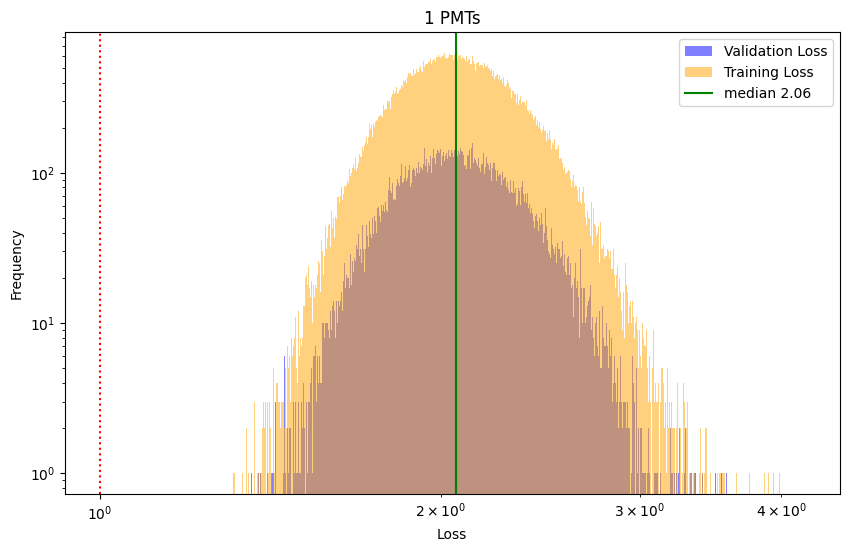

In [272]:
radial_lce.fit(x = x_train, y = y_train.numpy()[:,not_dead_pmts], 
            validation_data=(val[0], val[1].numpy()[:,not_dead_pmts]),
            epochs = 100, batch_size = 2**8, 
            callbacks=[early_stopping, reduce_lr])
val_loss, train_loss = plot_loss_histogram(radial_lce, (x_train, y_train.numpy()[:,not_dead_pmts]), (val[0], val[1].numpy()[:,not_dead_pmts]), ax=None, loss_func=keras_loss_no_filter, bins=1000,
                        title= "1 PMTs")


5768/5768 [==============================] - 5s 788us/step
Jagged iter 0

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
Restoring model weights from the end of the best epoch: 8.

Epoch 12: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
Epoch 12: early stopping
Jagged iter 1

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
Restoring model weights from the end of the best epoch: 8.

Epoch 12: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
Epoch 12: early stopping
Jagged iter 2

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
Restoring model weights from the end of the best epoch: 8.

Epoch 12: ReduceLROnPlateau reducing learning rate to 0.02500000037252903.
Epoch 12: early stopping
Jagged iter 3

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
Restoring model weights from the end of the best epoch: 8.

Epoch 12: ReduceLROnPlateau reducing lear

<Axes: title={'center': 'Corrected 1-PMTs'}, xlabel='X Position', ylabel='Y Position'>

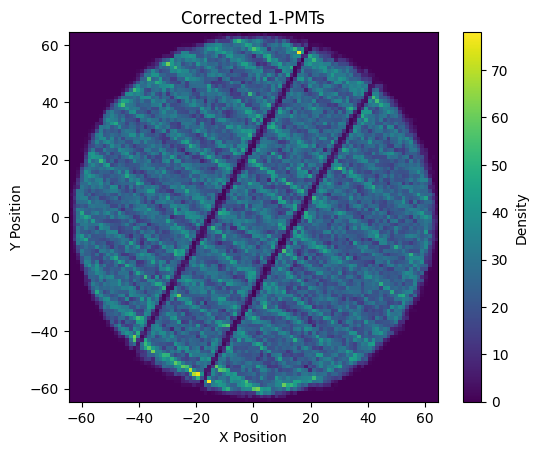

In [277]:
new_pos = train_and_update_pos(positions, patterns.numpy()[:,not_dead_pmts], radial_lce, n_iter = 5, verbose=0, hist_pos=False, keras_loss=keras_loss_no_filter)

ax = plt.gca()

do_density_plot(ax,new_pos, title='Corrected 1-PMTs')

<Axes: title={'center': 'Single LCE'}, xlabel='X Position', ylabel='Y Position'>

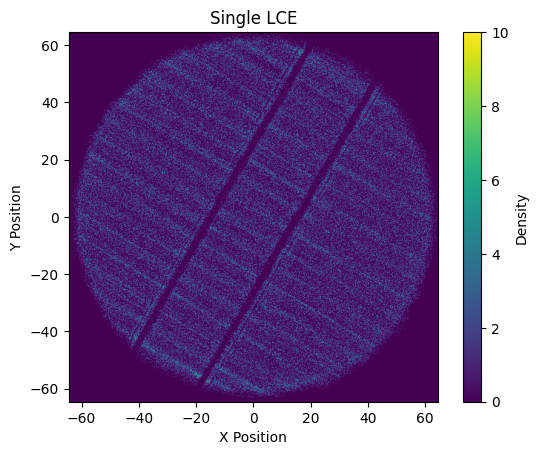

In [281]:
ax = plt.gca()
do_density_plot(ax,new_pos, title='Single LCE', bins=500)


5768/5768 [==============================] - 6s 1ms/step


2.0385222

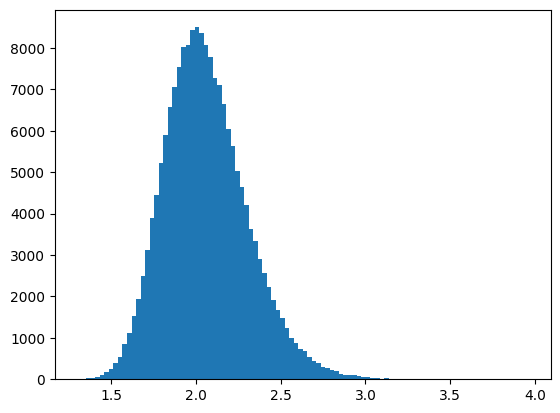

In [278]:
loss = keras_loss_no_filter(patterns.numpy()[:,not_dead_pmts], radial_lce.predict(new_pos))
plt.hist(loss, bins=100)
np.sort(loss)[len(loss) // 2]

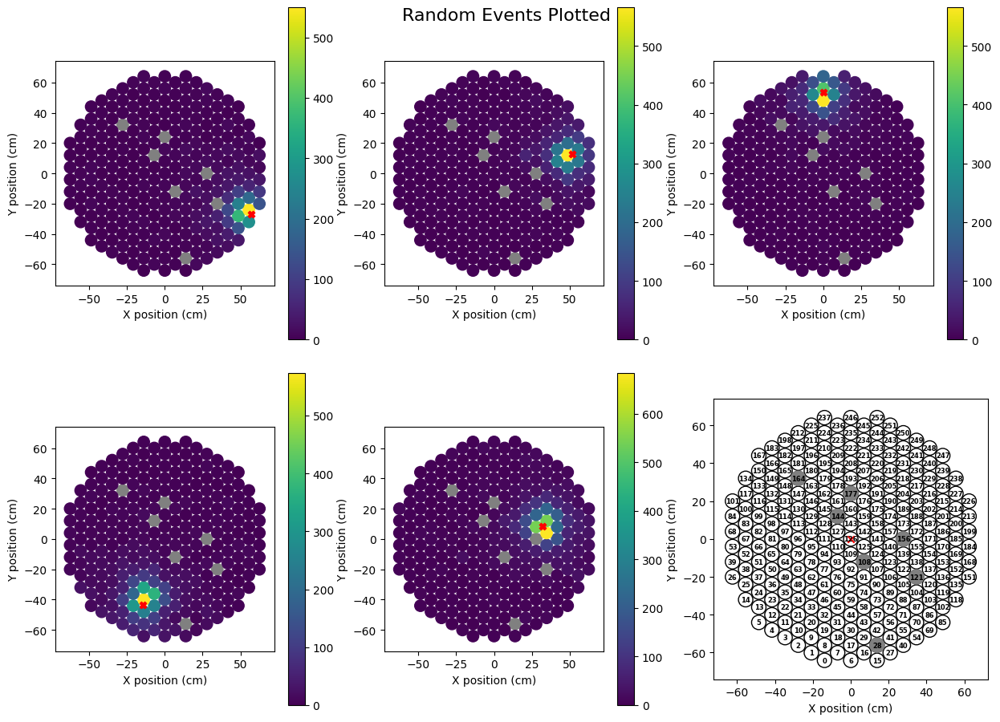

<Figure size 640x480 with 0 Axes>

In [6]:
# Look at some patterns
fig, ax = plt.subplots(2,3, figsize=(15,10))
fig.suptitle("Random Events Plotted", fontsize=16)
ax = ax.flatten()
vmax = np.max(patterns)
vmin = 1
for i in ax[:-1]:
    idx = random.randint(0, patterns.shape[0])
    plot_pmt_response(pmt_pos_top, response=patterns[idx].numpy(), ax = i, title=None, vmax=None, vmin=None, logscale=False, dead_pmts=dead_pmts)
    i.scatter(ei[idx]['x'], ei[idx]['y'], c = 'r', marker = 'X')
_ax = plot_pmt_indeces(pmt_pos_top,ax=ax[-1],fontsize=6, dead_pmts=dead_pmts) 
_ax.scatter(0,0, c='r',marker='x')
plt.subplots_adjust(top=0.98, hspace=0.1)
plt.show()
plt.tight_layout()

## Model Definitions

### LCE Coordinates

Make a model that computes a number of different coordinates for future models.

In [5]:
def get_full_LCE_coordinate_model(n_pmts, pmt_positions, n_pmt_pos = 6):
    """
    Generates all coordinates we will require later
    """
    conv_pmt_coords = keras.models.Sequential([
        keras.layers.RepeatVector(n_pmts, input_shape=(2,)),
        GetFullCoordinateSystem((n_pmts, n_pmt_pos), keras.backend.variable(pmt_positions))
    ], name='xy_to_pmt_coords')
    return conv_pmt_coords
def get_minimal_LCE_coordinate_model(n_pmts, pmt_positions, n_pmt_pos = 1):
    """
    Generate's PMT Position coordinate, the main one used for now
    """
    conv_pmt_coords = keras.models.Sequential([
        keras.layers.RepeatVector(n_pmts, input_shape=(2,)),
        GetRadius((n_pmts, n_pmt_pos), keras.backend.variable(pmt_positions)),
    ], name='xy_to_pmt_coords')
    return conv_pmt_coords

def get_radius_and_wall_dist(n_pmts, pmt_positions,tpc_radius, n_pmt_pos = 1):
    input_pos = keras.layers.RepeatVector(n_pmts, input_shape=(2,))
    rho = GetRadius((n_pmts, n_pmt_pos), keras.backend.variable(pmt_positions))(input_pos)
    WallDist = GetWallDist((n_pmts, n_pmt_pos),tpc_radius)(input_pos)
    conv_pmt_coords = tensorflow.keras.models.Model(inputs = input_pos, outputs = [rho, WallDist], name='xy_to_pmt_coords')
    return conv_pmt_coords

### Pointlike PMTs
With trivial LCE 

In [6]:
def get_pointlike_model(pmt_pos_top,  d, I0_init, p = None): 
    """
    Generate Radial LCE Model for fitting -> Due to grid search etc this essentially became RLCE
    """
    if p is None: p=1
    n_pmts = len(pmt_pos_top)
    # Input layer
    input_pos = keras.layers.Input(shape=(2))
    m = input_pos
    # Get different coordinates
    m = get_minimal_LCE_coordinate_model(n_pmts = n_pmts, pmt_positions = pmt_pos_top, n_pmt_pos = 1)(input_pos)
    # Apply radial lce 
    #m = keras.layers.Lambda(partial(radial_lce, d=d), name='trivial_lce')(m)
    tmp = RadialLCELayer(guess = [p, d, 0, 0,0], n_groups=1, group_slices=[1], name='trivial_lce_layer')
    tmp.trainable = False
    m = tmp(m)
    # Holds I0 for each PMT
    m = I0Layer(n_pmts, init_val= tensorflow.cast(I0_init, tensorflow.float32), name='I0Layer')(m)
    # Normalization Layer 
    #m = keras.layers.Lambda(normalize)(m)
    m = NormalizationLayer(name='Normalization')(m)
    return keras.models.Model(inputs=input_pos, outputs=m, name="Trivial_LCE")

### Radial LCE

In [7]:
def get_RLCEModel(pmt_pos_top,n_pmts, n_groups, group_slices, I0_init, guess,**kwargs):
    """
    Generate Radial LCE Model for fitting
    kwargs -> Overflow from old variables
    """
    # Input layer
    input_pos = keras.layers.Input(shape=(2))
    # Get different coordinates
    rho = get_minimal_LCE_coordinate_model(n_pmts = n_pmts, pmt_positions = pmt_pos_top, n_pmt_pos = 1)(input_pos)
    # Apply radial lce 
    m = RadialLCELayer(name='radial_lce',guess= guess, n_groups=n_groups, group_slices=group_slices)(rho)
    
    # Holds I0 for each PMT
    m = I0Layer(n_pmts, init_val= tensorflow.cast(I0_init, tensorflow.float32), name='QE_Layer')(m)
    # Normalization Layer 
    m = NormalizationLayer(name='Normalization')(m)
    return keras.models.Model(inputs=input_pos, outputs=m, name="Radial_LCE")

### Neural Network

In [8]:
def get_neural_LCE(n_pmts, pmt_pos, I0_init, activation ='relu', final_activation='sigmoid'):
    input = keras.layers.Input(shape=(2))
    # Model to generate relevant coordinates
    m = get_full_LCE_coordinate_model(n_pmts, pmt_pos, n_pmt_pos = 6)(input)
    m = keras.layers.Conv1D(filters=60, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=30, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=15, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=15, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=1, kernel_size=1, activation=final_activation)(m)
    m = keras.layers.Flatten()(m)
    # Add I0 and normalization layers
    m = I0Layer(n_pmts, init_val= 0.1, name='QE_Layer')(m)
    m = NormalizationLayer()(m)
    return keras.Model(inputs=input, outputs=m, name='neural_lce')


### Update Pos Model (Position Encoder)

We want to update the positions to improve the goodness of fit of our model

In [9]:
def get_position_updater(positions, n_to_update, model,input_len = 1, embeddings_constraint=[]):
    """
    Returns encoder model to get patterns from positions
    """
    input = keras.layers.Input(shape=(input_len,))
    if embeddings_constraint != []:
        m = keras.layers.Embedding(n_to_update, 2, input_length = input_len, name='embed_pos',embeddings_constraint=embeddings_constraint)(input)
    else: 
        m = keras.layers.Embedding(n_to_update, 2, input_length = input_len, name='embed_pos')(input)
    m = keras.layers.Flatten()(m)
    m = model(m)
    pos_updater = keras.models.Model(inputs= input, outputs=m, name="Position_Updater")
    pos_updater.layers[-1].trainable = False
    pos_updater.get_layer('embed_pos').set_weights([positions[:n_to_update]])

    return pos_updater

## Getting Reasonable Starting Parameters

I0 is easy enough to find

For p and d the computational time is quite large, dont run any of those cells

In [10]:
# Cell holds precomputed reasonable minima
I0_init_from_ULCE = 0.0040650406504065045
pd_minima = np.array([
    [9.41, 1.71], # Jelle
    [5.41, 1.02], # d_fit -> Unphysical
    [5.94, 1.10], # Grid Search
    [9.277264, 1.7977878], # PD Search 1
    [13.972366, 2.1503458], # PD Search 2
])
npmt_pd = np.array([ 1.6263583e+00,  9.4909382e+00, -4.1542644e-05,  7.7986442e-03])
I0s = np.array([0.004235879983752966, 0.004732195753604174, 0.00466069346293807, 0.004735287744551897, 0.004843718837946653, 0.0036560967564582825, 0.004791035782545805, 0.004351622425019741, 0.004277762491255999, 0.003982590511441231, 0.0036782578099519014, 0.004139808006584644, 0.003963056020438671, 0.004514740779995918, 0.0048719532787799835, 0.003294900059700012, 0.004271252546459436, 0.004213831853121519, 0.003675800282508135, 0.003923185635358095, 0.004053255543112755, 0.003687959862872958, 0.003949134610593319, 0.0039024786092340946, 0.003996435087174177, 0.0045274775475263596, 0.00314155500382185, 0.004692835733294487, 0.0017648281063884497, 0.003712652949616313, 0.0041131614707410336, 0.0039019035175442696, 0.0038532845210283995, 0.003392500802874565, 0.003896859474480152, 0.003918000962585211, 0.004090684931725264, 0.004209689795970917, 0.004247184377163649, 0.0050539360381662846, 0.004631971474736929, 0.0039286985993385315, 0.003714651335030794, 0.003667386481538415, 0.004035579971969128, 0.003805769607424736, 0.003694107523187995, 0.0038736388087272644, 0.004259074572473764, 0.0036939873825758696, 0.004129675682634115, 0.004015707410871983, 0.0042891716584563255, 0.005394953768700361, 0.0049893721006810665, 0.004004128277301788, 0.0036364563275128603, 0.0037317327223718166, 0.0037540518678724766, 0.004226438235491514, 0.003232576884329319, 0.004007598850876093, 0.003992777783423662, 0.00392210902646184, 0.003881508018821478, 0.0037358906120061874, 0.0034426788333803415, 0.004593325313180685, 0.004476095549762249, 0.004509852733463049, 0.00398320984095335, 0.0038602910935878754, 0.0038099722005426884, 0.0035987216979265213, 0.004056497476994991, 0.003779412480071187, 0.003909052349627018, 0.003880080534145236, 0.0037605699617415667, 0.0040501500479876995, 0.003605334088206291, 0.0037680561654269695, 0.003598541719838977, 0.0036737960763275623, 0.004982828162610531, 0.004214885178953409, 0.00394063163548708, 0.00341225927695632, 0.0037580307107418776, 0.003971084486693144, 0.004098842386156321, 0.003986097406595945, 0.004088491201400757, 0.004092586226761341, 0.003926937002688646, 0.004298168700188398, 0.004080779384821653, 0.003439064836129546, 0.003919169306755066, 0.0038085675332695246, 0.004447304643690586, 0.004079096484929323, 0.004161607474088669, 0.0035417259205132723, 0.004211203660815954, 0.003966113086789846, 0.004028564319014549, 0.0038740618620067835, 0.001677889609709382, 0.004096835386008024, 0.004131924360990524, 0.004420299082994461, 0.0038429093547165394, 0.003977605141699314, 0.004036216530948877, 0.0040572527796030045, 0.0034212754108011723, 0.004304381553083658, 0.004800576251000166, 0.003856675000861287, 0.0037602523807436228, 0.0017064257990568876, 0.003873104928061366, 0.003873534733429551, 0.003949661739170551, 0.004201176576316357, 0.0039010290056467056, 0.003948729019612074, 0.004660475999116898, 0.003974431660026312, 0.004105430096387863, 0.003848433494567871, 0.0039720600470900536, 0.004035878926515579, 0.005145389586687088, 0.004992862232029438, 0.004138431046158075, 0.0038946077693253756, 0.0037270355969667435, 0.003934138920158148, 0.004055908881127834, 0.004122219048440456, 0.00413487758487463, 0.004022635985165834, 0.0016843285411596298, 0.0039187888614833355, 0.004069270566105843, 0.004088082350790501, 0.0038323558401316404, 0.003933216445147991, 0.0041273306123912334, 0.00391603447496891, 0.003779760794714093, 0.0038304287008941174, 0.003971415106207132, 0.003770100185647607, 0.0016588973812758923, 0.003752924269065261, 0.0038747305516153574, 0.004287980031222105, 0.004396375268697739, 0.004206789191812277, 0.004279491025954485, 0.0038022841326892376, 0.0016486833337694407, 0.003921540919691324, 0.00393262505531311, 0.0036610763054341078, 0.005085785873234272, 0.00415172940120101, 0.0035354148130863905, 0.004259951412677765, 0.0040181828662753105, 0.003962669055908918, 0.004295114893466234, 0.004105494357645512, 0.00389536889269948, 0.0016863005002960563, 0.004174431320279837, 0.0035444151144474745, 0.0036017769016325474, 0.0038141191471368074, 0.0036408151499927044, 0.004543586168438196, 0.004658541176468134, 0.0037312631029635668, 0.0039724307134747505, 0.0036708605475723743, 0.003768590744584799, 0.003977857064455748, 0.003958065528422594, 0.00391046516597271, 0.004013632424175739, 0.004107540939003229, 0.004054495599120855, 0.003917690832167864, 0.0037647797726094723, 0.003846473526209593, 0.005038938019424677, 0.005282974801957607, 0.003871278138831258, 0.004100256133824587, 0.003908885642886162, 0.004233073443174362, 0.003930484410375357, 0.0037340044509619474, 0.0039030059706419706, 0.0037919552996754646, 0.00414620153605938, 0.003158329986035824, 0.0034461934119462967, 0.004152875859290361, 0.005023165140300989, 0.005013687536120415, 0.004022886045277119, 0.0038592142518609762, 0.003895816160365939, 0.004128684755414724, 0.0037005161866545677, 0.00402730843052268, 0.003608384868130088, 0.0027551278471946716, 0.004201559349894524, 0.0035797676537185907, 0.003656105836853385, 0.004713757894933224, 0.003788005094975233, 0.004254915285855532, 0.0041169957257807255, 0.004034965764731169, 0.0036038379184901714, 0.003389847930520773, 0.003905089572072029, 0.0038801683112978935, 0.0035936341155320406, 0.004151667468249798, 0.0040817963890731335, 0.004347157198935747, 0.004485994577407837, 0.00449867220595479, 0.004051011521369219, 0.0041497559286653996, 0.00477506872266531, 0.004078592173755169, 0.004272844642400742, 0.0041829245164990425, 0.005090698599815369, 0.003888470819219947, 0.004583718255162239, 0.005087660159915686, 0.0047324057668447495, 0.0045408145524561405, 0.0037471496034413576])


#### IO

Minimal uniform I0 0.0040650406504065045, chi^2/ndf : 60.891178131103516


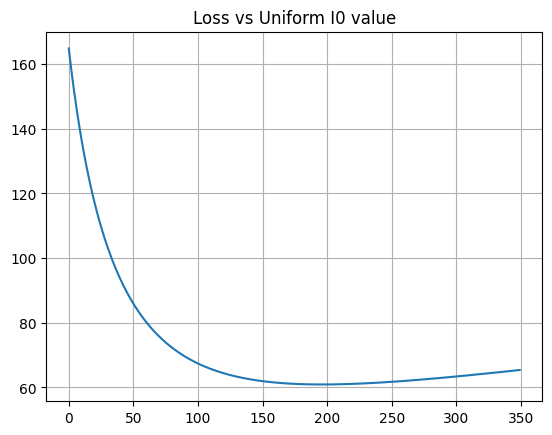

In [23]:
def UniformLCE():
    min_val = 50
    max_val = 400
    patterns_tmp = tensorflow.gather(patterns, val_slice, axis=0)
    tst = [tensorflow.math.reduce_mean(keras_loss(patterns_tmp, tensorflow.ones((len(val_slice), n_pmts), dtype=tensorflow.float32)/i)) for i in range(min_val,max_val)]
    tst_no_nan = tensorflow.where(tensorflow.math.is_nan(tst), tensorflow.constant(float('inf')), tst)
    minidx = tensorflow.argmin(tst_no_nan)
    I0_init_from_ULCE = 1/[i for i in range(min_val,max_val)][minidx]
    plt.plot(tst)
    #plt.axvline(minidx, linestyle = 'dashed',c='r')
    #plt.axhline(tst[minidx], linestyle = 'dashed',c='r')
    plt.grid()
    plt.title("Loss vs Uniform I0 value")
    print("Minimal uniform I0 {}, chi^2/ndf : {}".format(I0_init_from_ULCE, tst[minidx]))  
    return I0_init_from_ULCE
I0_init_from_ULCE = UniformLCE()

#### Grid Search

2.6643853187561035
Minimum loss for d = 5.0


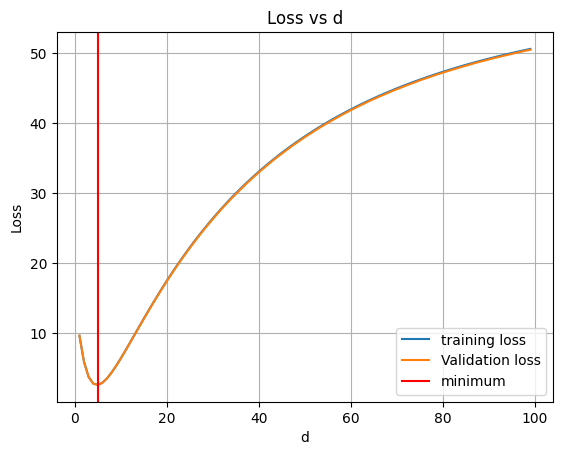

In [194]:
"""
We grid search d as there appear to be multiple minima
"""


you_are_sure = False # THis cell takes really long
if you_are_sure:
    #trials = [i for i in range(1, 10)]
    #trials += [4+i/10 for i in range(0,30)]
    trials = [i/10 for i in range(1, 100)]
    trials = np.array(trials)
    trials.sort()

    x_train = tensorflow.gather(positions, train_slice, axis=0)
    y_train = tensorflow.gather(patterns, train_slice, axis=0)
    val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
    histories = []
    for i in trials:
        trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = i, I0_init=I0_init_from_ULCE)
        trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-4))
        hist = trivial_lce.fit(x = x_train, y = y_train, 
                        validation_data=val,
                        epochs = 3, batch_size = 2**8, verbose = 0)
        histories.append(hist)
    clear_output()
    # Generate default for else
    for i in range(len(histories)):
        print((histories[i].history['loss'][-1], histories[i].history['val_loss'][-1]))

    print('['+','.join([str(i) for i in trials])+']')
else:
    class Dummy:
        def __init__(self, hist):
            self.history = {}
            self.history['loss'] = [hist[0]]
            self.history['val_loss'] = [hist[1]]
            return
    # The below are printed and copied to make sure we dont need to compute everything again
    trials = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99]
    hists = [(9.66630744934082, 9.693140029907227),(5.915377616882324, 5.921973705291748),(3.7877068519592285, 3.786811590194702),(2.844447612762451, 2.8398311138153076),(2.6643853187561035, 2.658963203430176),(2.9762425422668457, 2.970322370529175),(3.6059484481811523, 3.597245931625366),(4.4414238929748535, 4.426479339599609),(5.410750389099121, 5.396216869354248),(6.466648101806641, 6.448941707611084),(7.573036193847656, 7.54727840423584),(8.707929611206055, 8.675724983215332),(9.85308837890625, 9.818233489990234),(11.000469207763672, 10.961116790771484),(12.135531425476074, 12.095026969909668),(13.257564544677734, 13.210643768310547),(14.359561920166016, 14.305418968200684),(15.440990447998047, 15.385758399963379),(16.49669647216797, 16.4412899017334),(17.529438018798828, 17.46733856201172),(18.5338191986084, 18.467445373535156),(19.514724731445312, 19.44345474243164),(20.465593338012695, 20.3986873626709),(21.39261817932129, 21.312551498413086),(22.29405975341797, 22.209856033325195),(23.169919967651367, 23.08746910095215),(24.019306182861328, 23.935028076171875),(24.84353256225586, 24.76090431213379),(25.646854400634766, 25.552494049072266),(26.426189422607422, 26.32708740234375),(27.183263778686523, 27.090360641479492),(27.9184513092041, 27.83902931213379),(28.630970001220703, 28.532146453857422),(29.328306198120117, 29.232295989990234),(29.99976921081543, 29.896066665649414),(30.654062271118164, 30.54361343383789),(31.289981842041016, 31.195974349975586),(31.908838272094727, 31.799291610717773),(32.50888442993164, 32.4034538269043),(33.09375, 32.98643112182617),(33.66079330444336, 33.55526351928711),(34.2133903503418, 34.102230072021484),(34.75031280517578, 34.65596008300781),(35.27174377441406, 35.170806884765625),(35.78227233886719, 35.6636848449707),(36.27385711669922, 36.1576042175293),(36.755924224853516, 36.64472961425781),(37.223175048828125, 37.11143112182617),(37.68233108520508, 37.55574417114258),(38.123435974121094, 38.01717758178711),(38.55811309814453, 38.43014907836914),(38.97645950317383, 38.85628890991211),(39.38795471191406, 39.27908706665039),(39.78447723388672, 39.663291931152344),(40.17253875732422, 40.064231872558594),(40.55189514160156, 40.428043365478516),(40.923885345458984, 40.804569244384766),(41.28238296508789, 41.16868591308594),(41.634117126464844, 41.513832092285156),(41.97605895996094, 41.8662109375),(42.30767059326172, 42.18745040893555),(42.63487243652344, 42.5191535949707),(42.95355224609375, 42.83211135864258),(43.26169967651367, 43.16246032714844),(43.56643295288086, 43.44707107543945),(43.860450744628906, 43.74835968017578),(44.14762878417969, 44.02290344238281),(44.429786682128906, 44.29939651489258),(44.70116424560547, 44.59145736694336),(44.970584869384766, 44.853885650634766),(45.23369216918945, 45.104774475097656),(45.4875602722168, 45.368431091308594),(45.736724853515625, 45.61241912841797),(45.98017501831055, 45.853145599365234),(46.21845626831055, 46.11405944824219),(46.45030975341797, 46.33482360839844),(46.680850982666016, 46.551326751708984),(46.90058517456055, 46.78227233886719),(47.1161994934082, 47.00910568237305),(47.329856872558594, 47.2060432434082),(47.53614044189453, 47.42253494262695),(47.73942565917969, 47.618019104003906),(47.9380989074707, 47.81359100341797),(48.13508987426758, 48.0142707824707),(48.32321548461914, 48.2068977355957),(48.50965118408203, 48.391807556152344),(48.692100524902344, 48.5876579284668),(48.86826705932617, 48.758541107177734),(49.041114807128906, 48.92085647583008),(49.2111930847168, 49.093894958496094),(49.3792724609375, 49.27370834350586),(49.541847229003906, 49.418739318847656),(49.70398712158203, 49.579071044921875),(49.86015701293945, 49.73642349243164),(50.01036071777344, 49.89155960083008),(50.16331481933594, 50.04774856567383),(50.30929946899414, 50.197059631347656),(50.453609466552734, 50.339935302734375),(50.593116760253906, 50.47184753417969)]
    histories = []
    for i in hists:
        histories.append(Dummy(i))

# POlot and get d
loss = []
val_loss = []
for i in range(len(histories)):
    loss.append(histories[i].history['loss'][-1])
    val_loss.append(histories[i].history['val_loss'][-1])
#sorted_pairs = sorted(zip(trials, loss, val_loss))  # Sort by the first element in each pair (x values)
#trials, loss, val_loss = zip(*sorted_pairs)
plt.plot(trials,loss, label = 'training loss')
plt.plot(trials,val_loss, label = 'Validation loss')
trivial_d = (trials[np.argmin(loss)] + trials[np.argmin(val_loss)])/2
print(np.min(loss))
plt.axvline(trivial_d,label='minimum',c='red')
plt.legend()
plt.title("Loss vs d")
plt.xlabel("d")
plt.ylabel('Loss')
print("Minimum loss for d = {}".format(trivial_d))
plt.grid()
plt.show()

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 
1.0 5.083333333333334


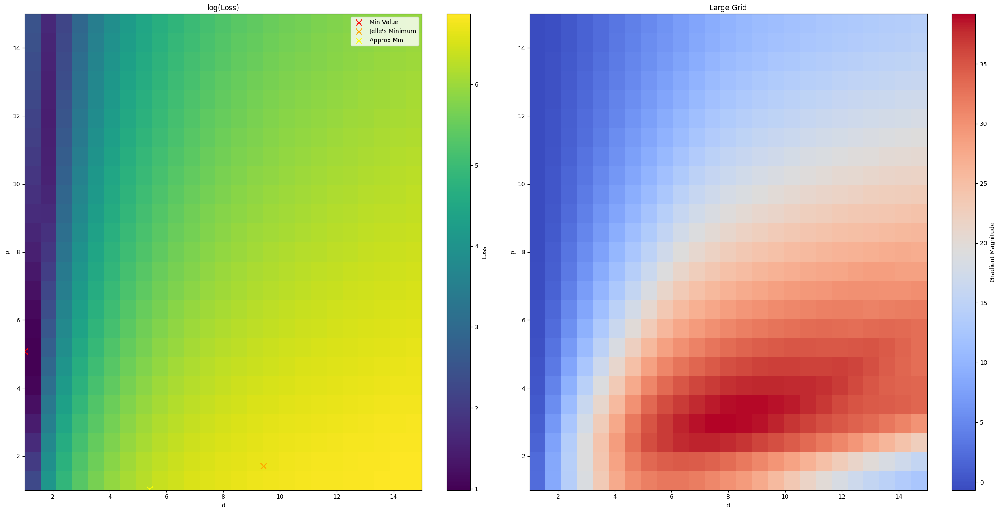

In [195]:
# Find p and d minima -> Multiple local minima on grid for full model later 
# -> We train I0's with the previously found d minimum  
p_vals = np.linspace(1, 15, 25)
d_vals = np.linspace(1, 15, 25)

res_grid = np.zeros([*p_vals.shape, *d_vals.shape])

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

# Get the model
trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE)
trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 2, batch_size = 2**8, verbose = 0) # Params chosen based on results from next cell
for i in range(len(p_vals)):
    print(i, end=', ')
    for j in range(len(d_vals)):
        trivial_lce.get_layer('trivial_lce_layer').set_weights(np.array([d_vals[j],p_vals[i],0,0,0]).reshape(1,1,5))
        # p ,d 
        res_grid[i,j] = keras_loss(val[1][::20],trivial_lce.predict(val[0][::20], verbose=0)).numpy().mean()
print()
# Create side-by-side plots
fig, axs = plt.subplots(1, 2, figsize=(24, 12))

# Left-hand side: Loss Heatmap
axs[0].set_xlabel('d')
axs[0].set_ylabel('p')
im = axs[0].imshow(np.log(res_grid), extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                   aspect='auto', origin='lower', cmap='viridis')
axs[0].set_title('log(Loss)')
plt.colorbar(im, ax=axs[0], label='Loss')

# Find minimum loss and mark it
min_index = np.unravel_index(np.argmin(res_grid), res_grid.shape)
min_value = res_grid[min_index]
min_d = d_vals[min_index[1]]  # Column index corresponds to d
min_p = p_vals[min_index[0]]  # Row index corresponds to p
axs[0].scatter(min_d, min_p, marker='x', color='red', s=100, label='Min Value')
print(min_d, min_p)
# Additional markers
axs[0].scatter(9.42, 1.71, marker='x', color='orange', s=100, label='Jelle\'s Minimum')
axs[0].scatter(5.41, 1.02, marker='x', color='yellow', s=100, label='Approx Min')
axs[0].legend()

# Right-hand side: Gradient Plot
# Assuming gradients are calculated (placeholder for actual gradient computation)
# For demonstration, we'll use a placeholder gradient matrix
gradient_grid = np.gradient(res_grid)  # Replace with your actual gradient computation
axs[1].set_xlabel('d')
axs[1].set_ylabel('p')
im_grad = axs[1].imshow(-gradient_grid[0], extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                         aspect='auto', origin='lower', cmap='coolwarm')
axs[1].set_title('Gradient Heatmap')
plt.colorbar(im_grad, ax=axs[1], label='Gradient Magnitude')
plt.title("Large Grid")
# Show the plots
plt.tight_layout()
plt.show()


0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 


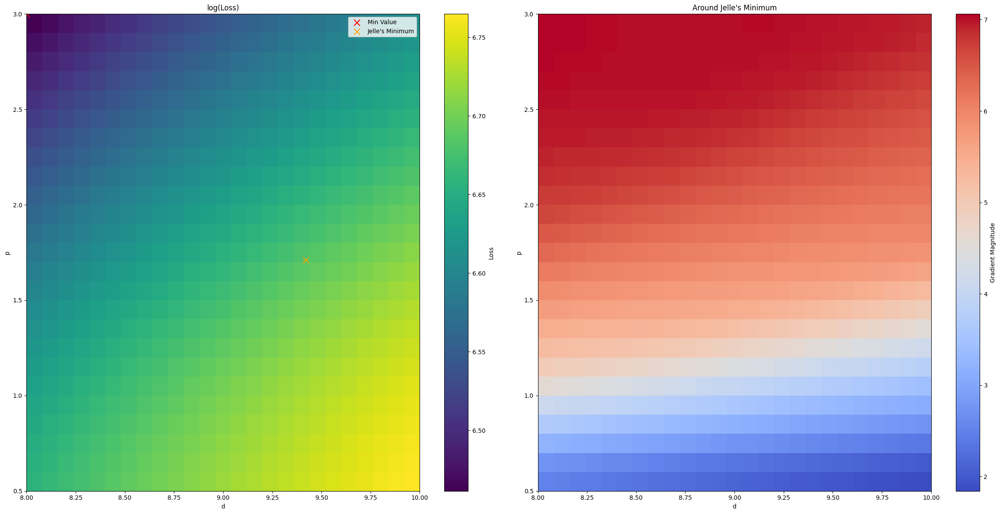

In [196]:
# Find p and d minima -> Around Jelles Minimum
# -> We train I0's with the previously found d minimum  
p_vals = np.linspace(0.5, 3, 25)
d_vals = np.linspace(8, 10, 25)

res_grid = np.zeros([*p_vals.shape, *d_vals.shape])

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

# Get the model
trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE)
trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 2, batch_size = 2**8, verbose = 0) # Params chosen based on results from next cell
for i in range(len(p_vals)):
    print(i, end=', ')
    for j in range(len(d_vals)):
        trivial_lce.get_layer('trivial_lce_layer').set_weights(np.array([d_vals[j],p_vals[i],0,0,0]).reshape(1,1,5))
        # p ,d 
        res_grid[i,j] = keras_loss(val[1][::20],trivial_lce.predict(val[0][::20], verbose=0)).numpy().mean()
print()
# Create side-by-side plots
fig, axs = plt.subplots(1, 2, figsize=(24, 12))

# Left-hand side: Loss Heatmap
axs[0].set_xlabel('d')
axs[0].set_ylabel('p')
im = axs[0].imshow(np.log(res_grid), extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                   aspect='auto', origin='lower', cmap='viridis')
axs[0].set_title('log(Loss)')
plt.colorbar(im, ax=axs[0], label='Loss')

# Find minimum loss and mark it
min_index = np.unravel_index(np.argmin(res_grid), res_grid.shape)
min_value = res_grid[min_index]
min_d = d_vals[min_index[1]]  # Column index corresponds to d
min_p = p_vals[min_index[0]]  # Row index corresponds to p
axs[0].scatter(min_d, min_p, marker='x', color='red', s=100, label='Min Value')

# Additional markers
axs[0].scatter(9.42, 1.71, marker='x', color='orange', s=100, label='Jelle\'s Minimum')
axs[0].legend()

# Right-hand side: Gradient Plot
# Assuming gradients are calculated (placeholder for actual gradient computation)
# For demonstration, we'll use a placeholder gradient matrix
gradient_grid = np.gradient(res_grid)  # Replace with your actual gradient computation
axs[1].set_xlabel('d')
axs[1].set_ylabel('p')
im_grad = axs[1].imshow(-gradient_grid[0], extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                         aspect='auto', origin='lower', cmap='coolwarm')
axs[1].set_title('Gradient Heatmap')
plt.colorbar(im_grad, ax=axs[1], label='Gradient Magnitude')
plt.title("Around Jelle's Minimum")
# Show the plots
plt.tight_layout()
plt.show()


0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 


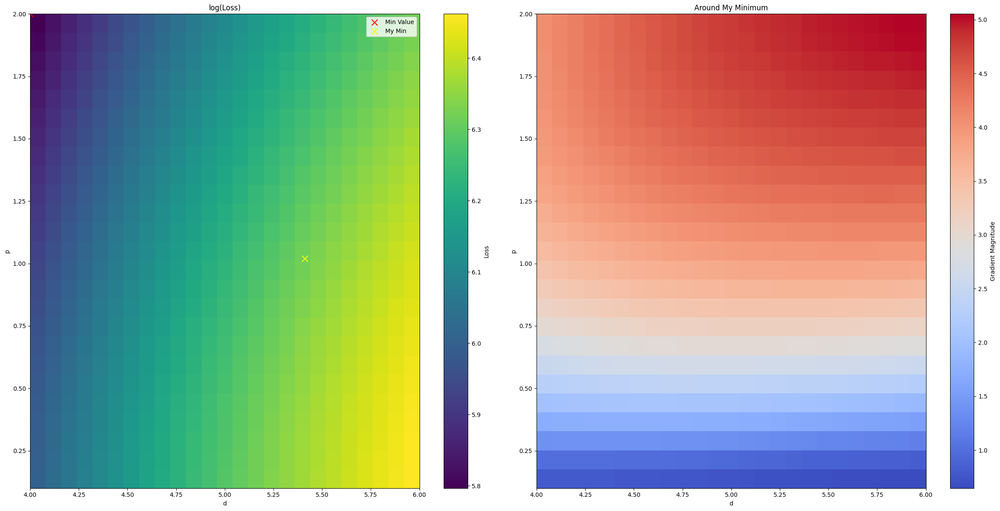

In [197]:
# Find p and d minima -> Around my Minimum
# -> We train I0's with the previously found d minimum  
p_vals = np.linspace(0.1, 2, 25)
d_vals = np.linspace(4, 6, 25)

res_grid = np.zeros([*p_vals.shape, *d_vals.shape])

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

# Get the model
trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE)
trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 2, batch_size = 2**8, verbose = 0) # Params chosen based on results from next cell
for i in range(len(p_vals)):
    print(i, end=', ')
    for j in range(len(d_vals)):
        trivial_lce.get_layer('trivial_lce_layer').set_weights(np.array([d_vals[j],p_vals[i],0,0,0]).reshape(1,1,5))
        # p ,d 
        res_grid[i,j] = keras_loss(val[1][::20],trivial_lce.predict(val[0][::20], verbose=0)).numpy().mean()
print()
# Create side-by-side plots
fig, axs = plt.subplots(1, 2, figsize=(24, 12))

# Left-hand side: Loss Heatmap
axs[0].set_xlabel('d')
axs[0].set_ylabel('p')
im = axs[0].imshow(np.log(res_grid), extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                   aspect='auto', origin='lower', cmap='viridis')
axs[0].set_title('log(Loss)')
plt.colorbar(im, ax=axs[0], label='Loss')

# Find minimum loss and mark it
min_index = np.unravel_index(np.argmin(res_grid), res_grid.shape)
min_value = res_grid[min_index]
min_d = d_vals[min_index[1]]  # Column index corresponds to d
min_p = p_vals[min_index[0]]  # Row index corresponds to p
axs[0].scatter(min_d, min_p, marker='x', color='red', s=100, label='Min Value')

# Additional markers
axs[0].scatter(5.41, 1.02, marker='x', color='yellow', s=100, label='My Min')
axs[0].legend()

# Right-hand side: Gradient Plot
# Assuming gradients are calculated (placeholder for actual gradient computation)
# For demonstration, we'll use a placeholder gradient matrix
gradient_grid = np.gradient(res_grid)  # Replace with your actual gradient computation
axs[1].set_xlabel('d')
axs[1].set_ylabel('p')
im_grad = axs[1].imshow(-gradient_grid[0], extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                         aspect='auto', origin='lower', cmap='coolwarm')
axs[1].set_title('Gradient Heatmap')
plt.colorbar(im_grad, ax=axs[1], label='Gradient Magnitude')
plt.title("Around My Minimum")
# Show the plots
plt.tight_layout()
plt.show()


0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 
1.0833333333333333 5.75


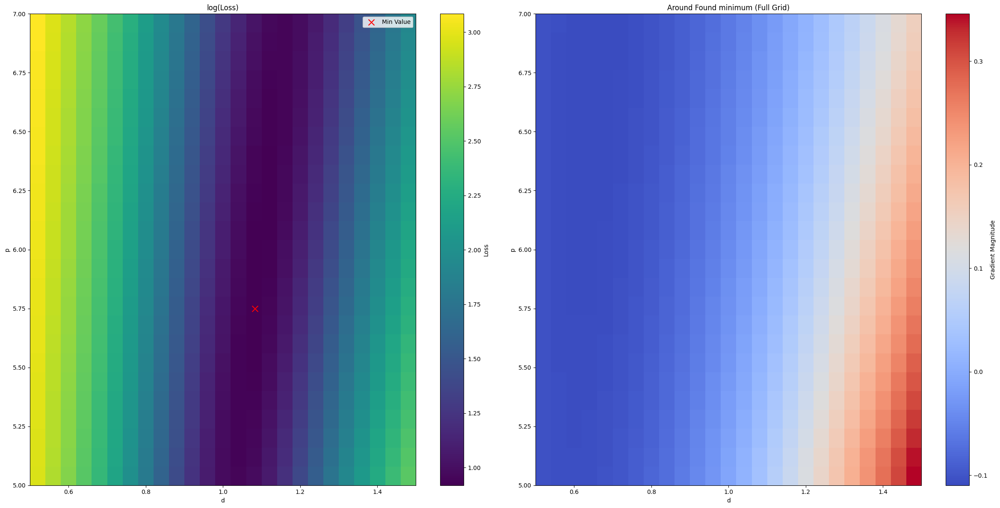

In [198]:
# Find p and d minima -> Found Minimum (iteratively refined range)
# -> We train I0's with the previously found d minimum  
p_vals = np.linspace(5, 7, 25)
d_vals = np.linspace(0.5, 1.5, 25)

res_grid = np.zeros([*p_vals.shape, *d_vals.shape])

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

# Get the model
trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE)
trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 2, batch_size = 2**8, verbose = 0) # Params chosen based on results from next cell
for i in range(len(p_vals)):
    print(i, end=', ')
    for j in range(len(d_vals)):
        trivial_lce.get_layer('trivial_lce_layer').set_weights(np.array([d_vals[j],p_vals[i],0,0,0]).reshape(1,1,5))
        # p ,d 
        res_grid[i,j] = keras_loss(val[1][::20],trivial_lce.predict(val[0][::20], verbose=0)).numpy().mean()
print()
# Create side-by-side plots
fig, axs = plt.subplots(1, 2, figsize=(24, 12))

# Left-hand side: Loss Heatmap
axs[0].set_xlabel('d')
axs[0].set_ylabel('p')
im = axs[0].imshow(np.log(res_grid), extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                   aspect='auto', origin='lower', cmap='viridis')
axs[0].set_title('log(Loss)')
plt.colorbar(im, ax=axs[0], label='Loss')

# Find minimum loss and mark it
min_index = np.unravel_index(np.argmin(res_grid), res_grid.shape)
min_value = res_grid[min_index]
min_d = d_vals[min_index[1]]  # Column index corresponds to d
min_p = p_vals[min_index[0]]  # Row index corresponds to p
axs[0].scatter(min_d, min_p, marker='x', color='red', s=100, label='Min Value')
print(min_d, min_p)
# Additional markers
axs[0].legend()

# Right-hand side: Gradient Plot
# Assuming gradients are calculated (placeholder for actual gradient computation)
# For demonstration, we'll use a placeholder gradient matrix
gradient_grid = np.gradient(res_grid)  # Replace with your actual gradient computation
axs[1].set_xlabel('d')
axs[1].set_ylabel('p')
im_grad = axs[1].imshow(-gradient_grid[0], extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                         aspect='auto', origin='lower', cmap='coolwarm')
axs[1].set_title('Gradient Heatmap')
plt.colorbar(im_grad, ax=axs[1], label='Gradient Magnitude')
plt.title("Around Found minimum (Full Grid)")

# Show the plots
plt.tight_layout()
plt.show()


0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 
1.0958333333333334 5.9375


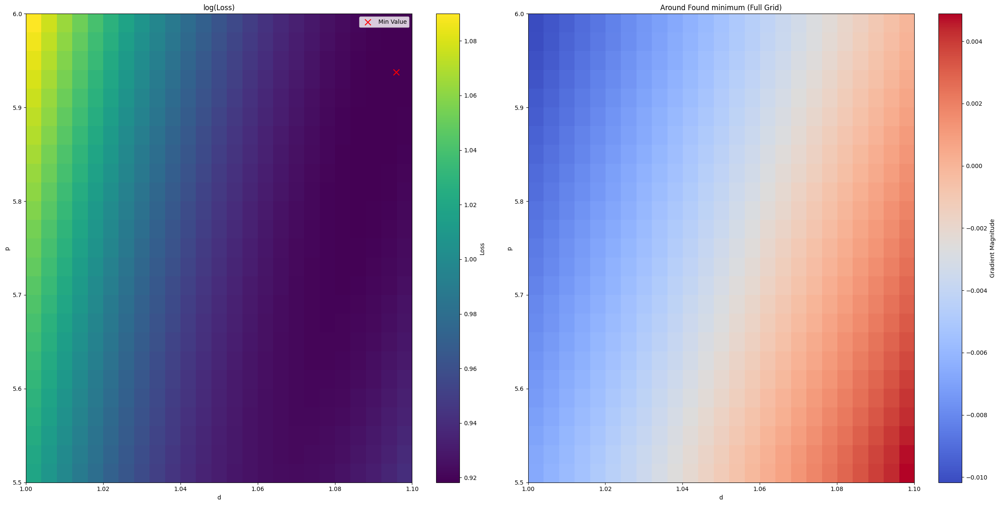

In [199]:
# Find p and d minima -> Fine grid around above
# -> We train I0's with the previously found d minimum  
p_vals = np.linspace(5.5, 6, 25)
d_vals = np.linspace(1.0, 1.1, 25)

res_grid = np.zeros([*p_vals.shape, *d_vals.shape])

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

# Get the model
trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = trivial_d, I0_init=I0_init_from_ULCE)
trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 2, batch_size = 2**8, verbose = 0) # Params chosen based on results from next cell
for i in range(len(p_vals)):
    print(i, end=', ')
    for j in range(len(d_vals)):
        trivial_lce.get_layer('trivial_lce_layer').set_weights(np.array([d_vals[j],p_vals[i],0,0,0]).reshape(1,1,5))
        # p ,d 
        res_grid[i,j] = keras_loss(val[1][::20],trivial_lce.predict(val[0][::20], verbose=0)).numpy().mean()
print()
# Create side-by-side plots
fig, axs = plt.subplots(1, 2, figsize=(24, 12))

# Left-hand side: Loss Heatmap
axs[0].set_xlabel('d')
axs[0].set_ylabel('p')
im = axs[0].imshow(np.log(res_grid), extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                   aspect='auto', origin='lower', cmap='viridis')
axs[0].set_title('log(Loss)')
plt.colorbar(im, ax=axs[0], label='Loss')

# Find minimum loss and mark it
min_index = np.unravel_index(np.argmin(res_grid), res_grid.shape)
min_value = res_grid[min_index]
min_d = d_vals[min_index[1]]  # Column index corresponds to d
min_p = p_vals[min_index[0]]  # Row index corresponds to p
axs[0].scatter(min_d, min_p, marker='x', color='red', s=100, label='Min Value')
print(min_d, min_p)
# Additional markers
axs[0].legend()

# Right-hand side: Gradient Plot
# Assuming gradients are calculated (placeholder for actual gradient computation)
# For demonstration, we'll use a placeholder gradient matrix
gradient_grid = np.gradient(res_grid)  # Replace with your actual gradient computation
axs[1].set_xlabel('d')
axs[1].set_ylabel('p')
im_grad = axs[1].imshow(-gradient_grid[0], extent=[np.min(d_vals), np.max(d_vals), np.min(p_vals), np.max(p_vals)],
                         aspect='auto', origin='lower', cmap='coolwarm')
axs[1].set_title('Gradient Heatmap')
plt.colorbar(im_grad, ax=axs[1], label='Gradient Magnitude')
plt.title("Around Found minimum (Full Grid)")

# Show the plots
plt.tight_layout()
plt.show()


#### P and d

In [200]:
"""
There are multiple apparent minima for the parameter combinations 

These are not apparent using a simple grid search over p and d

We note known minima, and train models in a reasonable range
"""

_known_pos = [
    # d, p
    [1.0958, 5.9375], # Found through exhaustive grid search
    [5.41, 1.02], # Found by model when starting with p=1 d= 5.15 (minimum from p=1 slice)
    [9.42, 1.71] # Minimum found by Jelle, also a minimum for my data but not found here
]

# Generate some starting pos 
d_vals = np.linspace(1, 25, 10)
p_vals = np.linspace(1, 4,  10)


x_train, y_train, val = split_data(positions, patterns, train_slice, val_slice)

# Quickly train the PMT layer using I0 from Jelle's Result 
trivial_lce = get_pointlike_model(pmt_pos_top[:,2:], d = 9.42, I0_init=I0_init_from_ULCE)
trivial_lce.compile(loss = keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val, 
                epochs = 1, batch_size = 2**8, )
I0_init = trivial_lce.get_layer('I0Layer').weights

early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    
    restore_best_weights=True,
    patience=3,           
    min_delta=0.03,
    mode='min',
    verbose=0           
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     
    mode = 'min',
    restore_best_weights=True,
    factor=0.5,
    patience=1,
    min_delta=0.03,
    min_lr=1e-7,
    verbose=0
)

losses = []
params = []


# Found through this method
pd = [[ 1.1079198,  6.700258 ],
      [ 2.3183415,  8.8797   ],
      [ 4.1428084, 10.677858 ],
      [ 5.722972 , 12.244466 ]]

for i in pd:
    rLCE = get_RLCEModel(pmt_pos_top = pmt_pos_top[:,2:], n_pmts=n_pmts, n_groups= 1,
                            group_slices = np.arange(n_pmts),
                            I0_init = I0_init,
                            guess = [*i, 0, 0, 0])
    rLCE.get_layer('QE_Layer').set_weights(I0_init) 
    rLCE.get_layer('QE_Layer').trainable = False
    for _ in range(20):

        rLCE.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-4))

        rLCE.fit(x = x_train, y = y_train, 
            validation_data=val, epochs = 100, batch_size = 2**12, # 2**6 cant make terminate on nan nonverbose sadly
            callbacks=[early_stopping, keras.callbacks.TerminateOnNaN()], verbose=0)

        losses.append(keras_loss(val[1], rLCE.predict(val[0], verbose=0)).numpy().mean())
        params.append(rLCE.get_layer('radial_lce').weights[0].numpy().copy())
        rLCE.get_layer('radial_lce').weights[0].assign_add(tensorflow.random.normal(shape=rLCE.get_layer('radial_lce').weights[0].shape)+1)

577/577 [==============================] - 3s 5ms/step - loss: 5.8717 - val_loss: 5.8299
Batch 6: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 31: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, terminating training
Batch 0: Invalid loss, termina

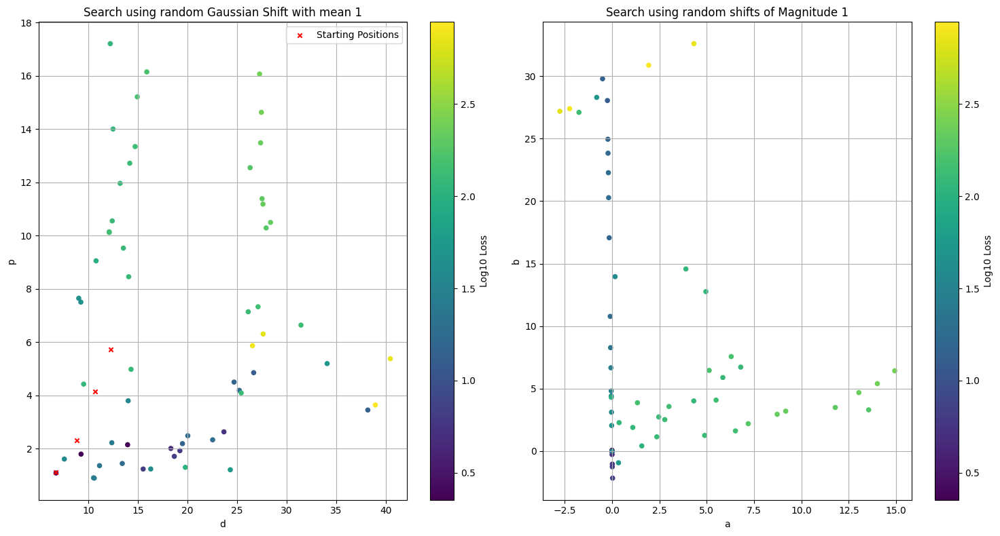

[ 0.07360966 -1.8722107  -2.8641417  -3.4828727  -4.7789736  -5.9373975
 -7.0421295  -6.4373055  -4.6328435  -4.6927576  -4.936044   -6.0395455
 -7.065065   -4.8442183  -2.0428283   0.18197417  3.1836097   6.832718
  5.9052434   4.6494975   0.18022329  1.0011959   0.5603284  -0.52905375
  1.3186122   2.6830842   3.7882996   2.817347    3.6256907   3.784937
  4.691905    4.8952227          nan         nan         nan         nan
         nan         nan         nan         nan  1.5935655   4.66267
  8.720609   11.675241   12.9621     13.7919445  15.8683195  17.89838
 19.178095   19.445946   19.921446   19.901266   21.791992   20.69817
 20.99519    21.008036   20.953178   21.337914   22.798784   22.60234
  1.6083645   0.85138696  0.7811172   0.49851337  0.47043297 -0.54588175
  0.13176332         nan         nan         nan         nan         nan
         nan         nan         nan         nan         nan         nan
         nan         nan]


In [201]:
params_ = np.array(params)
plt_loss = np.log10(losses.copy())

# Set up a side-by-side plot layout
fig, axes = plt.subplots(1, 2, figsize=(15, 8))

# Plot 1: d vs p
sc1 = axes[0].scatter(params_[:, 0, 1], params_[:, 0, 0], c=plt_loss, cmap='viridis', s=20)  # Marker size increased by factor of 2
axes[0].scatter(np.array(pd)[:, 1], np.array(pd)[:, 0], c='red', s=20, marker='x', label='Starting Positions')  # Marker size increased
axes[0].set_xlabel("d")
axes[0].set_ylabel("p")
axes[0].set_title("Search using random Gaussian Shift with mean 1")
axes[0].grid()
axes[0].legend()
fig.colorbar(sc1, ax=axes[0], label="Log10 Loss")

# Plot 2: a vs b
sc2 = axes[1].scatter(params_[:, 0, 2], params_[:, 0, 3], c=plt_loss, cmap='viridis', s=20)  # Marker size increased by factor of 2
axes[1].set_xlabel("a")
axes[1].set_ylabel("b")
axes[1].set_title("Search using random shifts of Magnitude 1")
axes[1].grid()
fig.colorbar(sc2, ax=axes[1], label="Log10 Loss")
plt.tight_layout()
plt.show()


# Print the values of the 5th parameter for reference
print(params_[:, 0, 4]) #idcs 0 and 20 are minima

In [213]:
minima = np.argwhere(np.array(losses) < 3)
# d, p
params_[minima,0, 0], params_[minima,0, 1], np.array(losses)[minima]

(array([[1.7977878],
        [2.1503458]], dtype=float32),
 array([[ 9.277264],
        [13.972366]], dtype=float32),
 array([[2.253123],
        [2.361887]], dtype=float32))

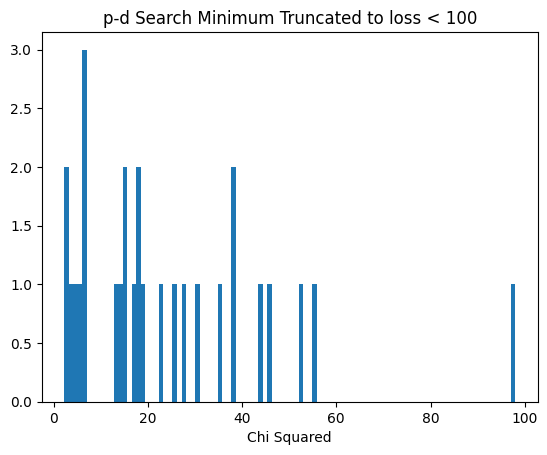

In [214]:
plt.hist([i for i in losses if i < 100], bins=100)
plt.title("p-d Search Minimum Truncated to loss < 100")
plt.xlabel('Chi Squared')
plt.show()

## Model Training

### Train full RadialLCE 1 pmt group

Epoch 1/200
577/577 [==============================] - 3s 5ms/step - loss: 21.8141 - val_loss: 48.3054 - lr: 5.0000e-04
Epoch 2/200
577/577 [==============================] - 2s 4ms/step - loss: 14.7066 - val_loss: 2.3284 - lr: 5.0000e-04
Epoch 3/200
577/577 [==============================] - 3s 5ms/step - loss: 2.2496 - val_loss: 2.1920 - lr: 5.0000e-04
Epoch 4/200
577/577 [==============================] - 3s 5ms/step - loss: 2.1510 - val_loss: 2.1151 - lr: 5.0000e-04
Epoch 5/200
577/577 [==============================] - 3s 5ms/step - loss: 2.0952 - val_loss: 2.0791 - lr: 5.0000e-04
Epoch 6/200
566/577 [============================>.] - ETA: 0s - loss: 2.0726
Epoch 6: ReduceLROnPlateau reducing learning rate to 0.0002500000118743628.
577/577 [==============================] - 3s 5ms/step - loss: 2.0725 - val_loss: 2.0651 - lr: 5.0000e-04
Epoch 7/200
577/577 [==============================] - 3s 5ms/step - loss: 2.0641 - val_loss: 2.0620 - lr: 2.5000e-04
Epoch 8/200
577/577 [========

<Axes: title={'center': 'I0 std between models'}, xlabel='X position (cm)', ylabel='Y position (cm)'>

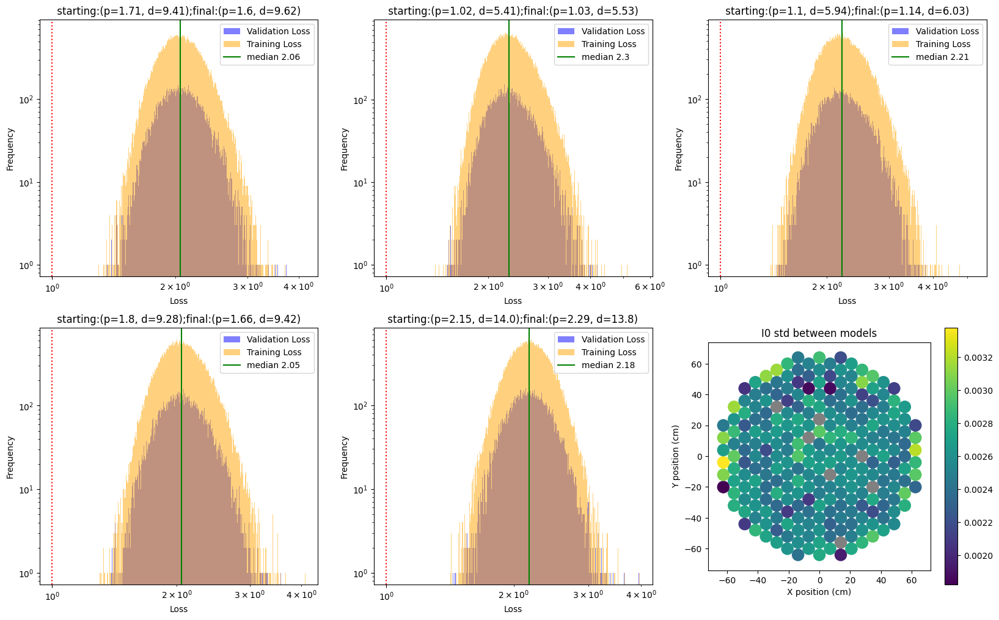

In [224]:

# Last one we fit without subdividing
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=5,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.03,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    restore_best_weights=True,
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.05,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))
f_i0s = []

full_lce_models = []

fig, ax = plt.subplots(2,3, figsize=(20,12))
ax = ax.flatten()
for i in range(len(pd_minima)):
    trivial_lce = get_pointlike_model(pmt_pos_top[:,2:],p = pd_minima[i,1], d = pd_minima[i,0], I0_init=I0_init_from_ULCE)
    trivial_lce.get_layer('trivial_lce_layer').trainable = True
    early_stopping = tensorflow.keras.callbacks.EarlyStopping(
        monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
        patience=5,            # Wait for 2 epochs with no improvement
        restore_best_weights=True,
        min_delta=0.03,        # Minimum change of abs value (4 loss is a common starting point)
        mode='min',            # 'min' because we want to minimize the loss
        verbose=1              # Print messages when stopping
    )
    reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
        monitor='val_loss',     # Metric to monitor (e.g., validation loss)
        mode = 'min',
        restore_best_weights=True,
        factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
        patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
        min_delta=0.05,         # Minimum change to qualify as an improvement (1% in this case)
        min_lr=1e-8,            # Lower bound on the learning rate
        verbose=1               # Print messages when the learning rate is reduced
    )
    trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-4))
    trivial_lce.fit(x = x_train, y = y_train, validation_data = val,
                    epochs = 200, batch_size = 2**8,
                    verbose = 1,
                    callbacks=[early_stopping, reduce_lr]) 
    tmp  = trivial_lce.get_layer('trivial_lce_layer').weights[0][0]
    val_loss, train_loss = plot_loss_histogram(trivial_lce, (x_train, y_train), val, ax=ax[i], loss_func=keras_loss, bins=1000,
                            title= " starting:(p={:.3}, d={:.3});final:(p={:.3}, d={:.3}) ".format(pd_minima[i,1], pd_minima[i,0],tmp[0], tmp[1]))
    full_lce_models.append(trivial_lce)
    f_i0s.append(trivial_lce.layers[3].weights[0])

plot_pmt_response(pmt_pos_top, np.array(f_i0s).std(axis=0),ax=ax[-1], title='I0 std between models', dead_pmts=dead_pmts)

<Axes: title={'center': 'I0 std between models'}, xlabel='X position (cm)', ylabel='Y position (cm)'>

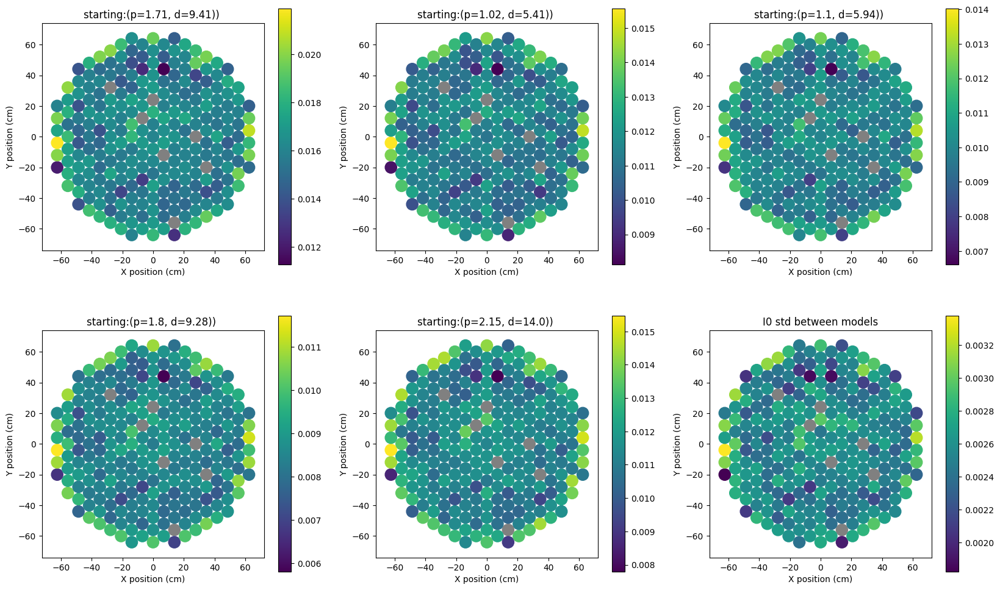

In [227]:
fig, ax = plt.subplots(2,3, figsize=(20,12))
ax = ax.flatten()
for i in range(5):
    plot_pmt_response(pmt_pos_top, f_i0s[i].numpy(),ax=ax[i], title="starting:(p={:.3}, d={:.3})) ".format(pd_minima[i,1], pd_minima[i,0]), dead_pmts=dead_pmts)
plot_pmt_response(pmt_pos_top, np.array(f_i0s).std(axis=0),ax=ax[-1], title='I0 std between models', dead_pmts=dead_pmts)


In [228]:
correlation_matrix = np.corrcoef(f_i0s)
correlation_matrix,correlation_matrix.min()

(array([[1.        , 0.99297161, 0.99092687, 0.99290239, 0.9930183 ],
        [0.99297161, 1.        , 0.98923384, 0.99224194, 0.98857487],
        [0.99092687, 0.98923384, 1.        , 0.99269059, 0.9891946 ],
        [0.99290239, 0.99224194, 0.99269059, 1.        , 0.99252537],
        [0.9930183 , 0.98857487, 0.9891946 , 0.99252537, 1.        ]]),
 0.9885748657128365)

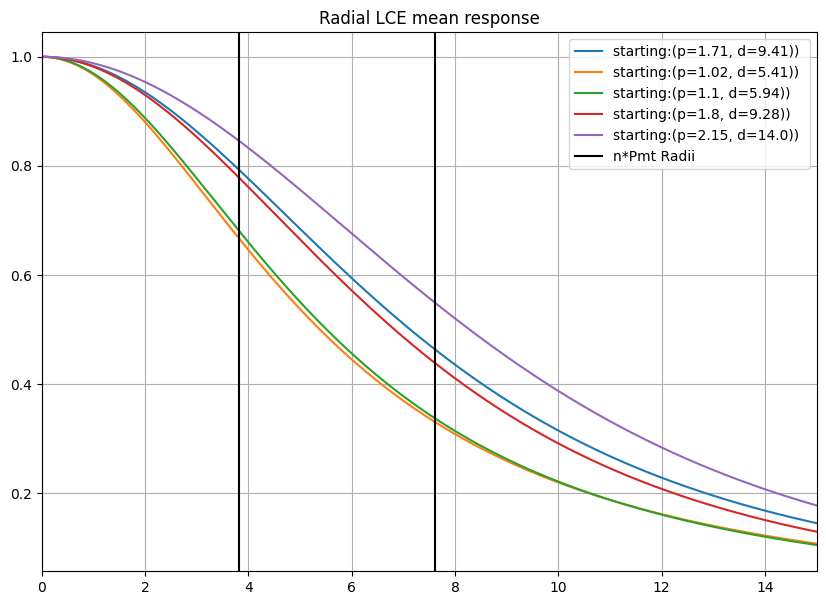

In [229]:
params = []
for i in full_lce_models:
    params.append(i.get_layer('trivial_lce_layer').get_weights()[0][0])
params = np.array(params)
fig = plt.figure(figsize=(10,7))
labels = ['p', 'd', 'abs(a)', 'b', 'c'] # a has negative values
rho = np.linspace(0,4*pmt_radius, 500, dtype='float32')
for i in range(len(params)):
    #full_lce_models[i].get_layer('I0Layer').get_weights()[0].mean()* I0 multiplier - removed
    y = RadialLCELayer.lce_map(RadialLCELayer, rho, *params[i])
    y /= np.max(y)
    plt.plot(rho, y, label = "starting:(p={:.3}, d={:.3})) ".format(pd_minima[i,1], pd_minima[i,0]))
plt.axvline(pmt_radius, c='black', label='n*Pmt Radii')
plt.axvline(2*pmt_radius, c='black')
plt.legend()
plt.grid()
plt.xlim(0,15)
plt.title("Radial LCE mean response")
#plt.yscale('log') # REsscale
plt.show()

### And now the encoder model

#### Pos Start

In [198]:
# To construct we do 
encoders = []
for i in full_lce_models:
    encoders.append(get_position_updater(positions, patterns.shape[0], i, input_len=1))

# We are close to expected site so small learning rates
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
        monitor='loss',
        restore_best_weights=True,
        patience=10,    
        min_delta=0.03,
        mode='min',    
        verbose=1      
    )
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
        monitor='loss', 
        mode = 'min',
        factor=0.25,     
        patience=2,     
        min_delta=0.02, 
        min_lr=1e-3,    
        verbose=1       
    )


fig, ax = plt.subplots(2,3, figsize=(20,12))
ax = ax.flatten()
for i in range(len(encoders)):
    encoders[i].compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-2))
    encoders[i].fit(x = np.arange(patterns.shape[0]), y = patterns, 
                    epochs = 1, batch_size = 2**6,
                    verbose = 1) 
    encoders[i].fit(x = np.arange(patterns.shape[0]), y = patterns, 
                    epochs = 2000, batch_size = 2**6,
                    callbacks=[early_stopping,reduce_lr], verbose = 1) 
    do_density_plot(ax[i], encoders[i].layers[1].weights[0], title='Model '+str(i))
do_density_plot(ax[-1], positions,title='Original Positions')

NameError: name 'full_lce_models' is not defined

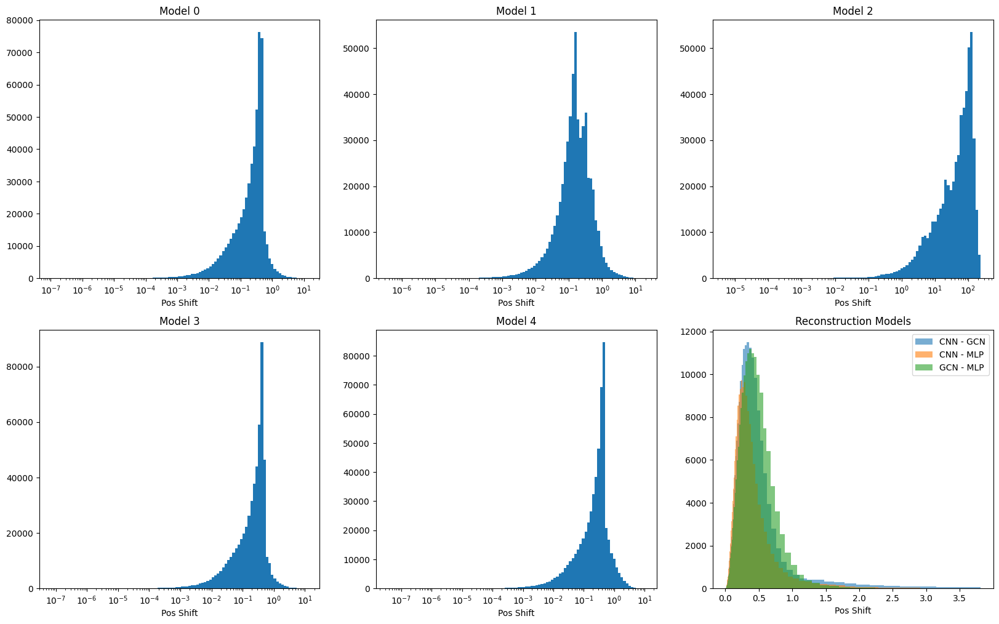

In [40]:
fig, ax = plt.subplots(2,3, figsize=(20,12))
ax = ax.flatten()
for i in range(5):
    differences = ((encoders[i].layers[1].weights[0] - positions)**2).numpy().sum(axis=-1)
    min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
    max_diff = differences.max()
    bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
    ax[i].hist(differences, bins=bins)
    ax[i].set_title("Model " + str(i))
    ax[i].set_xscale('log')
    ax[i].set_xlabel("Pos Shift")

differences = np.sqrt((ei["s2_x_cnn"] - ei["s2_x_gcn"])**2 + 
                       (ei["s2_y_cnn"] - ei["s2_y_gcn"])**2)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
ax[-1].hist(differences, bins=bins, label='CNN - GCN',alpha=0.6)

differences = np.sqrt((ei["s2_x_cnn"] - ei["s2_x_mlp"])**2 + 
                       (ei["s2_y_cnn"] - ei["s2_y_mlp"])**2)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
ax[-1].hist(differences, bins=bins, label='CNN - MLP',alpha=0.6)

differences = np.sqrt((ei["s2_x_gcn"] - ei["s2_x_mlp"])**2 + 
                       (ei["s2_y_gcn"] - ei["s2_y_mlp"])**2)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
ax[-1].hist(differences, bins=bins, label='GCN - MLP',alpha=0.6)
ax[-1].set_xlabel("Pos Shift")
ax[-1].set_title("Reconstruction Models")
ax[-1].legend()


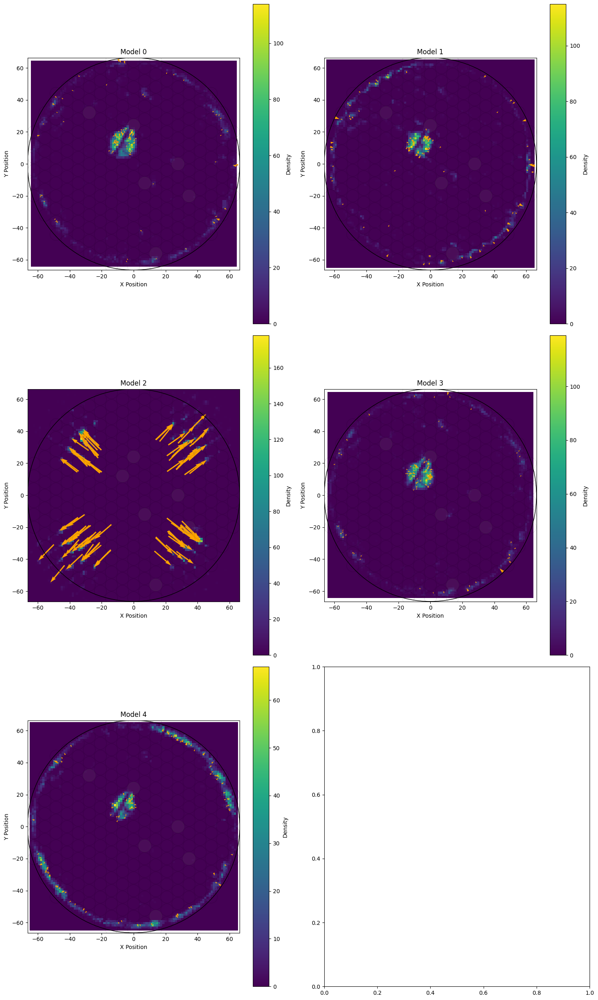

In [44]:
fig, ax = plt.subplots(3,2, figsize=(15,25))
ax = ax.flatten()

num_arrows = 100
for i in range(len(encoders)):
    differences = ((encoders[i].layers[1].weights[0] - positions)**2).numpy().sum(axis=-1)
    high_diff_mask = differences > np.percentile(differences, 98)
    new_pos = encoders[i].layers[1].weights[0].numpy()[high_diff_mask]
    do_density_plot(ax[i], new_pos, title='Model '+str(i))
    old_pos = positions.numpy()[high_diff_mask]
    if len(new_pos) > num_arrows:
        indices = np.random.choice(len(new_pos), num_arrows, replace=False)
        new_pos = new_pos[indices]
        old_pos = old_pos[indices]
    dx = new_pos[:, 0] - old_pos[:, 0]
    dy = new_pos[:, 1] - old_pos[:, 1]
    ax[i].quiver(old_pos[:, 0], old_pos[:, 1], dx, dy, angles='xy', scale_units='xy', scale=1, color='orange')
    circle = plt.Circle((0,0), tpc_radius, color='black', fill=False)
    ax[i].add_artist(circle)
    ax[i].set_xlim(-tpc_radius, tpc_radius)
    ax[i].set_ylim(-tpc_radius, tpc_radius)
    plot_pmt_circles(ax[i], pmt_pos_top, dead_pmts=dead_pmts, alpha=0.1, linestyle='-')
plt.tight_layout()

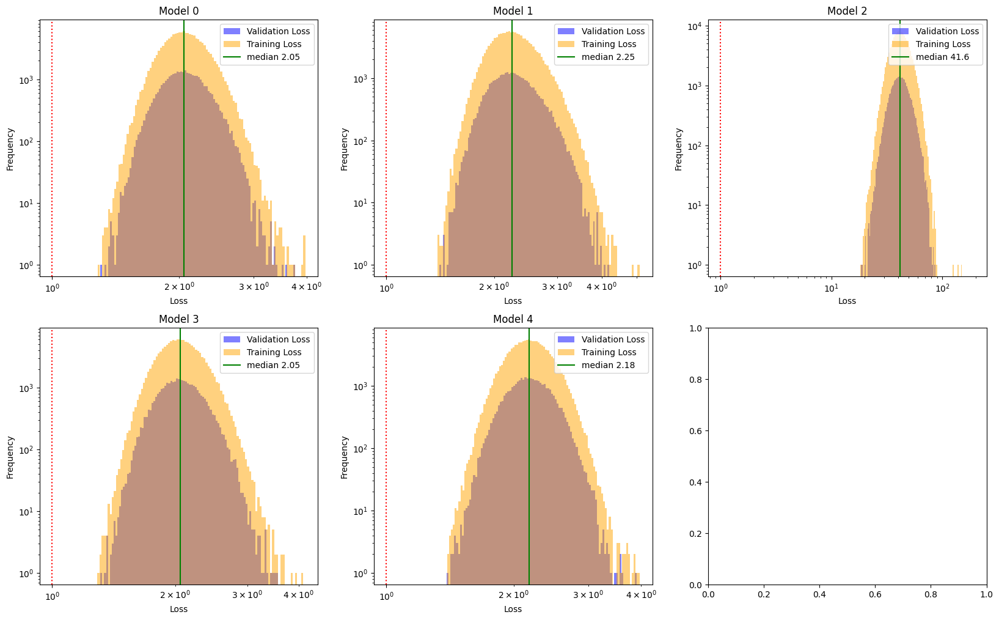

In [45]:
fig, ax = plt.subplots(2, 3, figsize=(20, 12))
ax = ax.flatten()
# Plot each model's histogram
for i in range(len(encoders)):
    plot_loss_histogram(encoders[i], (train_slice, y_train), (val_slice, val[1]), keras_loss, bins=100, ax=ax[i], title = 'Model '+str(i))
#plt.tight_layout()
plt.show()

#### Pos +- rand Start

Using Subset

Epoch 1/100
577/577 [==============================] - 3s 5ms/step - loss: 9.5874 - val_loss: 2.0737 - lr: 5.0000e-04
Epoch 2/100
577/577 [==============================] - 3s 6ms/step - loss: 2.0739 - val_loss: 2.0717 - lr: 5.0000e-04
Epoch 3/100
572/577 [============================>.] - ETA: 0s - loss: 2.0721
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.0002500000118743628.
577/577 [==============================] - 3s 5ms/step - loss: 2.0722 - val_loss: 2.0730 - lr: 5.0000e-04
Epoch 4/100
577/577 [==============================] - 3s 6ms/step - loss: 2.0670 - val_loss: 2.0661 - lr: 2.5000e-04
Epoch 5/100
573/577 [============================>.] - ETA: 0s - loss: 2.0673
Epoch 5: ReduceLROnPlateau reducing learning rate to 0.0001250000059371814.
577/577 [==============================] - 3s 5ms/step - loss: 2.0674 - val_loss: 2.0647 - lr: 2.5000e-04
Epoch 6/100
577/577 [==============================] - 4s 7ms/step - loss: 2.0636 - val_loss: 2.0622 - lr: 1.2500e-04
Epoch 6:

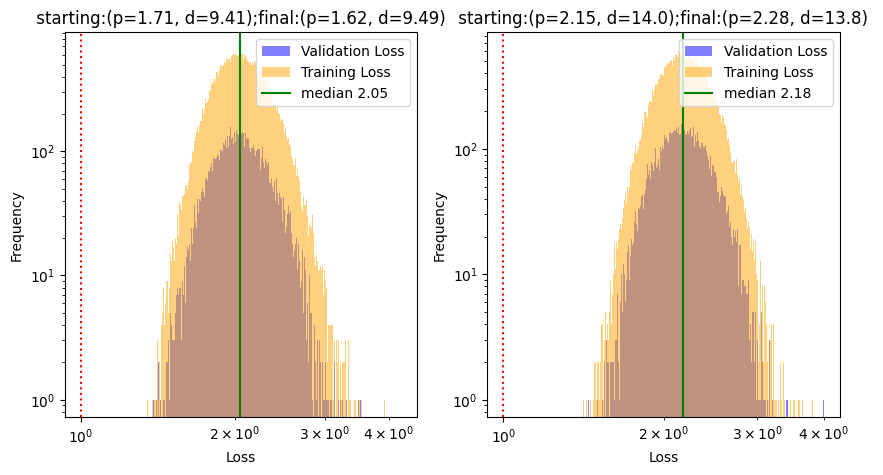

In [235]:
pd_subset = np.array([
    [ 9.41     ,  1.71     ], 
    [13.972366 ,  2.1503458]
])
# Retrain the models we care about
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=5,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.015,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    restore_best_weights=True,
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.05,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

full_lce_models = []
lr = 5e-4
fig, ax = plt.subplots(1,2, figsize=(10,5))
ax = ax.flatten()
for i in range(len(pd_subset)):
    trivial_lce = get_pointlike_model(pmt_pos_top[:,2:],p = pd_subset[i,1], d = pd_subset[i,0], I0_init=I0_init_from_ULCE)
    trivial_lce.get_layer('trivial_lce_layer').trainable = True
    trivial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=lr))
    trivial_lce.fit(x = x_train, y = y_train, 
                validation_data=val,
                epochs = 100, batch_size = 2**8, 
                callbacks=[early_stopping, reduce_lr])
    f_i0s.append(trivial_lce.get_layer('I0Layer').weights[0].numpy())
    tmp  = trivial_lce.get_layer('trivial_lce_layer').weights[0][0]
    val_loss, train_loss = plot_loss_histogram(trivial_lce, (x_train, y_train), val, ax=ax[i], loss_func=keras_loss, bins=1000,
                            title= " starting:(p={:.3}, d={:.3});final:(p={:.3}, d={:.3}) ".format(pd_subset[i,1], pd_subset[i,0],tmp[0], tmp[1]))
    full_lce_models.append(trivial_lce)


In [166]:
def train_and_update_pos(positions, patterns, model, n_iter = 5, verbose=0, hist_pos=False, keras_loss=keras_loss):
    early_stopping = tensorflow.keras.callbacks.EarlyStopping(
        monitor='loss',
        restore_best_weights=True,
        patience=4,    
        min_delta=0.05,
        mode='min',    
        verbose=1      
    )
    reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
        monitor='loss', 
        mode = 'min',
        factor=0.5,     
        patience=2,     
        min_delta=0.05, 
        min_lr=1e-3,    
        verbose=1       
    )
    n_tot = len(positions)
    pos_updater = get_position_updater(positions, n_tot, model ,input_len = 1)
    # Inspecting the degree of change
    if hist_pos:
        trained_pos = []

    new_pos = tensorflow.identity(positions)
    loss    = keras_loss(patterns, model.predict(positions))
    improved= np.zeros(positions.shape[0])
    improved[:] = -1
    for i in range(n_iter):
        print("Jagged iter {}".format(i))
        # tensorflow_probability requires tensorflow >= 2.16 we have == 2.15
        # Random dist gives max deviation root{2}*pmt_radius (~70% of diameter)
        noise_pos = tensorflow.identity(positions) + np.random.rand(*new_pos.numpy().shape) * pmt_radius
        # Update and fit encoder model positions
        pos_updater.get_layer('embed_pos').set_weights([noise_pos])
        # Compile and fit
        pos_updater.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-1))
        pos_updater.fit(x = np.arange(n_tot), y = patterns, 
                        epochs = 20, batch_size = 2**12,
                        callbacks=[early_stopping,reduce_lr], verbose = verbose) 
        noise_pos = pos_updater.get_layer('embed_pos').get_weights()[0]
        # Check result of new pos
        jittered_loss = keras_loss(patterns, model.predict(noise_pos, verbose=verbose))

        better = jittered_loss < loss
        loss =    tensorflow.where(better, jittered_loss, loss) 
        new_pos = tensorflow.where(tensorflow.expand_dims(better, axis=-1), noise_pos, new_pos) 
        improved[better.numpy()] = i
        if hist_pos:
            trained_pos.append(noise_pos)

    print("Jittering Results")
    print("Didnt improve : {}%".format((improved == -1).mean()*100))
    for i in range(n_iter):
        print("Iteration {} : {}%".format(i, (improved == i).mean()*100))
    if not hist_pos:
        return new_pos
    else:
        return new_pos, trained_pos

5768/5768 [==============================] - 4s 691us/step
Jagged iter 0
Epoch 1/20
46/46 [==============================] - 1s 12ms/step - loss: 3.6244 - lr: 0.1000
Epoch 2/20
46/46 [==============================] - 1s 11ms/step - loss: 3.0417 - lr: 0.1000
Epoch 3/20
46/46 [==============================] - 0s 11ms/step - loss: 2.6329 - lr: 0.1000
Epoch 4/20
46/46 [==============================] - 0s 11ms/step - loss: 2.3738 - lr: 0.1000
Epoch 5/20
46/46 [==============================] - 0s 11ms/step - loss: 2.2217 - lr: 0.1000
Epoch 6/20
46/46 [==============================] - 0s 11ms/step - loss: 2.1380 - lr: 0.1000
Epoch 7/20
46/46 [==============================] - 0s 11ms/step - loss: 2.0948 - lr: 0.1000
Epoch 8/20
46/46 [==============================] - 0s 11ms/step - loss: 2.0738 - lr: 0.1000
Epoch 9/20
46/46 [==============================] - 0s 11ms/step - loss: 2.0644 - lr: 0.1000
Epoch 10/20
41/46 [=========================>....] - ETA: 0s - loss: 2.0605
Epoch 10: Redu

<Axes: title={'center': 'Original Positions'}, xlabel='X Position', ylabel='Y Position'>

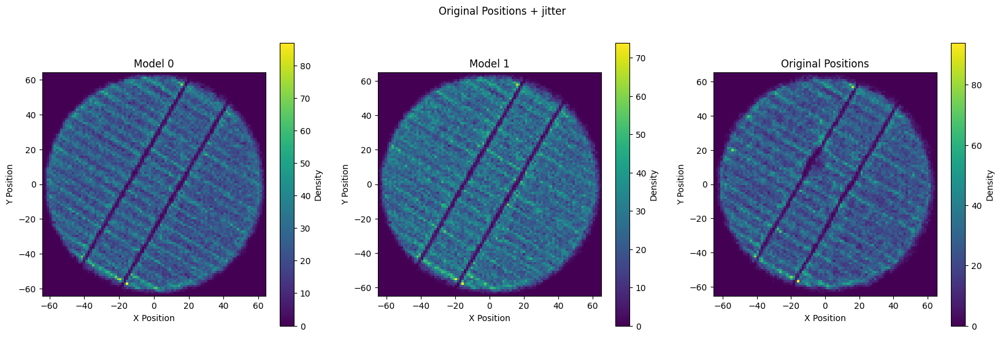

In [237]:

new_pos = []

fig, ax = plt.subplots(1,3, figsize=(20,6))
ax = ax.flatten()
for i in range(len(full_lce_models)):
    new_pos.append(train_and_update_pos(positions, patterns, full_lce_models[i], n_iter = 5, verbose=1, hist_pos=False))
    do_density_plot(ax[i], new_pos[i], title='Model '+str(i))
fig.suptitle("Original Positions + jitter")
do_density_plot(ax[-1], positions,title='Original Positions')

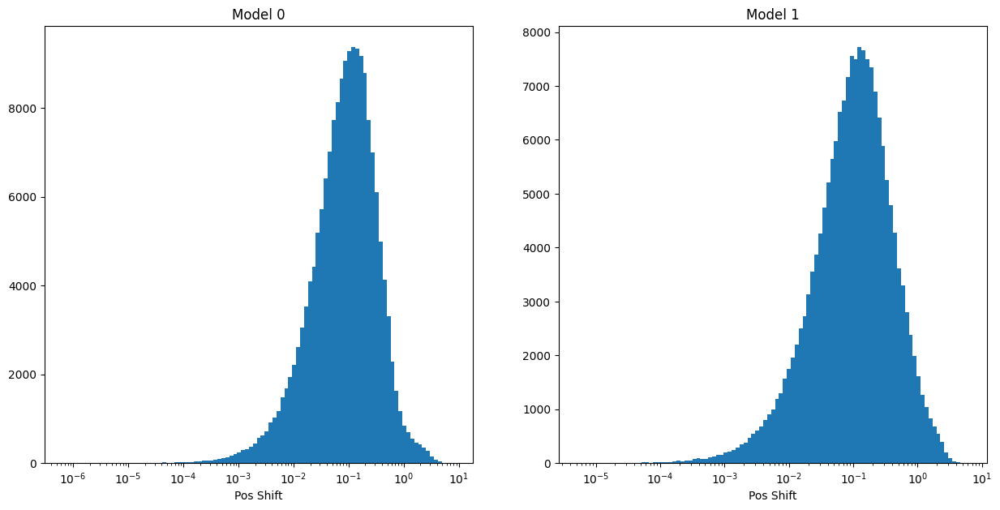

In [238]:
fig, ax = plt.subplots(1,2, figsize=(15,7))
ax = ax.flatten()
for i in range(2):
    differences = ((new_pos[i] - positions)**2).numpy().sum(axis=-1)
    min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
    max_diff = differences.max()
    bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
    ax[i].hist(differences, bins=bins)
    ax[i].set_title("Model " + str(i))
    ax[i].set_xscale('log')
    ax[i].set_xlabel("Pos Shift")


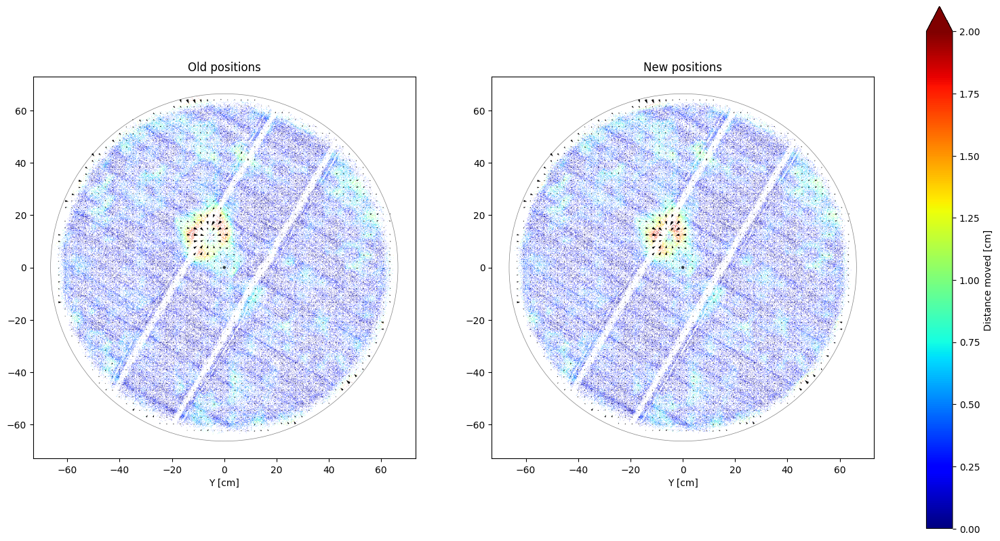

Mean:  2.0485568
Median:  2.0262232


In [239]:
pos_diff_plot(positions, new_pos[0], pmt_pos, dead_pmts,tpc_radius, vmax=2, s=0.15, dpi=200, save=None)
loss = keras_loss(patterns, full_lce_models[0].predict(new_pos[0], verbose=0)).numpy()
print("Mean: ", loss.mean())
print("Median: ", np.sort(loss)[len(loss) //2])

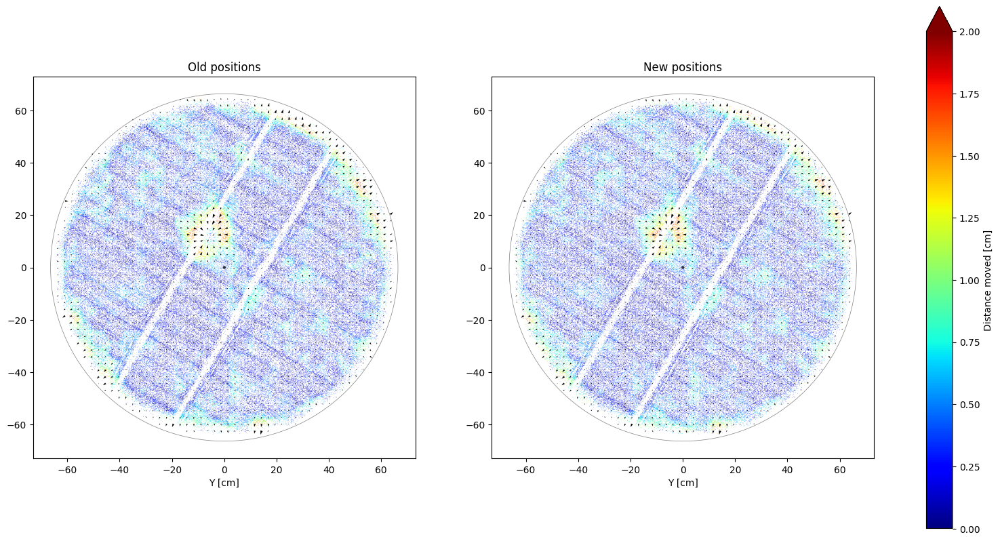

Mean:  2.1674898
Median:  2.1509438


In [240]:
pos_diff_plot(positions, new_pos[1], pmt_pos, dead_pmts,tpc_radius, vmax=2, s=0.15, dpi=200, save=None)
loss = keras_loss(patterns, full_lce_models[1].predict(new_pos[1], verbose=0)).numpy()
print("Mean: ", loss.mean())
print("Median: ", np.sort(loss)[len(loss) //2])

In [242]:
full_lce_models[0].weights[-2]

<tf.Variable 'trivial_lce_layer/lce_params:0' shape=(1, 5) dtype=float32, numpy=
array([[ 1.6242546e+00,  9.4928885e+00, -3.8433252e-05,  7.8334948e-03,
         7.5530492e-02]], dtype=float32)>

### Single PMT singel Model

For rerunning

Epoch 1/100
577/577 [==============================] - 5s 8ms/step - loss: 2.0563 - val_loss: 2.0528 - lr: 5.0000e-06
Epoch 2/100
577/577 [==============================] - 6s 10ms/step - loss: 2.0542 - val_loss: 2.0525 - lr: 5.0000e-06
Epoch 3/100
571/577 [============================>.] - ETA: 0s - loss: 2.0542
Epoch 3: ReduceLROnPlateau reducing learning rate to 2.499999936844688e-06.
577/577 [==============================] - 5s 8ms/step - loss: 2.0542 - val_loss: 2.0524 - lr: 5.0000e-06
Epoch 4/100
577/577 [==============================] - 6s 10ms/step - loss: 2.0536 - val_loss: 2.0521 - lr: 2.5000e-06
Epoch 5/100
576/577 [============================>.] - ETA: 0s - loss: 2.0536
Epoch 5: ReduceLROnPlateau reducing learning rate to 1.249999968422344e-06.
577/577 [==============================] - 5s 9ms/step - loss: 2.0536 - val_loss: 2.0526 - lr: 2.5000e-06
Epoch 6/100
577/577 [==============================] - 5s 8ms/step - loss: 2.0535 - val_loss: 2.0520 - lr: 1.2500e-06
Epoch 

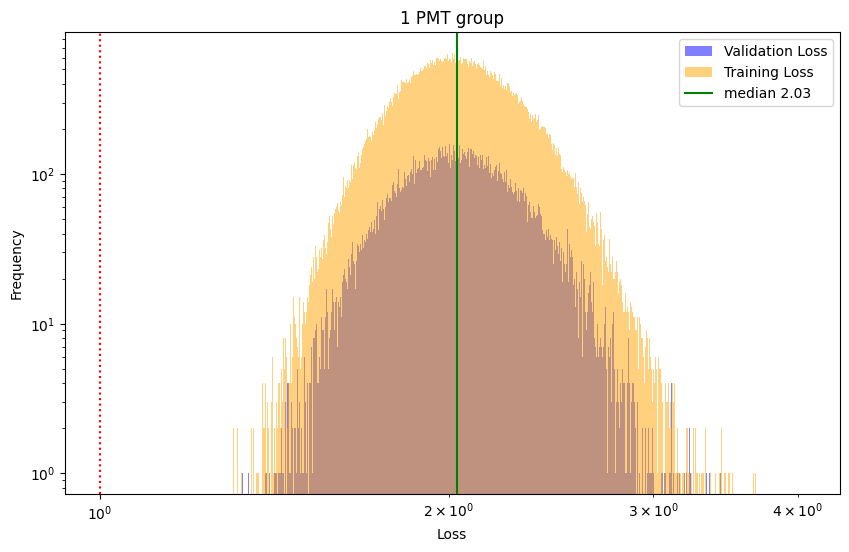

In [163]:
npmt_pd = np.array([ 1.6263583e+00,  9.4909382e+00, -4.1542644e-05,  7.7986442e-03])
I0s = np.array([0.004235879983752966, 0.004732195753604174, 0.00466069346293807, 0.004735287744551897, 0.004843718837946653, 0.0036560967564582825, 0.004791035782545805, 0.004351622425019741, 0.004277762491255999, 0.003982590511441231, 0.0036782578099519014, 0.004139808006584644, 0.003963056020438671, 0.004514740779995918, 0.0048719532787799835, 0.003294900059700012, 0.004271252546459436, 0.004213831853121519, 0.003675800282508135, 0.003923185635358095, 0.004053255543112755, 0.003687959862872958, 0.003949134610593319, 0.0039024786092340946, 0.003996435087174177, 0.0045274775475263596, 0.00314155500382185, 0.004692835733294487, 0.0017648281063884497, 0.003712652949616313, 0.0041131614707410336, 0.0039019035175442696, 0.0038532845210283995, 0.003392500802874565, 0.003896859474480152, 0.003918000962585211, 0.004090684931725264, 0.004209689795970917, 0.004247184377163649, 0.0050539360381662846, 0.004631971474736929, 0.0039286985993385315, 0.003714651335030794, 0.003667386481538415, 0.004035579971969128, 0.003805769607424736, 0.003694107523187995, 0.0038736388087272644, 0.004259074572473764, 0.0036939873825758696, 0.004129675682634115, 0.004015707410871983, 0.0042891716584563255, 0.005394953768700361, 0.0049893721006810665, 0.004004128277301788, 0.0036364563275128603, 0.0037317327223718166, 0.0037540518678724766, 0.004226438235491514, 0.003232576884329319, 0.004007598850876093, 0.003992777783423662, 0.00392210902646184, 0.003881508018821478, 0.0037358906120061874, 0.0034426788333803415, 0.004593325313180685, 0.004476095549762249, 0.004509852733463049, 0.00398320984095335, 0.0038602910935878754, 0.0038099722005426884, 0.0035987216979265213, 0.004056497476994991, 0.003779412480071187, 0.003909052349627018, 0.003880080534145236, 0.0037605699617415667, 0.0040501500479876995, 0.003605334088206291, 0.0037680561654269695, 0.003598541719838977, 0.0036737960763275623, 0.004982828162610531, 0.004214885178953409, 0.00394063163548708, 0.00341225927695632, 0.0037580307107418776, 0.003971084486693144, 0.004098842386156321, 0.003986097406595945, 0.004088491201400757, 0.004092586226761341, 0.003926937002688646, 0.004298168700188398, 0.004080779384821653, 0.003439064836129546, 0.003919169306755066, 0.0038085675332695246, 0.004447304643690586, 0.004079096484929323, 0.004161607474088669, 0.0035417259205132723, 0.004211203660815954, 0.003966113086789846, 0.004028564319014549, 0.0038740618620067835, 0.001677889609709382, 0.004096835386008024, 0.004131924360990524, 0.004420299082994461, 0.0038429093547165394, 0.003977605141699314, 0.004036216530948877, 0.0040572527796030045, 0.0034212754108011723, 0.004304381553083658, 0.004800576251000166, 0.003856675000861287, 0.0037602523807436228, 0.0017064257990568876, 0.003873104928061366, 0.003873534733429551, 0.003949661739170551, 0.004201176576316357, 0.0039010290056467056, 0.003948729019612074, 0.004660475999116898, 0.003974431660026312, 0.004105430096387863, 0.003848433494567871, 0.0039720600470900536, 0.004035878926515579, 0.005145389586687088, 0.004992862232029438, 0.004138431046158075, 0.0038946077693253756, 0.0037270355969667435, 0.003934138920158148, 0.004055908881127834, 0.004122219048440456, 0.00413487758487463, 0.004022635985165834, 0.0016843285411596298, 0.0039187888614833355, 0.004069270566105843, 0.004088082350790501, 0.0038323558401316404, 0.003933216445147991, 0.0041273306123912334, 0.00391603447496891, 0.003779760794714093, 0.0038304287008941174, 0.003971415106207132, 0.003770100185647607, 0.0016588973812758923, 0.003752924269065261, 0.0038747305516153574, 0.004287980031222105, 0.004396375268697739, 0.004206789191812277, 0.004279491025954485, 0.0038022841326892376, 0.0016486833337694407, 0.003921540919691324, 0.00393262505531311, 0.0036610763054341078, 0.005085785873234272, 0.00415172940120101, 0.0035354148130863905, 0.004259951412677765, 0.0040181828662753105, 0.003962669055908918, 0.004295114893466234, 0.004105494357645512, 0.00389536889269948, 0.0016863005002960563, 0.004174431320279837, 0.0035444151144474745, 0.0036017769016325474, 0.0038141191471368074, 0.0036408151499927044, 0.004543586168438196, 0.004658541176468134, 0.0037312631029635668, 0.0039724307134747505, 0.0036708605475723743, 0.003768590744584799, 0.003977857064455748, 0.003958065528422594, 0.00391046516597271, 0.004013632424175739, 0.004107540939003229, 0.004054495599120855, 0.003917690832167864, 0.0037647797726094723, 0.003846473526209593, 0.005038938019424677, 0.005282974801957607, 0.003871278138831258, 0.004100256133824587, 0.003908885642886162, 0.004233073443174362, 0.003930484410375357, 0.0037340044509619474, 0.0039030059706419706, 0.0037919552996754646, 0.00414620153605938, 0.003158329986035824, 0.0034461934119462967, 0.004152875859290361, 0.005023165140300989, 0.005013687536120415, 0.004022886045277119, 0.0038592142518609762, 0.003895816160365939, 0.004128684755414724, 0.0037005161866545677, 0.00402730843052268, 0.003608384868130088, 0.0027551278471946716, 0.004201559349894524, 0.0035797676537185907, 0.003656105836853385, 0.004713757894933224, 0.003788005094975233, 0.004254915285855532, 0.0041169957257807255, 0.004034965764731169, 0.0036038379184901714, 0.003389847930520773, 0.003905089572072029, 0.0038801683112978935, 0.0035936341155320406, 0.004151667468249798, 0.0040817963890731335, 0.004347157198935747, 0.004485994577407837, 0.00449867220595479, 0.004051011521369219, 0.0041497559286653996, 0.00477506872266531, 0.004078592173755169, 0.004272844642400742, 0.0041829245164990425, 0.005090698599815369, 0.003888470819219947, 0.004583718255162239, 0.005087660159915686, 0.0047324057668447495, 0.0045408145524561405, 0.0037471496034413576])

early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=10,        
    restore_best_weights=True,
    min_delta=0.02,
    mode='min',    
    verbose=1      
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    mode = 'min',
    restore_best_weights=True,
    factor=0.5,           
    patience=2,            
    min_delta=0.02,        
    min_lr=1e-8,           
    verbose=1              
)

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

radial_lce = get_RLCEModel(pmt_pos_top[:,2:],n_pmts=n_pmts, n_groups=1, group_slices=np.arange(n_pmts), 
                        I0_init=I0_init_from_ULCE, guess = npmt_pd.tolist())
radial_lce.layers[-2].set_weights([I0s])
radial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-6))
radial_lce.fit(x = x_train, y = y_train, 
            validation_data=val,
            epochs = 100, batch_size = 2**8, 
            callbacks=[early_stopping, reduce_lr])
val_loss, train_loss = plot_loss_histogram(radial_lce, (x_train, y_train), val, ax=None, loss_func=keras_loss, bins=1000,
                        title= "1 PMT group")


<Axes: title={'center': 'Meas/QEs'}, xlabel='X position (cm)', ylabel='Y position (cm)'>

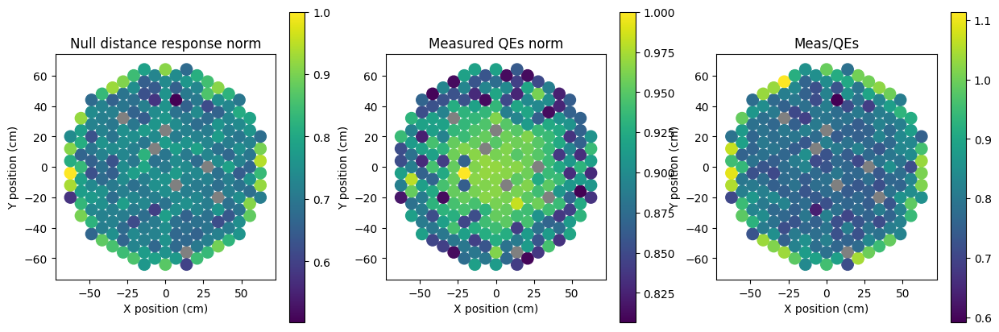

In [164]:
# Response Ratios
rhos = np.zeros(n_pmts)
null_pos_response = (radial_lce.layers[-2].weights[0] * RadialLCELayer.lce_map(RadialLCELayer, rhos,*radial_lce.layers[-3].weights[0][0,0:4])).numpy()
null_pos_response /= null_pos_response.max()

# I dont know if these are in the wrong order
act_qes = [32.2,30.8,28.6,29.7,29.8,32.2,32.1,31.1,31.1,31.1,31.1,31.1,31.1,31.2,32.2,29.6,30.7,33.9,30.2,29.7,32.2,33.2,32.2,30.0,31.2,30.9,28.8,28.5,32.1,31.0,32.6,32.6,32.6,29.8,32.7,32.8,32.8,31.2,33.6,31.3,29.5,32.1,31.2,32.6,33.1,33.1,30.0,33.2,33.2,28.6,32.5,32.2,34.5,32.2,33.2,30.2,32.1,29.6,33.5,33.6,32.8,33.2,33.6,33.6,33.2,30.6,30.5,31.3,30.0,29.4,32.1,30.9,33.2,33.1,33.6,33.8,34.0,33.8,30.4,33.6,32.5,33.2,29.2,30.9,30.0,32.4,30.8,30.6,31.9,33.1,34.6,33.8,34.0,33.9,34.0,35.2,33.6,29.6,32.3,32.3,32.1,33.0,32.1,29.5,33.1,33.7,33.5,33.8,33.9,34.0,34.1,33.9,30.5,33.7,32.8,33.2,29.0,31.4,32.8,29.7,33.0,32.5,33.1,33.9,33.5,34.0,34.1,34.1,34.0,33.9,33.6,31.4,32.2,32.3,32.8,32.5,30.6,32.0,33.5,32.5,33.7,34.0,33.9,33.8,34.0,33.6,33.0,32.9,32.3,32.3,30.0,29.4,28.4,32.0,33.0,33.0,33.6,33.7,33.4,33.9,33.4,33.6,33.3,32.9,31.4,31.4,30.1,30.6,32.0,32.1,29.3,32.5,33.0,33.4,33.7,33.7,33.7,33.2,33.3,32.9,32.8,32.6,30.1,28.5,29.2,32.8,32.0,29.5,33.0,33.4,33.9,33.4,33.4,33.9,32.9,32.3,30.1,30.1,31.5,32.2,29.3,31.5,32.5,33.0,33.0,32.1,31.5,31.3,32.9,28.6,29.2,31.5,28.6,33.0,30.5,29.4,32.5,32.5,30.4,32.4,32.4,29.9,32.4,31.5,30.2,32.3,31.9,30.5,31.9,31.9,28.6,31.6,31.6,29.1,31.6,30.8,30.2,32.3,30.5,30.5,29.1,31.7,33.8,32.4,29.7,28.6,32.3,30.4,29.0,31.3,29.9,28.6,30.3]
act_qes = np.array(act_qes)
act_qes /= act_qes.max()
fig, ax = plt.subplots(1,3, figsize=(15,5))

plot_pmt_response(pmt_pos_top, null_pos_response, ax=ax[0], title='Null distance response norm', dead_pmts=dead_pmts)
plot_pmt_response(pmt_pos_top, act_qes, ax=ax[1], title='Measured QEs norm', dead_pmts=dead_pmts)
plot_pmt_response(pmt_pos_top, null_pos_response / act_qes, ax=ax[2], title='Meas/QEs', dead_pmts=dead_pmts)

In [192]:
new_pos=train_and_update_pos(positions, patterns, radial_lce, n_iter = 10, verbose=1, hist_pos=False)

5768/5768 [==============================] - 5s 809us/step
Jagged iter 0
Epoch 1/20
46/46 [==============================] - 1s 10ms/step - loss: 3.6387 - lr: 0.1000
Epoch 2/20
46/46 [==============================] - 0s 10ms/step - loss: 3.0497 - lr: 0.1000
Epoch 3/20
46/46 [==============================] - 0s 11ms/step - loss: 2.6352 - lr: 0.1000
Epoch 4/20
46/46 [==============================] - 0s 11ms/step - loss: 2.3719 - lr: 0.1000
Epoch 5/20
46/46 [==============================] - 1s 11ms/step - loss: 2.2172 - lr: 0.1000
Epoch 6/20
46/46 [==============================] - 0s 11ms/step - loss: 2.1322 - lr: 0.1000
Epoch 7/20
46/46 [==============================] - 0s 11ms/step - loss: 2.0884 - lr: 0.1000
Epoch 8/20
46/46 [==============================] - 0s 10ms/step - loss: 2.0674 - lr: 0.1000
Epoch 9/20
46/46 [==============================] - 0s 11ms/step - loss: 2.0581 - lr: 0.1000
Epoch 10/20
45/46 [============================>.] - ETA: 0s - loss: 2.0546
Epoch 10: Redu

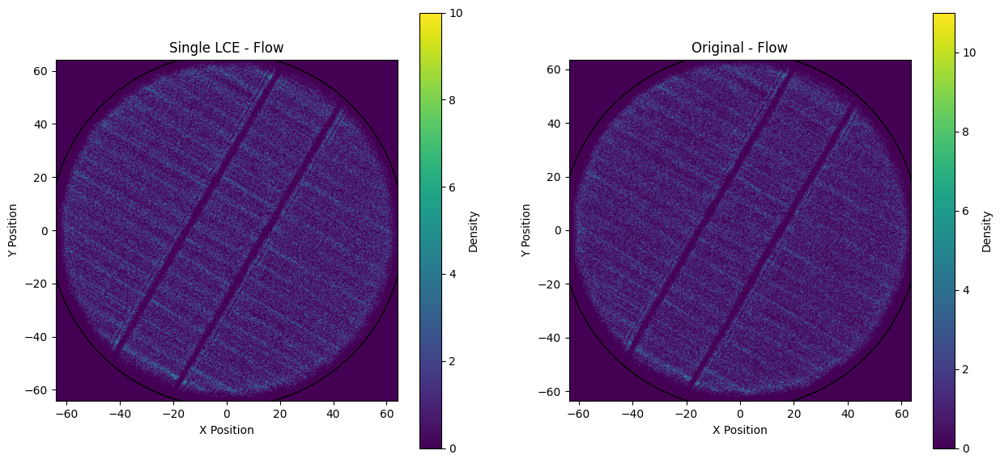

In [193]:
fig, ax = plt.subplots(1,2,figsize=(15,7))


do_density_plot(ax[0],new_pos, title='Single LCE - Flow', bins=500)
do_density_plot(ax[1],positions, title='Original - Flow', bins=500)
circle = plt.Circle((0, 0), tpc_radius, color='black', fill=False)
ax[0].add_patch(circle)
circle = plt.Circle((0, 0), tpc_radius, color='black', fill=False)
ax[1].add_patch(circle)

In [196]:
tmp = keras_loss(patterns, radial_lce.predict(new_pos))
print(np.sort(tmp)[len(tmp)//2])

5768/5768 [==============================] - 5s 816us/step
2.0204282


Text(0.5, 0, 'Orig r')

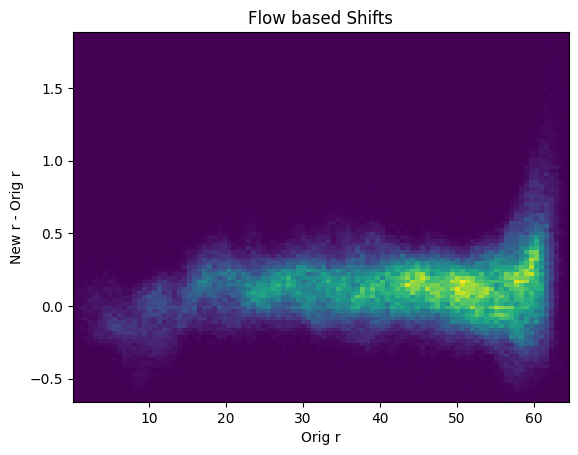

In [199]:
bmap = np.isnan(positions.numpy().sum(axis=-1))
plt.hist2d((positions**2).numpy()[~bmap,:].sum(axis=-1)**(1/2), (new_pos**2).numpy()[~bmap,:].sum(axis=-1)**(1/2)-(positions**2).numpy()[~bmap,:].sum(axis=-1)**(1/2),bins=100)
#plt.yscale('symlog')
plt.title('Flow based Shifts')
plt.ylabel('New r - Orig r')
plt.xlabel("Orig r")

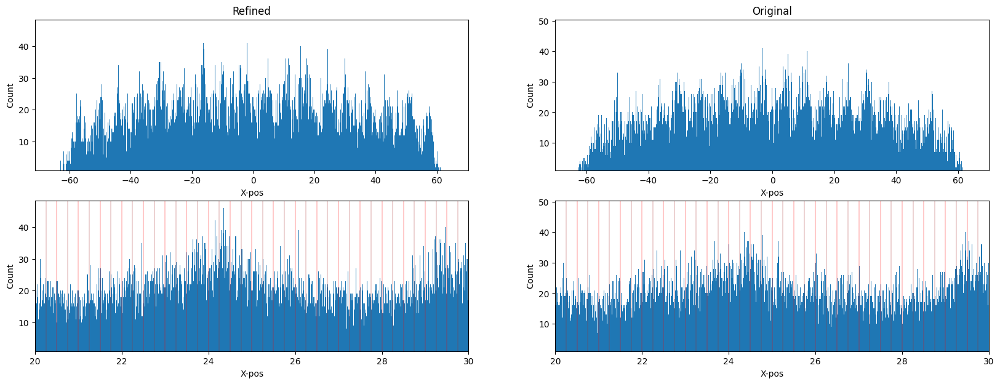

In [207]:
def rotate_and_collapse(positions, axis=None, num_bins=10000):
    """
    Rotates the given positions by 30 degrees, collapses the points to y=0 
    by summing their y-coordinates, and plots the resulting points on the given axis.
    
    Parameters:
        positions (np.ndarray): An array of shape (n_pos, 2) representing the positions.
        axis (matplotlib.axes.Axes, optional): The axis to plot on. If None, a new plot will be created.
    """
    # Convert degrees to radians
    theta = np.radians(30+90)
    
    # Rotation matrix for 30 degrees
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                 [np.sin(theta), np.cos(theta)]])
    
    # Rotate the positions
    rotated_positions = positions @ rotation_matrix.T  # Matrix multiplication
    
    # Create a new figure and axis if none is provided
    if axis is None:
        fig, axis = plt.subplots()

    axis.hist(rotated_positions[:, 0], bins=num_bins)
    # Set labels and title
    axis.set_xlabel('Angle (radians)')
    axis.set_xlabel('X-pos')
    axis.set_ylabel('Count')
    axis.axhline(0, color='gray', lw=0.5, linestyle='--')
    axis
    axis.set_ylim(1)

fig, ax = plt.subplots(2,2, figsize=(20,7))
ax = ax.flatten()
rotate_and_collapse(positions,ax[1])
ax[1].set_title("Original")
#ax[1].set_yscale('log')
rotate_and_collapse(new_pos,ax[0])
#ax[0].set_yscale('log')
ax[0].set_title("Refined")
rotate_and_collapse(positions,ax[3])
ax[3].set_xlim(20, 30)
#ax[3].set_ylim(10, 500)
rotate_and_collapse(new_pos,ax[2])
ax[2].set_xlim(20, 30)
#ax[2].set_ylim(10, 500)
ax[2].vlines([20+(i)*0.5 for i in range(20)], 0, 350, color='red', linewidth=0.3)
ax[2].vlines([20+(i)*0.5+0.25 for i in range(20)], 0, 350, color='brown', linewidth=0.3)
ax[3].vlines([20+(i)*0.5 for i in range(20)], 0, 350, color='red', linewidth=0.3)
ax[3].vlines([20+(i)*0.5+0.25 for i in range(20)], 0, 350, color='brown', linewidth=0.3)

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(7,5))
theta = np.radians(30 + 90)
do_density_plot(ax, positions, title='Source Data', bins=500)

<Axes: title={'center': 'Original Positions'}, xlabel='X Position', ylabel='Y Position'>

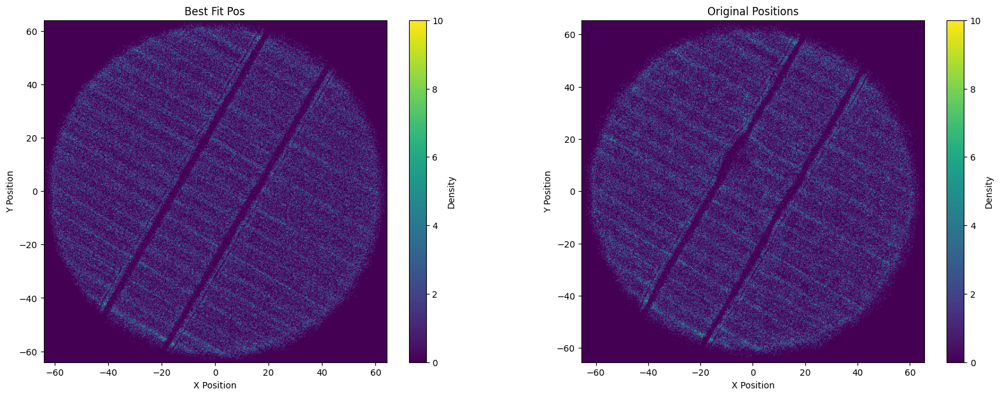

In [136]:
fig, ax = plt.subplots(1,1, figsize=(7,5))
theta = np.radians(30 + 90)
do_density_plot(ax, new_pos, title='Single LCE', bins=500)

<Axes: title={'center': 'Original Positions'}, xlabel='X Position', ylabel='Y Position'>

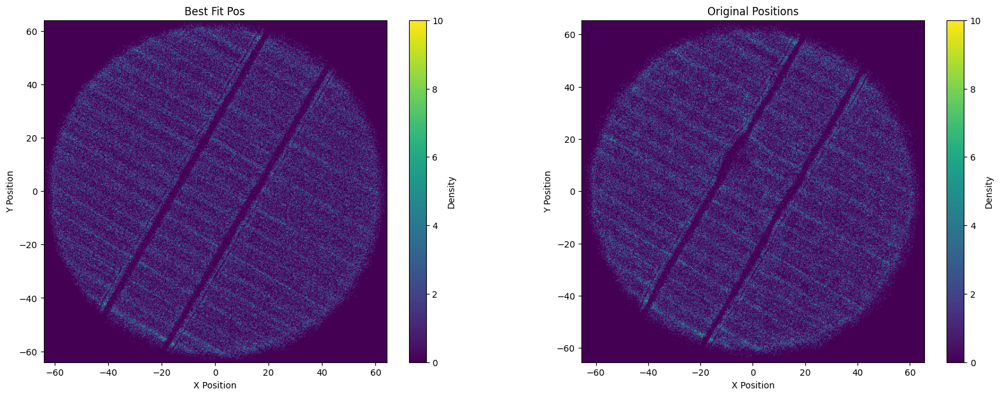

In [ ]:
fig, ax = plt.subplots(1,2, figsize=(20,7))
theta = np.radians(30 + 90)
do_density_plot(ax[0], new_pos, title='Best Fit Pos', bins=500)
do_density_plot(ax[-1], positions,title='Original Positions', bins=500)

In [ ]:
# Check on MC data
"""
Data info https://xe1t-wiki.lngs.infn.it/doku.php?id=xenon:xenonnt:terliuk:posrec_training_patterns_wfsim


"""



C1 is not the same as in the evaluation paper
Refined : c2 : 0.32017899083009677
Refined : c3 : 0.5001130732784647
CNN : c2 : 0.6394489770186965
CNN : c3 : 0.4208907360706483
MLP : c1 : 0.45515397295365867
MLP : c2 : 0.4807403772152887
MLP : c3 : 0.6364588191636988
GCN : c1 : 0.4516511132484053
GCN : c2 : 0.5496178572853462
GCN : c3 : 0.5120973400297818


Text(0, 0.5, 'count')

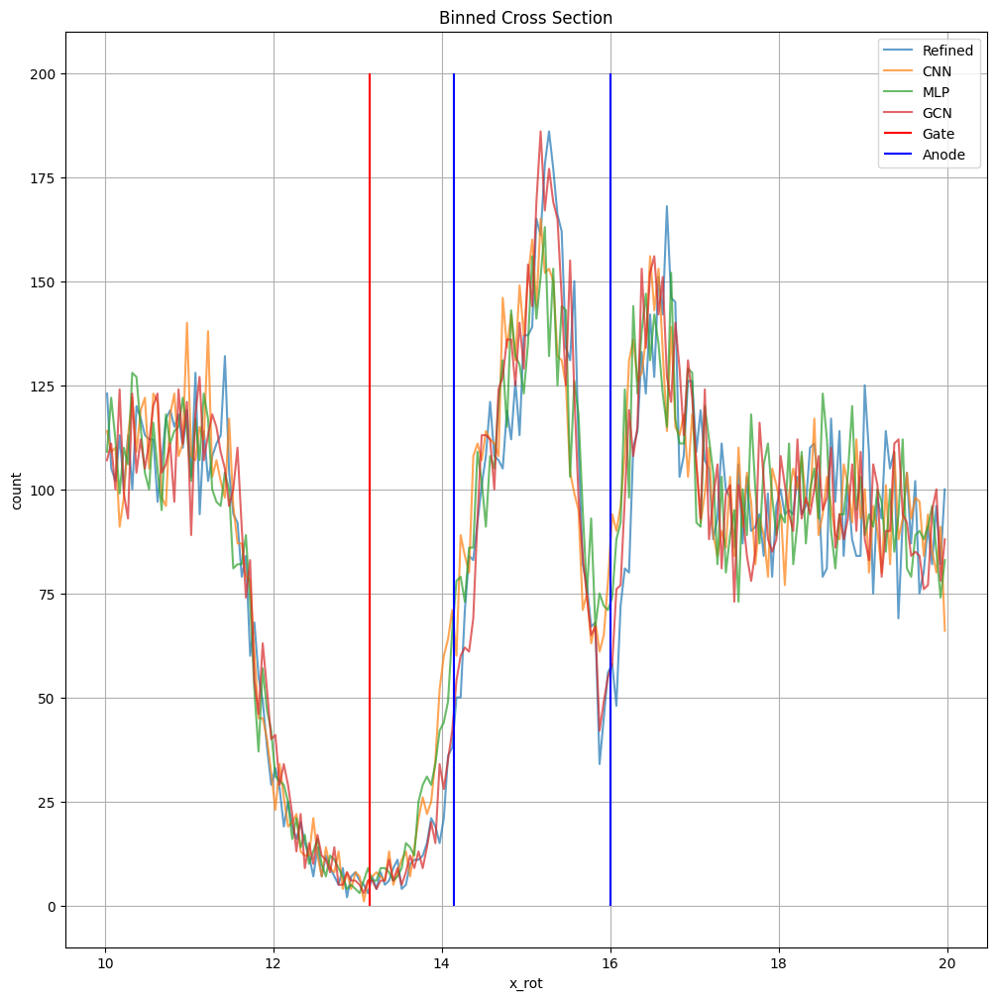

In [197]:
# Position Resolution
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

def gaussian(x, a, b, c, flat):
    """Gaussian function."""
    return a * np.exp(-((x - b) ** 2) / (2 * c ** 2)) + flat

def fit_gaussian(bin_centers, counts, x_range, ax=None):
    """
    Fits a Gaussian to the provided bin centers and counts within a specified x range.
    
    Parameters:
        bin_centers (np.ndarray): The x positions for the histogram bins.
        counts (np.ndarray): The counts corresponding to the bin centers.
        x_range (tuple): A tuple (x_min, x_max) defining the range for fitting.
        ax (matplotlib.axes.Axes, optional): The axis to plot on. If None, a new plot will be created.
    
    Returns:
        popt (np.ndarray): Optimized parameters for the Gaussian fit (a, b, c, flat).
        pcov (np.ndarray): The covariance matrix for the fitted parameters.
    """
    # Filter the data based on the specified x range
    mask = (bin_centers >= x_range[0]) & (bin_centers <= x_range[1])
    filtered_centers = bin_centers[mask]
    filtered_counts = counts[mask]
    
    b_initial = (x_range[0] + x_range[1]) / 2  # Set b in the middle of the x range
    initial_guess = [np.max(filtered_counts), b_initial, 1.0, np.min(filtered_counts)]
    
    # Set bounds for parameters: a > 0, c > 0, flat, and constrain b
    bounds = (0, [np.inf, x_range[1], np.inf, np.inf])  # Constrain b to be <= x_max

    # Perform the curve fitting
    popt, pcov = curve_fit(gaussian, filtered_centers, filtered_counts, p0=initial_guess, bounds=bounds)

    # Create the fitted curve
    x_fit = np.linspace(x_range[0], x_range[1], 100)
    y_fit = gaussian(x_fit, *popt)

    return popt, pcov  # Return the optimized parameters and covariance matrix


theta = np.radians(30)

fig, ax= plt.subplots(1,1,figsize=(12,12))
# Rotation matrix for 30 degrees
rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                [np.sin(theta), np.cos(theta)]])
pos_sets = (new_pos, np.stack([ei['s2_x_cnn'], ei['s2_y_cnn']],axis = -1), np.stack([ei['s2_x_mlp'], ei['s2_y_mlp']],axis = -1), np.stack([ei['s2_x_gcn'], ei['s2_y_gcn']],axis = -1))
num_bins = 200
labels = ['Refined', 'CNN', 'MLP', 'GCN']

print("C1 is not the same as in the evaluation paper")
for idx in range(len(pos_sets)):
    x_coordinates = (pos_sets[idx] @ rotation_matrix.T)[:, 0]
    x_coordinates = x_coordinates[(x_coordinates < 20) & (x_coordinates > 10)]
    x_min, x_max = np.min(x_coordinates), np.max(x_coordinates)
    x_bins = np.linspace(x_min, x_max, num_bins + 1) 
    counts, _ = np.histogram(x_coordinates, bins=x_bins)
    bin_centers = (x_bins[:-1] + x_bins[1:]) / 2
    ax.plot(bin_centers, counts, label= labels[idx], alpha = 0.7)
    try:
        popt, pcov = fit_gaussian(bin_centers, counts, x_range=(11,14.15))
        print("{} : c1 : {}".format(labels[idx], (popt[-2])))
    except:
        pass
    try:
        popt, pcov = fit_gaussian(bin_centers, counts, x_range=(14.15, 15.9))
        print("{} : c2 : {}".format(labels[idx], (popt[-2])))
    except:
        pass
    try:
        popt, pcov = fit_gaussian(bin_centers, counts, x_range=(15.9, 17.2))
        print("{} : c3 : {}".format(labels[idx], (popt[-2])))
    except:
        pass


ax.vlines([13.15], 0, 200, label='Gate', color='red') #  14.1, 15.9
ax.vlines([14.15, 16], 0, 200, label='Anode', color = 'blue') #  
ax.legend()
ax.grid()
ax.set_title("Binned Cross Section")
ax.set_xlabel('x_rot')
ax.set_ylabel('count')

In [194]:
import numpy as np

def gate_wires(x, op):
    return op(np.sqrt(3) * x * 10, 263) / 10

def anode_wires(x, op, which):
    return op(np.sqrt(3) * x * 10, 318 if which == 0 else 283) / 10

# Operation function
def op_plus(value, offset):
    return value + offset

# Rotate the point
def rotate_point(x, y, angle):
    # Convert angle to radians
    theta = np.radians(angle)
    
    # Rotation matrix
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                 [np.sin(theta), np.cos(theta)]])
    
    # Original point
    original_point = np.array([x, y])
    
    # Rotated point
    rotated_point = rotation_matrix @ original_point
    return rotated_point

# Evaluate wires for a range of x values
x_values = np.linspace(-1, 1, 5)  # Change the range and number of points as needed

# Store results
results = []

# Evaluate gate wires
for x in x_values:
    y_gate = gate_wires(x, op_plus)
    rotated_gate = rotate_point(x, y_gate, 30)
    results.append(('Gate Wire', x, y_gate, rotated_gate))

# Evaluate anode wires for both configurations
for which in [0, 1]:
    for x in x_values:
        y_anode = anode_wires(x, op_plus, which)
        rotated_anode = rotate_point(x, y_anode, 30)
        results.append((f'Anode Wire {which}', x, y_anode, rotated_anode))

# Print results
for wire_type, x, y, rotated in results:
    print(f"{wire_type}: x = {x:.4f}, y = {y:.4f} -> Rotated: x' = {rotated[0]:.4f}, y' = {rotated[1]:.4f}")


Gate Wire: x = -1.0000, y = 24.5679 -> Rotated: x' = -13.1500, y' = 20.7765
Gate Wire: x = -0.5000, y = 25.4340 -> Rotated: x' = -13.1500, y' = 21.7765
Gate Wire: x = 0.0000, y = 26.3000 -> Rotated: x' = -13.1500, y' = 22.7765
Gate Wire: x = 0.5000, y = 27.1660 -> Rotated: x' = -13.1500, y' = 23.7765
Gate Wire: x = 1.0000, y = 28.0321 -> Rotated: x' = -13.1500, y' = 24.7765
Anode Wire 0: x = -1.0000, y = 30.0679 -> Rotated: x' = -15.9000, y' = 25.5396
Anode Wire 0: x = -0.5000, y = 30.9340 -> Rotated: x' = -15.9000, y' = 26.5396
Anode Wire 0: x = 0.0000, y = 31.8000 -> Rotated: x' = -15.9000, y' = 27.5396
Anode Wire 0: x = 0.5000, y = 32.6660 -> Rotated: x' = -15.9000, y' = 28.5396
Anode Wire 0: x = 1.0000, y = 33.5321 -> Rotated: x' = -15.9000, y' = 29.5396
Anode Wire 1: x = -1.0000, y = 26.5679 -> Rotated: x' = -14.1500, y' = 22.5085
Anode Wire 1: x = -0.5000, y = 27.4340 -> Rotated: x' = -14.1500, y' = 23.5085
Anode Wire 1: x = 0.0000, y = 28.3000 -> Rotated: x' = -14.1500, y' = 24.

### Next N-pmts

Using Models 0, 3, 4 == Jelles, pd-Search 1 & 2 -> Optimized PD values 

In [230]:
npmt_pd = np.array([ 1.6242546e+00,  9.4928885e+00, -3.8433252e-05,  7.8334948e-03, 7.5530492e-02])

Epoch 1/100
577/577 [==============================] - 31s 53ms/step - loss: 2.1340 - val_loss: 2.0647 - lr: 5.0000e-05
Epoch 2/100
577/577 [==============================] - 30s 52ms/step - loss: 2.0706 - val_loss: 2.0680 - lr: 5.0000e-05
Epoch 3/100
576/577 [============================>.] - ETA: 0s - loss: 2.0688
Epoch 3: ReduceLROnPlateau reducing learning rate to 1.249999968422344e-05.
577/577 [==============================] - 30s 52ms/step - loss: 2.0687 - val_loss: 2.0631 - lr: 5.0000e-05
Epoch 4/100
577/577 [==============================] - 30s 51ms/step - loss: 2.0446 - val_loss: 2.0436 - lr: 1.2500e-05
Epoch 5/100
577/577 [==============================] - ETA: 0s - loss: 2.0448
Epoch 5: ReduceLROnPlateau reducing learning rate to 3.12499992105586e-06.
577/577 [==============================] - 30s 52ms/step - loss: 2.0448 - val_loss: 2.0440 - lr: 1.2500e-05
Epoch 6/100
577/577 [==============================] - 30s 52ms/step - loss: 2.0389 - val_loss: 2.0381 - lr: 3.1250e-

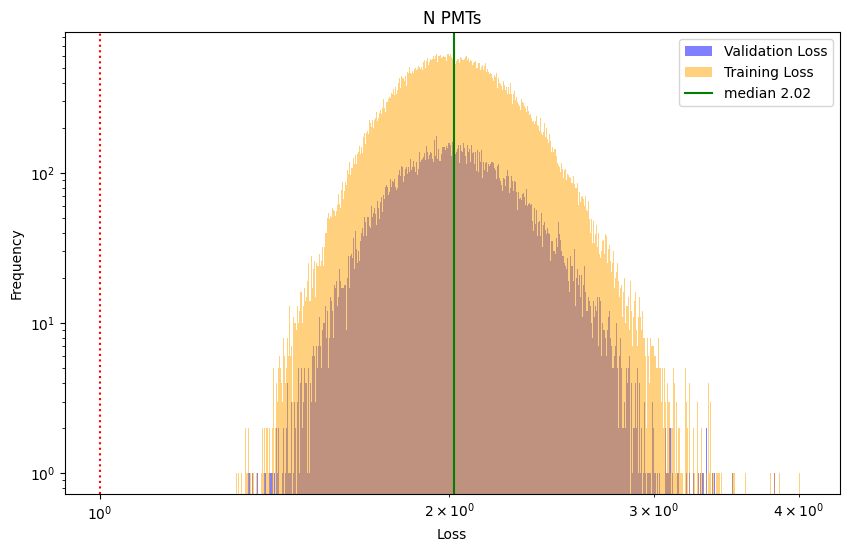

In [232]:
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,        
    restore_best_weights=True,
    min_delta=0.02,
    mode='min',    
    verbose=1      
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    mode = 'min',
    restore_best_weights=True,
    factor=0.25,           
    patience=2,            
    min_delta=0.03,        
    min_lr=1e-8,           
    verbose=1              
)

x_train = tensorflow.gather(positions, train_slice, axis=0)
y_train = tensorflow.gather(patterns, train_slice, axis=0)
val = (tensorflow.gather(positions, val_slice, axis=0), tensorflow.gather(patterns, val_slice, axis=0))

radial_lce = get_RLCEModel(pmt_pos_top[:,2:],n_pmts=n_pmts, n_groups=n_pmts, group_slices=np.arange(n_pmts).reshape(-1,1), 
                        I0_init=I0_init_from_ULCE, guess = npmt_pd.tolist())
radial_lce.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=5e-5))
radial_lce.fit(x = x_train, y = y_train, 
            validation_data=val,
            epochs = 100, batch_size = 2**8, 
            callbacks=[early_stopping, reduce_lr])
val_loss, train_loss = plot_loss_histogram(radial_lce, (x_train, y_train), val, ax=None, loss_func=keras_loss, bins=1000,
                        title= "N PMTs")


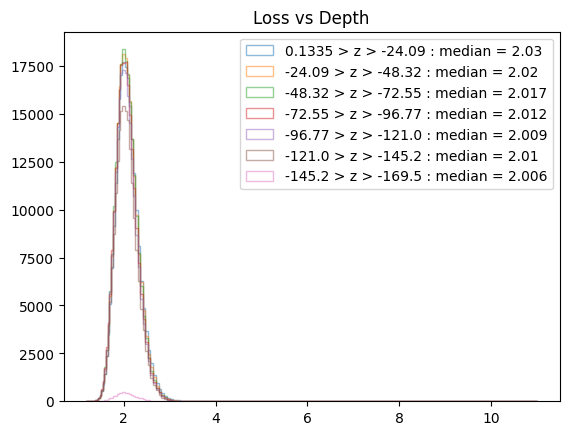

In [ ]:
# For full dataset
loss = keras_loss(patterns, radial_lce.predict(positions))
hist, bins_ = np.histogram(loss, bins=100)
logbins = np.logspace(np.log10(bins_[0]),np.log10(bins_[-1]),len(bins_))
prev = ei['z'].max()
interv = (ei['z'].min() - prev) / 10
for i in range(10):
    try:
        sub = loss[(ei['z'] > ((i+1)*interv + prev)) & (((i)*interv + prev) > ei['z'])]
        median = np.sort(sub)[len(sub)//2]
        plt.hist(sub, bins=logbins,histtype='step', alpha=0.5, label='{:.4} > z > {:.4} : median = {:.4}'.format(((i)*interv + prev),((i+1)*interv + prev), median))
    except:
        pass
plt.title("Loss vs Depth")
plt.legend()

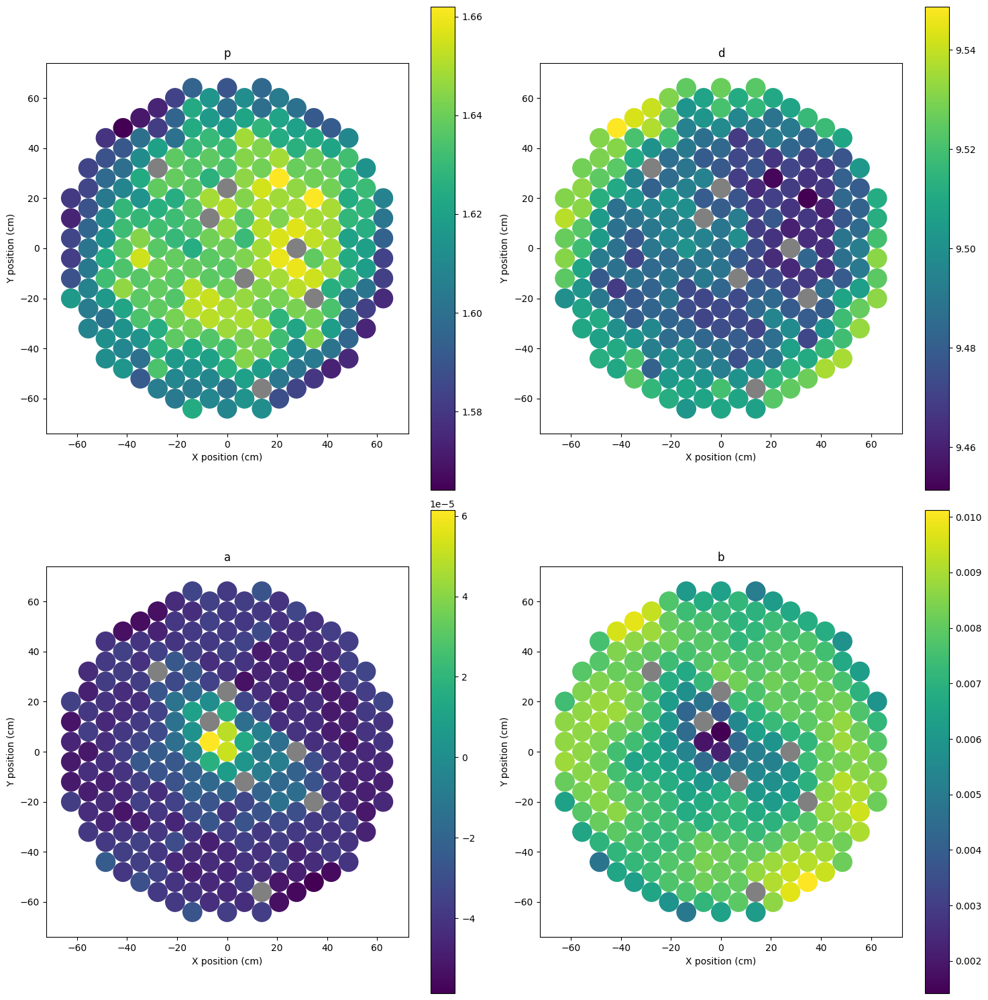

In [235]:
titles = ['p', 'd', 'a', 'b']
fig, ax = plt.subplots(2,2, figsize=(15,15))
ax = ax.flatten()
for i in range(4):
    plot_pmt_response(pmt_pos_top, radial_lce.get_layer('radial_lce').weights[0][:,i].numpy(), ax = ax[i], title=titles[i], vmin=None, vmax=None, logscale=False, dead_pmts = dead_pmts, mark_spot=None, )
#plot_pmt_response(pmt_pos_top, radial_lce.get_layer('QE_Layer').weights[0].numpy(), ax = ax[-1], title='I0', vmin=None, vmax=None, logscale=False, dead_pmts = dead_pmts, mark_spot=None, )
plt.tight_layout()

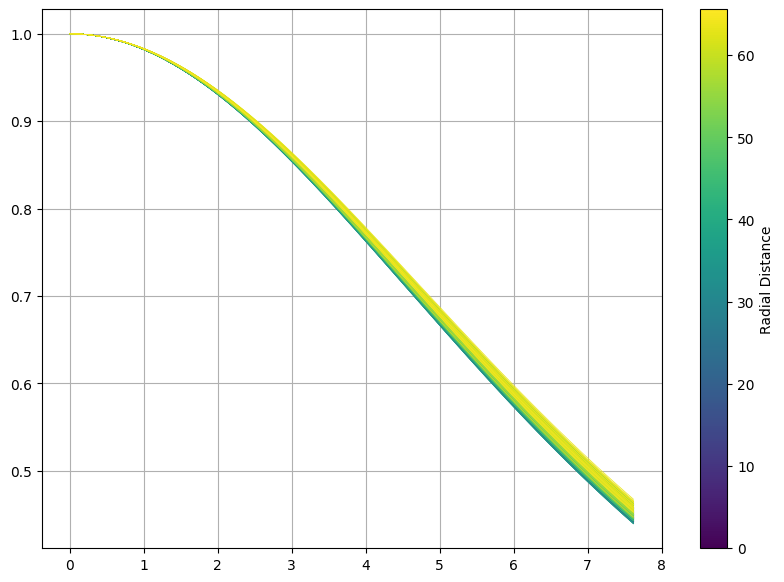

In [238]:
fig, ax = plt.subplots(1,1, figsize=(10,7))
import matplotlib.cm as cm
rho = np.linspace(0,2*pmt_radius,1000, dtype='float32')
distances = np.sqrt(np.sum(pmt_pos_top[:, -2:].astype('float')**2, axis=1))
norm = plt.Normalize(distances.min(), distances.max())
colors = cm.viridis(norm(distances))  # Using the viridis colormap
ax.grid()
for i in not_dead_pmts:
    tmp = RadialLCELayer.lce_map(RadialLCELayer, rho, *radial_lce.get_layer('radial_lce').weights[0][i,:].numpy()).numpy()
    ax.plot(rho, tmp/tmp.max(axis=-1), c = colors[i], lw=0.5)

plt.colorbar(cm.ScalarMappable(norm=norm, cmap='viridis'), ax=ax, label='Radial Distance')
plt.show()

In [99]:
def train_and_update_pos(positions, patterns, model, n_iter = 5, verbose=0, hist_pos=False,lr=0.1, embeddings_constraint = []):
    early_stopping = tensorflow.keras.callbacks.EarlyStopping(
        monitor='loss',
        restore_best_weights=True,
        patience=5,     # 5
        min_delta=0.05,
        mode='min',    
        verbose=1      
    )
    reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
        monitor='loss', 
        mode = 'min',
        factor=0.5,     
        patience=2,      # 2
        min_delta=0.05, 
        min_lr=1e-3,    
        verbose=1       
    )
    n_tot = len(positions)
    pos_updater = get_position_updater(positions, n_tot, model ,input_len = 1, embeddings_constraint=embeddings_constraint)
    # Inspecting the degree of change
    if hist_pos:
        trained_pos = []

    new_pos = tensorflow.identity(positions)
    loss    = keras_loss(patterns, model.predict(positions))
    for i in range(n_iter):
        print("Jagged iter {}".format(i))
        # tensorflow_probability requires tensorflow >= 2.16 we have == 2.15
        # Random dist gives max deviation root{2}*pmt_radius (~70% of diameter)
        noise_pos = tensorflow.identity(positions) + np.random.rand(*new_pos.numpy().shape) * pmt_radius
        # Update and fit encoder model positions
        pos_updater.get_layer('embed_pos').set_weights([noise_pos])
        # Compile and fit
        pos_updater.compile(loss= keras_loss, optimizer = keras.optimizers.Adam(learning_rate=lr))
        pos_updater.fit(x = np.arange(n_tot), y = patterns, 
                        epochs = 50, batch_size = 2**10,
                        callbacks=[early_stopping,reduce_lr], verbose = verbose) 
        noise_pos = pos_updater.get_layer('embed_pos').get_weights()[0]
        # Check result of new pos
        jittered_loss = keras_loss(patterns, model.predict(noise_pos, verbose=verbose))

        better = jittered_loss < loss
        loss =    tensorflow.where(better, jittered_loss, loss) 
        new_pos = tensorflow.where(tensorflow.expand_dims(better, axis=-1), noise_pos, new_pos) 
        if hist_pos:
            trained_pos.append(noise_pos)

    if not hist_pos:
        return new_pos
    else:
        return new_pos, trained_pos

In [100]:
new_pos=train_and_update_pos(positions, patterns, radial_lce, n_iter = 4, verbose=1, hist_pos=False)

5768/5768 [==============================] - 50s 9ms/step
Jagged iter 0
Epoch 1/50
181/181 [==============================] - 13s 71ms/step - loss: 3.6089 - lr: 0.1000
Epoch 2/50
181/181 [==============================] - 13s 72ms/step - loss: 2.7536 - lr: 0.1000
Epoch 3/50
181/181 [==============================] - 13s 71ms/step - loss: 2.2734 - lr: 0.1000
Epoch 4/50
181/181 [==============================] - 13s 72ms/step - loss: 2.1056 - lr: 0.1000
Epoch 5/50
181/181 [==============================] - 13s 71ms/step - loss: 2.0696 - lr: 0.1000
Epoch 6/50
180/181 [============================>.] - ETA: 0s - loss: 2.0725
Epoch 6: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
181/181 [==============================] - 13s 71ms/step - loss: 2.0725 - lr: 0.1000
Epoch 7/50
181/181 [==============================] - 13s 71ms/step - loss: 2.0767 - lr: 0.0500
Epoch 8/50
181/181 [==============================] - 13s 71ms/step - loss: 2.0230 - lr: 0.0500
Epoch 9/50
181/181 [

<Axes: title={'center': 'Original Positions'}, xlabel='X Position', ylabel='Y Position'>

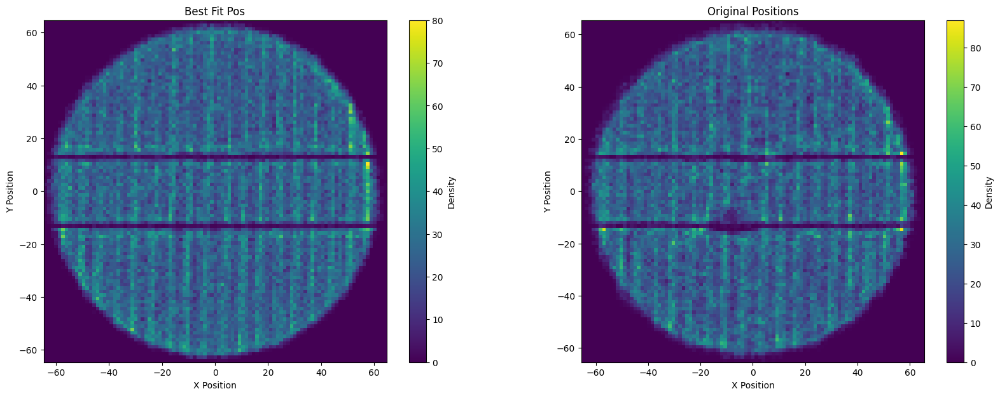

In [101]:
fig, ax = plt.subplots(1,2, figsize=(20,7))
theta = np.radians(30 + 90)
rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                [np.sin(theta), np.cos(theta)]])
do_density_plot(ax[0], new_pos @ rotation_matrix.T, title='Best Fit Pos')
do_density_plot(ax[-1], positions @ rotation_matrix.T,title='Original Positions')

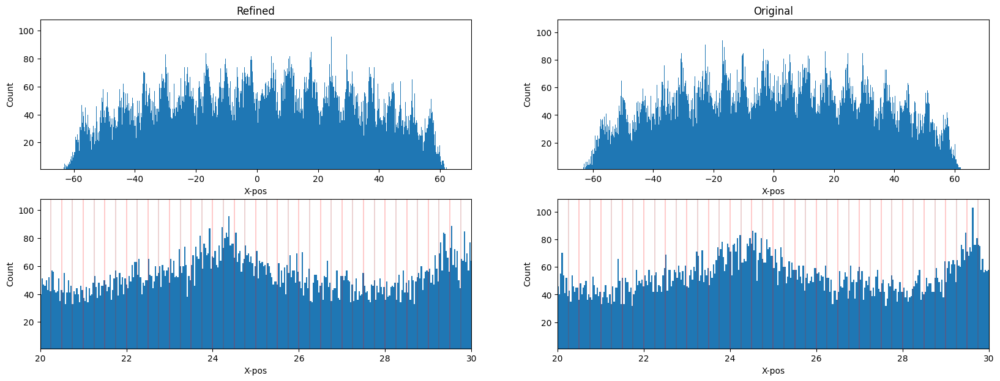

In [106]:
def rotate_and_collapse(positions, axis=None, num_bins=4000):
    """
    Rotates the given positions by 30 degrees, collapses the points to y=0 
    by summing their y-coordinates, and plots the resulting points on the given axis.
    
    Parameters:
        positions (np.ndarray): An array of shape (n_pos, 2) representing the positions.
        axis (matplotlib.axes.Axes, optional): The axis to plot on. If None, a new plot will be created.
    """
    # Convert degrees to radians
    theta = np.radians(30+90)
    
    # Rotation matrix for 30 degrees
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                 [np.sin(theta), np.cos(theta)]])
    
    # Rotate the positions
    rotated_positions = positions @ rotation_matrix.T  # Matrix multiplication

    # Create a new figure and axis if none is provided
    if axis is None:
        fig, axis = plt.subplots()

    axis.hist(rotated_positions[:, 0], bins=num_bins)
    # Set labels and title
    axis.set_xlabel('Angle (radians)')
    axis.set_xlabel('X-pos')
    axis.set_ylabel('Count')
    axis.axhline(0, color='gray', lw=0.5, linestyle='--')
    axis
    axis.set_ylim(1)

fig, ax = plt.subplots(2,2, figsize=(20,7))
ax = ax.flatten()
rotate_and_collapse(positions,ax[1])
ax[1].set_title("Original")
#ax[1].set_yscale('log')
rotate_and_collapse(new_pos,ax[0])
#ax[0].set_yscale('log')
ax[0].set_title("Refined")
rotate_and_collapse(positions,ax[3])
ax[3].set_xlim(20, 30)
#ax[3].set_ylim(10, 500)
rotate_and_collapse(new_pos,ax[2])
ax[2].set_xlim(20, 30)
#ax[2].set_ylim(10, 500)
ax[2].vlines([20+(i)*0.5 for i in range(20)], 0, 350, color='red', linewidth=0.3)
ax[2].vlines([20+(i)*0.5+0.25 for i in range(20)], 0, 350, color='brown', linewidth=0.3)
ax[3].vlines([20+(i)*0.5 for i in range(20)], 0, 350, color='red', linewidth=0.3)
ax[3].vlines([20+(i)*0.5+0.25 for i in range(20)], 0, 350, color='brown', linewidth=0.3)

Text(0, 0.5, 'Shift')

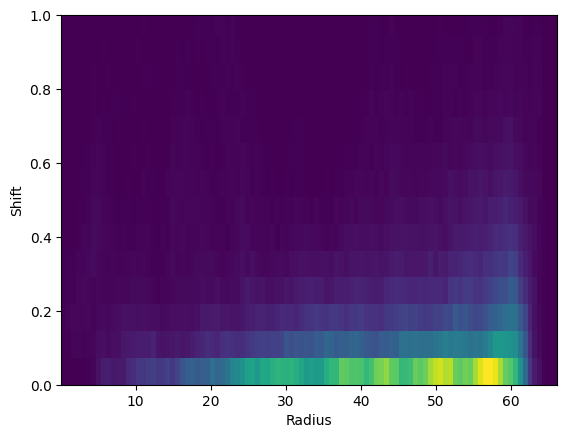

In [38]:
radii = (positions**2).numpy().sum(axis=-1)**(1/2)
differences = ((new_pos - positions)**2).numpy().sum(axis=-1)
plt.hist2d(radii, differences, bins = 100)
plt.ylim(0,1)
plt.xlabel('Radius')
plt.ylabel('Shift')

Text(0.5, 0, 'Pos Shift')

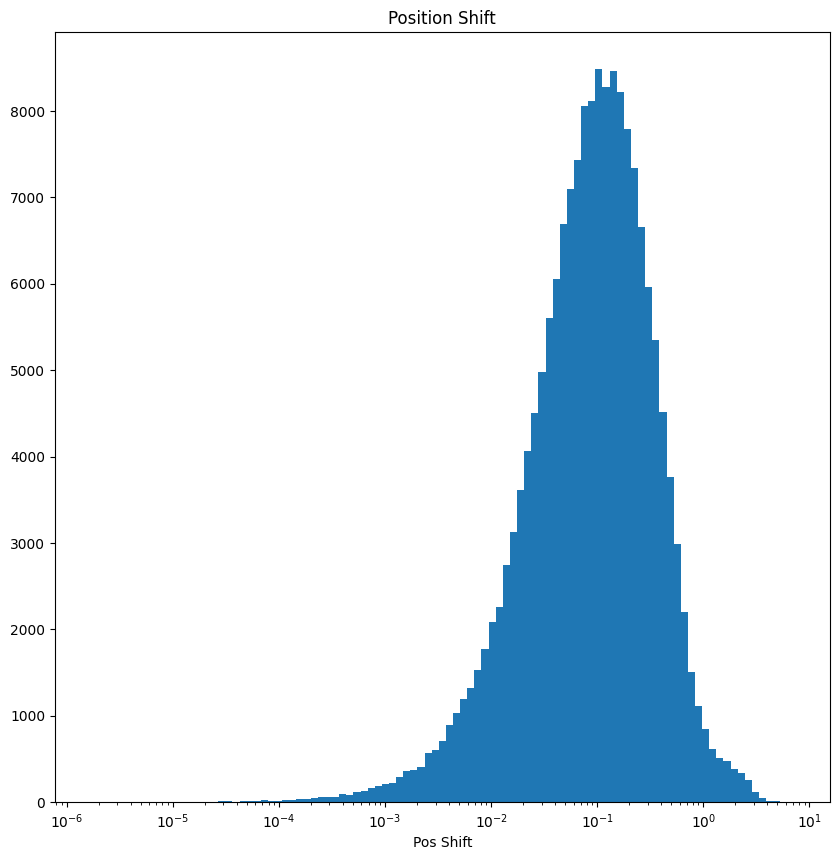

In [32]:
fig, ax = plt.subplots(1,1, figsize=(10,10))
differences = ((new_pos - positions)**2).numpy().sum(axis=-1)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
ax.hist(differences, bins=bins)
ax.set_title("Position Shift")
ax.set_xscale('log')
ax.set_xlabel("Pos Shift")

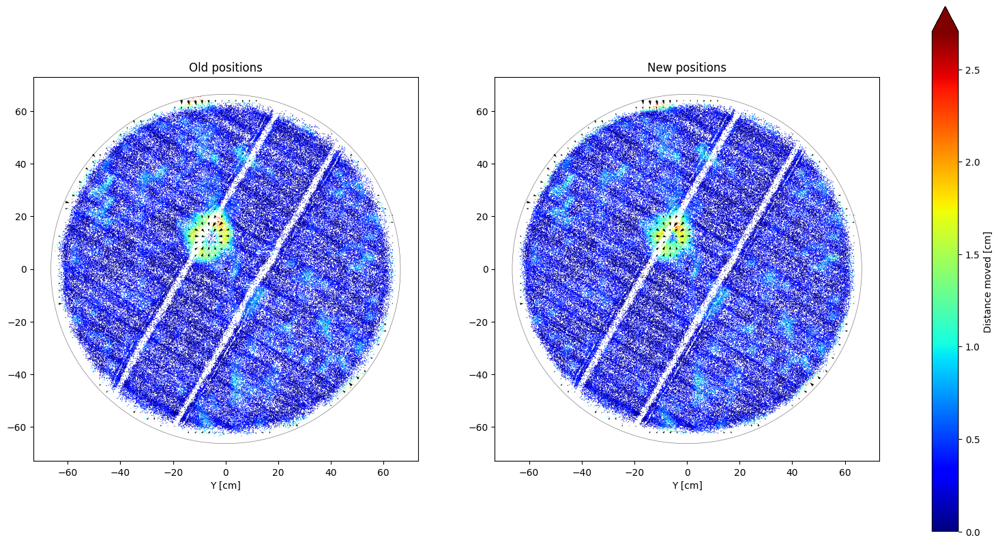

Mean:  2.0210276
Median:  1.9981977


In [108]:
pos_diff_plot(positions, new_pos,pmt_pos,dead_pmts=dead_pmts,max_r=tpc_radius, vmax=None, s=0.7, dpi=200, save=None)
loss = keras_loss(patterns, radial_lce.predict(new_pos, verbose=0)).numpy()
print("Mean: ", loss.mean())
print("Median: ", np.sort(loss)[len(loss) //2])
new_pos_norm_start = new_pos

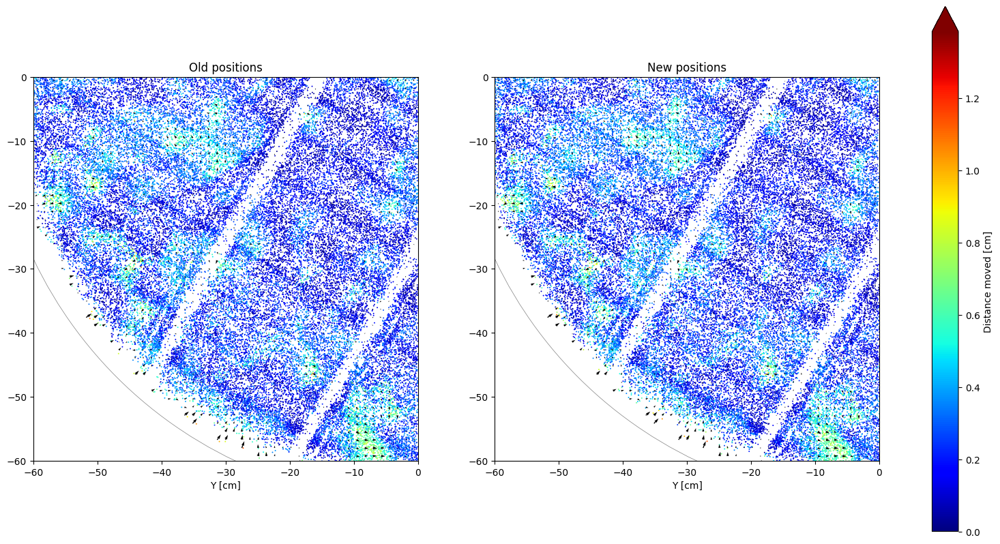

In [122]:
pos_diff_plot(positions[(positions[:,0] < 0) & (positions[:,1] < 0)], 
              new_pos[(positions[:,0] < 0) & (positions[:,1] < 0)],pmt_pos,dead_pmts=dead_pmts,max_r=tpc_radius, vmax=None, s=2, dpi=200, save=None,
              xlim=(-60,0),ylim=(-60,0))

1/1 [==============================] - 0s 17ms/step


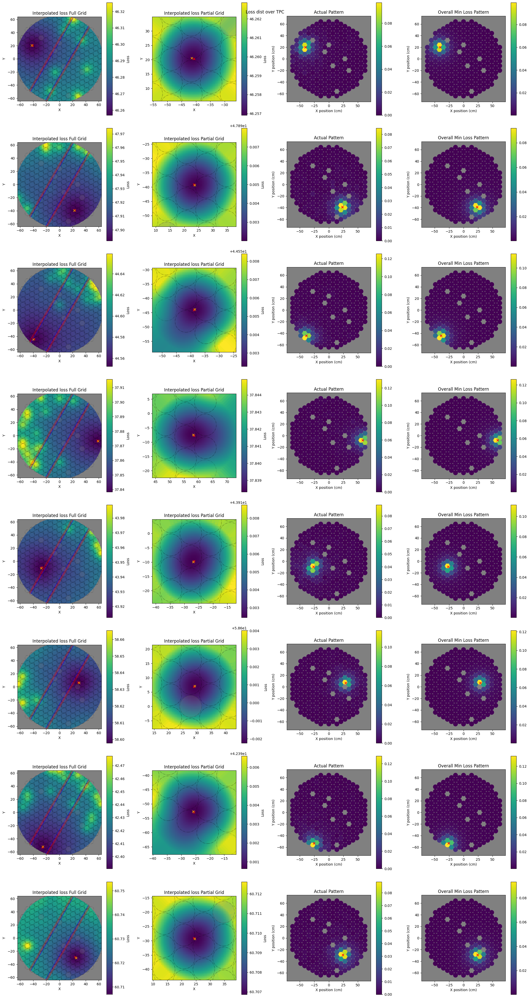

In [254]:
# Quick Verification of local minima
fig, ax = plt.subplots(8,4, figsize=(21, 40))
fig.suptitle("Loss dist over TPC")

# Median 3.04 - with new loss (no divisor but times 100) 0.2933137 
model = radial_lce 

# rndm, rndm, gatel, gater , anode l i, anode l o, anode r i, anode r o
events = [19173, 28308, 23354, 48903, 12561, 3935,   18618,     3622] 
for i in range(len(events)):
    test_event = events[i]
    tpc_pointsf = np.array(get_circular_grid((0,0), tpc_radius, n_pmts * 10))
    tpc_pointsp = np.array(get_circular_grid(positions[test_event, :].numpy(), 4*pmt_radius, n_pmts * 10))
    loss_fgrid = keras_loss(model.predict(tpc_pointsf), np.tile(patterns[test_event], (len(tpc_pointsf), 1)))
    loss_pgrid = keras_loss(model.predict(tpc_pointsp), np.tile(patterns[test_event], (len(tpc_pointsp), 1)))
    ax[i,0].set_facecolor('gray')
    ax[i,1].set_facecolor('gray')
    ax[i,2].set_facecolor('gray')
    ax[i,3].set_facecolor('gray')
    posminloss1, loss1 = plot_interpolated_cmap(tpc_pointsf, loss_fgrid, (0,0), tpc_radius, ax=ax[i,0], title = "Interpolated loss Full Grid" ,mark_spot = positions[test_event])
    plot_anode_gate(tpc_radius, ax=ax[i,0])
    plot_pmt_circles(ax[i,0], pmt_pos, dead_pmts, alpha=0.2, linestyle='-.')
    posminloss2, loss2 = plot_interpolated_cmap(tpc_pointsp, loss_pgrid, patterns[test_event], tpc_radius*100, ax=ax[i,1], title = "Interpolated loss Partial Grid" ,mark_spot = positions[test_event])
    plot_pmt_circles(ax[i,1], pmt_pos, dead_pmts, alpha=0.2, linestyle='-.')
    plot_pmt_response(pmt_pos=pmt_pos_top,response=patterns[test_event].numpy() / np.sum(patterns[test_event].numpy()), ax=ax[i,2], title="Actual Pattern", dead_pmts=dead_pmts, mark_spot=positions[test_event])
    idx = np.argmin([loss1,loss2])
    tmp = model.predict(np.array([[posminloss1,posminloss2][idx]]))[0]
    plot_pmt_response(pmt_pos=pmt_pos_top,response=tmp, ax=ax[i,3], title="Overall Min Loss Pattern", dead_pmts=dead_pmts, mark_spot=positions[test_event])
plt.tight_layout()
plt.show()

### Neural LCE

In [265]:
neural_lce = get_neural_LCE(n_pmts=not_dead_pmts.shape[0], 
                            pmt_pos=pmt_pos_top[not_dead_pmts,2:], 
                            I0_init=I0_init_from_ULCE, 
                            activation ='relu', 
                            final_activation='sigmoid')
neural_lce.summary()

Model: "neural_lce"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_28 (InputLayer)       [(None, 2)]               0         
                                                                 
 xy_to_pmt_coords (Sequenti  (None, 246, 6)            492       
 al)                                                             
                                                                 
 conv1d (Conv1D)             (None, 246, 60)           420       
                                                                 
 conv1d_1 (Conv1D)           (None, 246, 30)           1830      
                                                                 
 conv1d_2 (Conv1D)           (None, 246, 15)           465       
                                                                 
 conv1d_3 (Conv1D)           (None, 246, 15)           240       
                                                        

In [267]:

x_train, y_train, val = split_data(positions, patterns, train_slice, val_slice)
y_train = y_train.numpy()[:,not_dead_pmts]
val = (val[0],val[1].numpy()[:,not_dead_pmts])
early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,        
    restore_best_weights=True,
    min_delta=0.02,
    mode='min',    
    verbose=1      
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    mode = 'min',
    restore_best_weights=True,
    factor=0.25,           
    patience=2,            
    min_delta=0.03,        
    min_lr=1e-8,           
    verbose=1              
)

neural_lce.compile(loss= keras_loss_no_filter, optimizer = keras.optimizers.Adam(learning_rate=5e-1))

neural_lce.fit(x = x_train, y = y_train, 
            validation_data=val,
            epochs = 100, batch_size = 2**8, 
            callbacks=[early_stopping, reduce_lr])
val_loss, train_loss = plot_loss_histogram(neural_lce, (x_train, y_train), val, ax=None, loss_func=keras_loss_no_filter, bins=1000,
                        title= "NN")

Epoch 1/100
 56/577 [=>............................] - ETA: 7s - loss: nan

2024-11-11 10:44:37.834413: E external/local_xla/xla/stream_executor/stream_executor_internal.h:177] SetPriority unimplemented for this stream.


577/577 [==============================] - 8s 12ms/step - loss: nan - val_loss: nan - lr: 0.5000
Epoch 2/100
575/577 [============================>.] - ETA: 0s - loss: nan
Epoch 2: ReduceLROnPlateau reducing learning rate to 0.125.
577/577 [==============================] - 6s 10ms/step - loss: nan - val_loss: nan - lr: 0.5000
Epoch 3/100
329/577 [================>.............] - ETA: 2s - loss: nan

KeyboardInterrupt: 

#### NN Changing Inputs

In [ ]:
# Check Weights of inputs and see
nn_pos=train_and_update_pos(new_pos, patterns, neural_lce, n_iter = 4, verbose=1, hist_pos=False)

17303/17303 [==============================] - 36s 2ms/step
Jagged iter 0
Epoch 1/50
136/136 [==============================] - 19s 140ms/step - loss: 3.5738 - lr: 0.1000
Epoch 2/50
136/136 [==============================] - 19s 141ms/step - loss: 2.7826 - lr: 0.1000
Epoch 3/50
136/136 [==============================] - 19s 141ms/step - loss: 2.3023 - lr: 0.1000
Epoch 4/50
136/136 [==============================] - 19s 142ms/step - loss: 2.0979 - lr: 0.1000
Epoch 5/50
136/136 [==============================] - 19s 143ms/step - loss: 2.0312 - lr: 0.1000
Epoch 6/50
136/136 [==============================] - 19s 141ms/step - loss: 2.0169 - lr: 0.1000
Epoch 7/50
135/136 [============================>.] - ETA: 0s - loss: 2.0181
Epoch 7: ReduceLROnPlateau reducing learning rate to 0.05000000074505806.
136/136 [==============================] - 19s 143ms/step - loss: 2.0181 - lr: 0.1000
Epoch 8/50
136/136 [==============================] - 19s 143ms/step - loss: 2.0181 - lr: 0.0500
Epoch 9/50

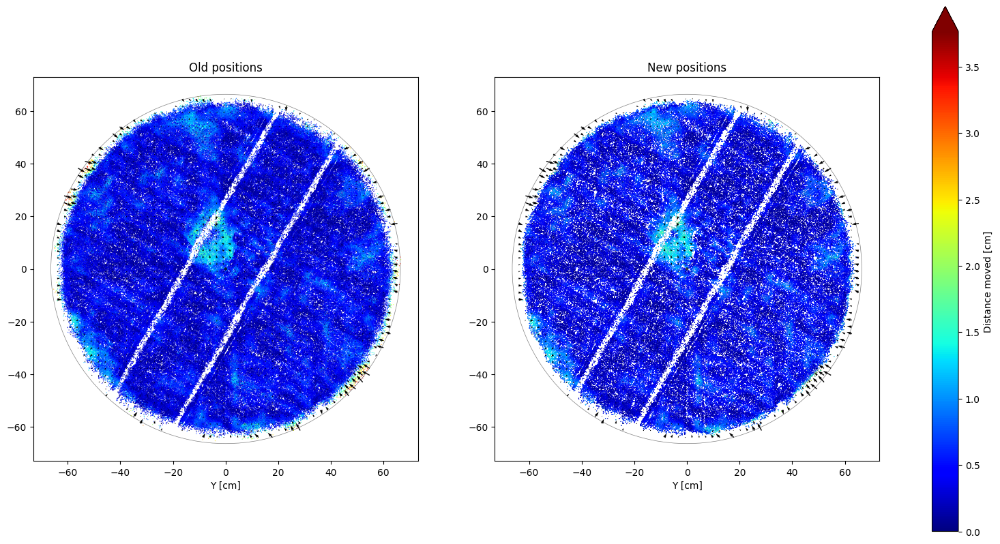

Mean:  2.033983
Median:  2.011321


In [61]:
pos_diff_plot(positions, nn_pos,pmt_pos,dead_pmts=dead_pmts,max_r=tpc_radius, vmax=None, s=0.7, dpi=200, save=None)
loss = keras_loss(patterns, radial_lce.predict(nn_pos, verbose=0)).numpy()
print("Mean: ", loss.mean())
print("Median: ", np.sort(loss)[len(loss) //2])

NameError: name 'nn_pos' is not defined

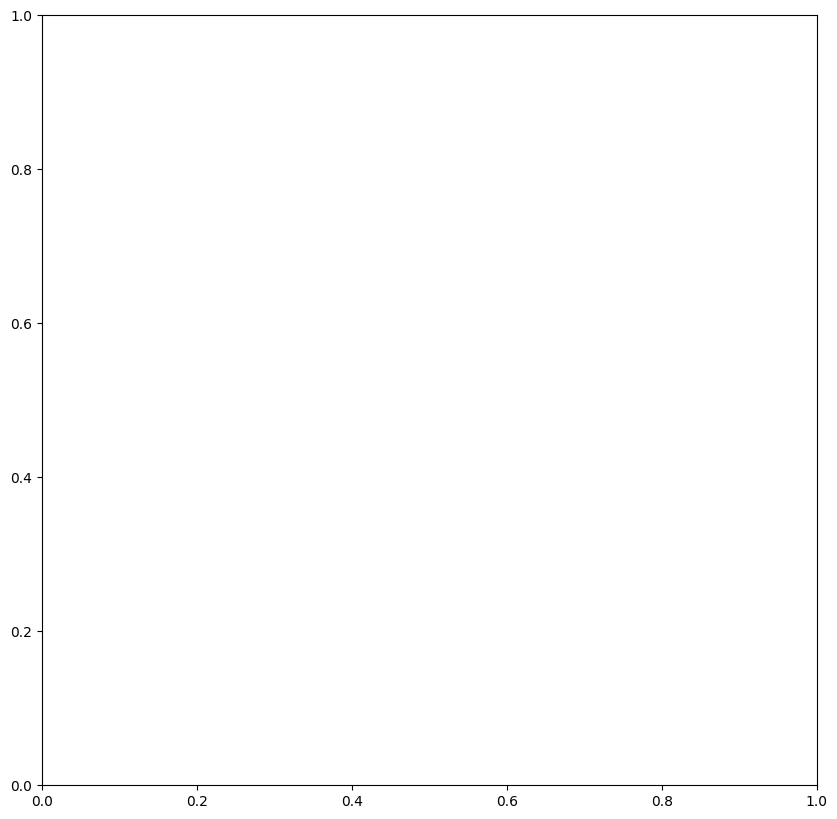

In [297]:
fig, ax = plt.subplots(1,1, figsize=(10,10))
differences = ((nn_pos - positions)**2).numpy().sum(axis=-1)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
ax.hist(differences, bins=bins)
ax.set_title("NN")
ax.set_xscale('log')
ax.set_xlabel("Pos Shift")

CNN_ref - GCN_ref  0.013626211
CNN_ref - MLP_ref  0.013664883


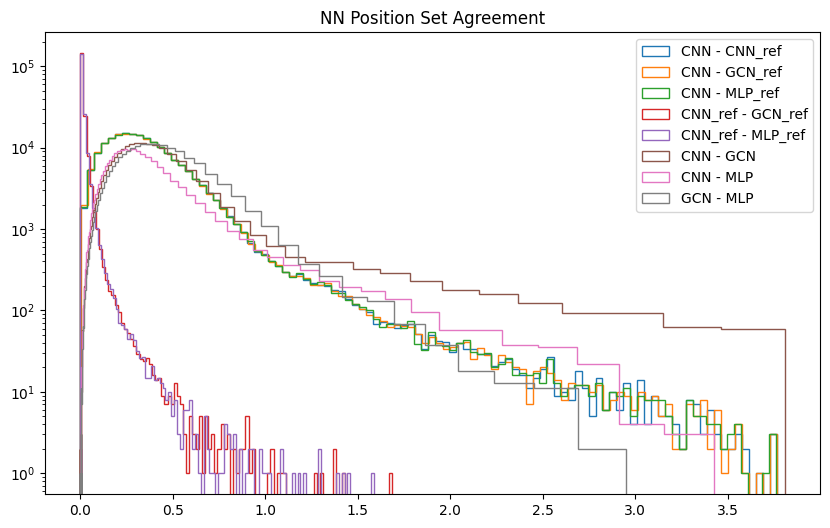

In [93]:
fig = plt.figure(figsize=(10,6))

differences = np.sqrt((ei["s2_x_cnn"] - nn_pos[:n_datapoints, 0])**2 + 
                       (ei["s2_y_cnn"] - nn_pos[:n_datapoints, 1])**2)
plt.hist(differences, label='CNN - CNN_ref', bins=100, histtype='step')
differences = np.sqrt((ei["s2_x_cnn"] - nn_pos[n_datapoints:2*n_datapoints, 0])**2 + 
                       (ei["s2_y_cnn"] - nn_pos[n_datapoints:2*n_datapoints, 1])**2)
plt.hist(differences, label='CNN - GCN_ref', bins=100, histtype='step')
differences = np.sqrt((ei["s2_x_cnn"] - nn_pos[2*n_datapoints:, 0])**2 + 
                       (ei["s2_y_cnn"] - nn_pos[2*n_datapoints:, 1])**2)
plt.hist(differences, label='CNN - MLP_ref', bins=100, histtype='step')

differences = np.sqrt((nn_pos[:n_datapoints, 0]- nn_pos[n_datapoints:2*n_datapoints, 0])**2 + 
                       (nn_pos[:n_datapoints, 1] - nn_pos[n_datapoints:2*n_datapoints, 1])**2)
plt.hist(differences, label='CNN_ref - GCN_ref', bins=100, histtype='step')
print('CNN_ref - GCN_ref ', differences.mean())
differences = np.sqrt((nn_pos[:n_datapoints, 0] - nn_pos[2*n_datapoints:, 0])**2 + 
                       (nn_pos[:n_datapoints, 1] - nn_pos[2*n_datapoints:, 1])**2)
plt.hist(differences, label='CNN_ref - MLP_ref', bins=100, histtype='step')
print('CNN_ref - MLP_ref ', differences.mean())

differences = np.sqrt((ei["s2_x_cnn"] - ei["s2_x_gcn"])**2 + 
                       (ei["s2_y_cnn"] - ei["s2_y_gcn"])**2)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
plt.hist(differences, bins=bins, label='CNN - GCN', histtype='step')

differences = np.sqrt((ei["s2_x_cnn"] - ei["s2_x_mlp"])**2 + 
                       (ei["s2_y_cnn"] - ei["s2_y_mlp"])**2)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
plt.hist(differences, bins=bins, label='CNN - MLP',histtype='step')

differences = np.sqrt((ei["s2_x_gcn"] - ei["s2_x_mlp"])**2 + 
                       (ei["s2_y_gcn"] - ei["s2_y_mlp"])**2)
min_diff = differences[differences > 0].min()  # Ensure no zero values in the bins
max_diff = differences.max()
bins = np.logspace(np.log10(min_diff), np.log10(max_diff), num=100)
plt.hist(differences, bins=bins, label='GCN - MLP', histtype='step')

plt.title("NN Position Set Agreement")
plt.yscale('log')
plt.legend()
plt.show()

## Finishing Trials

Reduced ChiSquared value including the Gaussian Fuck this

In [42]:
def modifiable_loss_generator(not_dead_pmts, broadening = None, const=None):
    # To improve readability
    from tensorflow.math import log as ln #log is natural log
    from tensorflow.math import lgamma
    from tensorflow.math import pow as power

    if broadening is None: broadening = 1.2
    if const is None: const = 0.2

    import math as m
    pi = tensorflow.constant(m.pi)

    not_dead_pmts_tf = tensorflow.constant(not_dead_pmts, dtype=tensorflow.int32)
    n_dof = len(not_dead_pmts)
    @tensorflow.function
    def loss_function(true, predicted, sigma, fit_power):
        """
        I wanted to keep the loss function seperate from the actual model
        prediction contains (predt, loss params)
        """
        prediction = predicted
        # Gather valid
        ao = tensorflow.gather(true, not_dead_pmts_tf, axis=1)
        ae = tensorflow.gather(prediction, not_dead_pmts_tf, axis=1)
        # Scale
        ae = tensorflow.reshape(keras.backend.sum(ae, axis=1), (-1, 1)) * ae


        denominator = broadening * ae + power(0.1 * sigma * power(ae, fit_power) , 2) + const
        # Dont multiply by 2 just yet
        chi = - (
            (  ao * ln(ae) - ln( lgamma(ao + 1) )  )
          - (  ae * ln(ae) -     lgamma(ae + 1) )
              ) * ae / (
                denominator
              )
        
        y = chi - 0.5 * ln( 2*pi * ( denominator ) )
        chi = 2*chi
        return tensorflow.reduce_sum(y, axis=1) / n_dof #tensorflow.reduce_sum(chi, axis=1) / n_dof
    
    return loss_function


class Likelihood_params(keras.layers.Layer):
    def __init__(self, n_pmts):
        self.n_pmts = n_pmts
        super().__init__()
    def build(self, input_shape):
        self.sigma = self.add_weight(
            shape=(self.n_pmts, ), dtype=tensorflow.float32, name='sigma',
            initializer=keras.initializers.Ones(),
            trainable=True)
        self.power = self.add_weight(
            shape=(self.n_pmts, ), dtype=tensorflow.float32, name='power',
            initializer=keras.initializers.Ones(),
            trainable=True)
        super().build(input_shape)

    def call(self, inputs):
        return inputs
    

def get_neural_LCE(n_pmts, pmt_pos, I0_init, activation ='relu', final_activation='sigmoid'):
    input = keras.layers.Input(shape=(2))
    # Model to generate relevant coordinates
    m = get_full_LCE_coordinate_model(n_pmts, pmt_pos, n_pmt_pos = 6)(input)
    m = keras.layers.Conv1D(filters=60, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=30, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=15, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=15, kernel_size=1, activation=activation)(m)
    m = keras.layers.Conv1D(filters=1, kernel_size=1, activation=final_activation)(m)
    m = keras.layers.Flatten()(m)
    # Add I0 and normalization layers
    m = I0Layer(n_pmts, init_val=I0_init, name='QE_Layer')(m)
    m = NormalizationLayer()(m)
    # Get Loss func parameters
    m, sigma, power = Likelihood_params(n_pmts)(m)
    return keras.Model(inputs=input, outputs=m, name='neural_lce_modifiable_loss')

In [281]:
from tensorflow.math import log as ln #log is natural log
from tensorflow.math import lgamma
from tensorflow.math import pow as power
"""
We need to modify how the loss function is called
"""
class NeuralLCEModel(keras.Model):
    def __init__(self, n_pmts, pmt_pos, I0_init, not_dead_pmts,activation='relu', final_activation='sigmoid',broadening=None, const=None, **kwargs):
        super(NeuralLCEModel, self).__init__(**kwargs)
        self.n_pmts = n_pmts
        self.pmt_pos = pmt_pos
        self.I0_init = I0_init
        self.activation = activation
        self.final_activation = final_activation
        self.loss = modifiable_loss_generator(not_dead_pmts)
        # Define the layers
        self.coordinate_model = get_full_LCE_coordinate_model(n_pmts, pmt_pos, n_pmt_pos=6)
        self.conv1 = keras.layers.Conv1D(filters=60, kernel_size=1, activation=self.activation)
        self.conv2 = keras.layers.Conv1D(filters=30, kernel_size=1, activation=self.activation)
        self.conv3 = keras.layers.Conv1D(filters=15, kernel_size=1, activation=self.activation)
        self.conv4 = keras.layers.Conv1D(filters=15, kernel_size=1, activation=self.activation)
        self.conv5 = keras.layers.Conv1D(filters=1, kernel_size=1, activation=self.final_activation)
        self.flatten = keras.layers.Flatten()
        self.I0_layer = I0Layer(n_pmts, init_val=self.I0_init, name='QE_Layer')
        self.normalization_layer = NormalizationLayer()
        self.likelihood_params = Likelihood_params(n_pmts)

        # Loss specific
        if broadening is None: self.broadening = 1.2
        if const is None: self.const = 0.2
        import math as m
        self.pi = tensorflow.constant(m.pi)
        self.not_dead_pmts_tf = tensorflow.constant(not_dead_pmts, dtype=tensorflow.int32)
        self.n_dof = len(not_dead_pmts)

    def call(self, inputs):
        # Forward pass through the layers
        m = self.coordinate_model(inputs)
        m = self.conv1(m)
        m = self.conv2(m)
        m = self.conv3(m)
        m = self.conv4(m)
        m = self.conv5(m)
        m = self.flatten(m)
        #m = self.I0_layer(m)
        m = self.normalization_layer(m)
        # Get Loss function parameters
        m = self.likelihood_params(m)
        return m

    def custom_loss(self, true, predicted):
        """
        Because passing dynamic things is really annoying we do this
        by giving the loss function access to teh models class we should be able to get the dynamic parameters
        """
        ao = tensorflow.gather(true, self.not_dead_pmts_tf, axis=1) 
        # we add an offset such that no negative values appear
        min_ao = tensorflow.reduce_min(ao, axis=-1, keepdims=True)
        ao = tensorflow.where(ao < 0, ao + tensorflow.abs(min_ao), ao) + 1e-10

        ae = tensorflow.gather(predicted, self.not_dead_pmts_tf, axis=1) + 1e-10
        sigma = tensorflow.gather(self.likelihood_params.sigma ,self.not_dead_pmts_tf, axis=0)
        fit_power = tensorflow.gather(self.likelihood_params.power ,self.not_dead_pmts_tf, axis=0)
        # Scale
        ae = tensorflow.reshape(keras.backend.sum(ao, axis=1), (-1, 1)) * ae
        denominator = self.broadening * ae + power(0.1 * sigma * power(ae, fit_power) , 2) + self.const
        # Dont multiply by 2 just yet
        chi = - (
            (  ao * ln(ae + 1e-10) -     lgamma(ao + 1) )
          - (  ae * ln(ae + 1e-10) -     lgamma(ae + 1) )
              ) * ae / (
                denominator
              )
        
        y = chi - 0.5 * ln( 2*self.pi * ( denominator ) + 1e-10 )
        #tensorflow.print(tensorflow.reduce_any(tensorflow.math.is_nan(  true ) ))
        #chi = 2*chi
        return tensorflow.math.abs(tensorflow.reduce_sum(y, axis=1) / self.n_dof )#tensorflow.reduce_sum(chi, axis=1) / n_dof

In [294]:
adv_nn = NeuralLCEModel(n_pmts, pmt_pos_top[:,-2:], I0_init_from_ULCE, not_dead_pmts, activation='relu', final_activation='sigmoid',broadening=None, const=None)
x_train, y_train, val = split_data(positions, patterns, train_slice, val_slice)

early_stopping = tensorflow.keras.callbacks.EarlyStopping(
    monitor='val_loss',    # or 'val_accuracy' if you are monitoring accuracy
    patience=5,            # Wait for 2 epochs with no improvement
    restore_best_weights=True,
    min_delta=0.03,        # Minimum change of abs value (4 loss is a common starting point)
    mode='min',            # 'min' because we want to minimize the loss
    verbose=1              # Print messages when stopping
)
reduce_lr = tensorflow.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',     # Metric to monitor (e.g., validation loss)
    mode = 'min',
    restore_best_weights=True,
    factor=0.5,             # Factor by which the learning rate will be reduced (new_lr = lr * factor)
    patience=2,             # Number of epochs with no improvement after which learning rate will be reduced
    min_delta=0.05,         # Minimum change to qualify as an improvement (1% in this case)
    min_lr=1e-8,            # Lower bound on the learning rate
    verbose=1               # Print messages when the learning rate is reduced
)

adv_nn.compile(loss= adv_nn.custom_loss, optimizer = keras.optimizers.Adam(learning_rate=1e-2))

adv_nn.predict(x = x_train[0:10])


adv_nn.fit(x = x_train, y = y_train, 
            validation_data=val,
            epochs = 100, batch_size = 2**8, 
            callbacks=[early_stopping, reduce_lr])

1/1 [==============================] - 0s 94ms/step
Epoch 1/100
291/577 [==============>...............] - ETA: 2s - loss: 0.1541

KeyboardInterrupt: 

In [ ]:
nn_adv_pos=train_and_update_pos(positions, patterns, adv_nn, n_iter = 4, verbose=1, hist_pos=False, lr=1)


17303/17303 [==============================] - 32s 2ms/step
Jagged iter 0
Epoch 1/50
136/136 [==============================] - 19s 141ms/step - loss: 35.7511 - lr: 1.0000
Epoch 2/50
136/136 [==============================] - 19s 141ms/step - loss: 39.5663 - lr: 1.0000
Epoch 3/50
135/136 [============================>.] - ETA: 0s - loss: 39.9737
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.5.
136/136 [==============================] - 19s 138ms/step - loss: 39.9738 - lr: 1.0000
Epoch 4/50
136/136 [==============================] - 19s 138ms/step - loss: 38.5111 - lr: 0.5000
Epoch 5/50
136/136 [==============================] - 19s 141ms/step - loss: 35.1653 - lr: 0.5000
Epoch 6/50
136/136 [==============================] - 19s 141ms/step - loss: 34.9964 - lr: 0.5000
Epoch 7/50
 40/136 [=======>......................] - ETA: 13s - loss: 35.1242

KeyboardInterrupt: 

1/1 [==============================] - 0s 12ms/step


<Axes: xlabel='X position (cm)', ylabel='Y position (cm)'>

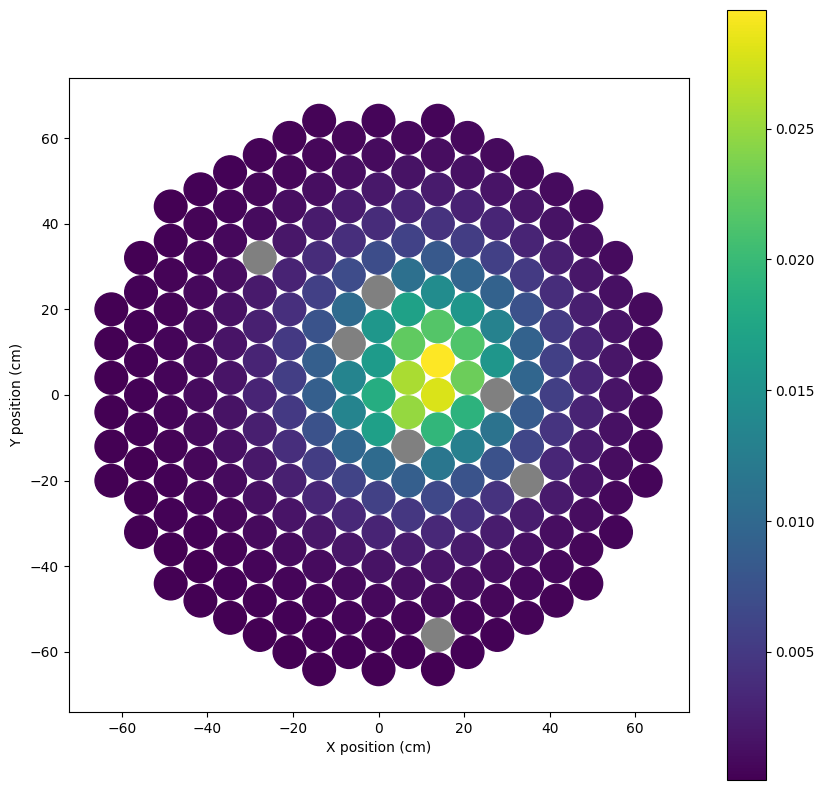

In [295]:
plot_pmt_response(pmt_pos_top,adv_nn.predict(x_train[0:1])[0],dead_pmts=dead_pmts)

1/1 [==============================] - 0s 82ms/step


<Axes: xlabel='X position (cm)', ylabel='Y position (cm)'>

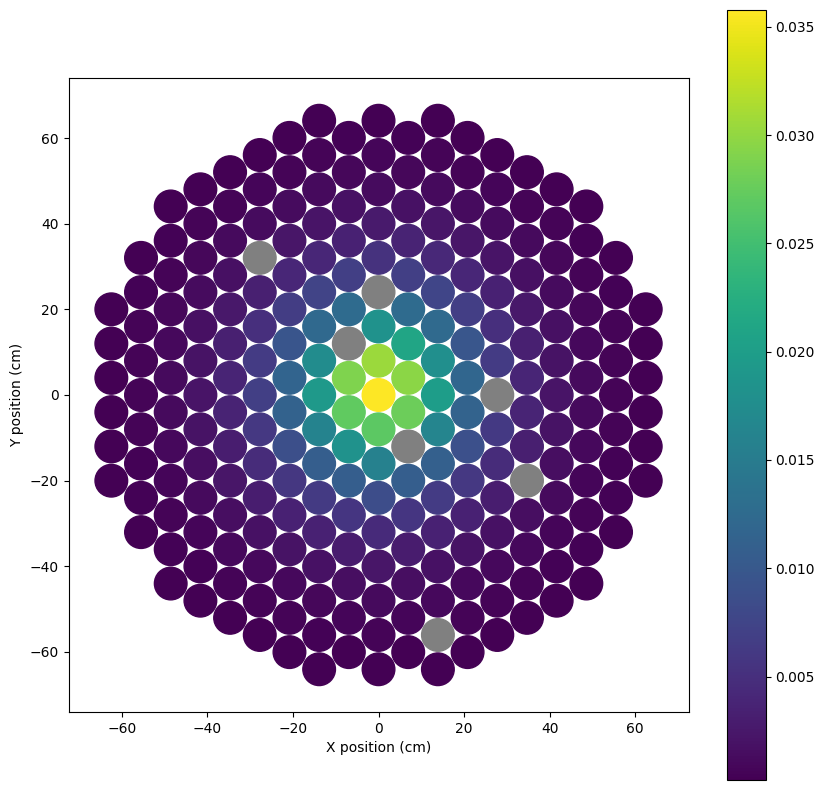

In [296]:
plot_pmt_response(pmt_pos_top,adv_nn.predict(y_train[0:1])[0],dead_pmts=dead_pmts)
